In [2]:
from tensorflow.keras.utils import to_categorical
from sklearn.datasets import fetch_openml
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
import numpy as np
%matplotlib inline
seed = 0
np.random.seed(seed)
import tensorflow as tf
tf.random.set_seed(seed)
import os


import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l1

from qkeras.qlayers import QDense, QActivation
from qkeras.quantizers import quantized_bits, quantized_relu
import tensorflow.compat.v1 as tf1
from qkeras.utils import model_save_quantized_weights

from tensorflow_model_optimization.python.core.sparsity.keras import prune, pruning_callbacks, pruning_schedule
from tensorflow_model_optimization.sparsity.keras import strip_pruning


from sklearn.preprocessing import OneHotEncoder,LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import random
import math


from tensorflow_model_optimization.python.core.sparsity.keras import prune, pruning_callbacks, pruning_schedule
from tensorflow_model_optimization.sparsity.keras import strip_pruning
from qkeras.utils import model_save_quantized_weights, load_qmodel
import hls4ml
import qkeras.utils

from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score

os.environ["CUDA_VISIBLE_DEVICES"] = "-1"


/home/dmitsas/anaconda3/envs/hls4ml-tutorial/lib/python3.10/site-packages/hls4ml/converters/__init__.py:27: UserWarning: WARNING: Pytorch converter is not enabled!
  warnings.warn("WARNING: Pytorch converter is not enabled!", stacklevel=1)


# Gather all pretrained weights into an array to create a pool of weights and select from when testing the estimator

In [7]:
import regression_model_ff as reg_ff
from importlib import reload
reload(reg_ff)

<module 'regression_model_ff' from '/home/dmitsas/Downloads/dse/testing/estimator_testing/regression_model_ff.py'>

In [93]:
dirname_jet = "../../../notebooks/jet_tagging/models/models_1/prec_8/model_"
loaded_models_jet = reg_ff.regression.load('jet_tagging',dirname_jet)
dirname_arr = "../../../notebooks/Arrythmia/models/models_1/prec_8/model_"
loaded_models_arr = reg_ff.regression.load("Arrythmia",dirname_arr)
dirname_car = "../../../notebooks/Cardio/models/models_0//prec_8/model_"
loaded_models_car = reg_ff.regression.load("Cardio",dirname_car)
dirname_bc = "../../../notebooks/Breast_cancer/models/models_0/prec_8/model_"
loaded_models_bc = reg_ff.regression.load("breast_cancer",dirname_bc)

... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


... quantizing model


In [94]:
%%time
gathered_jet = []
bias_jet = []
model_num = 20
for i in range(model_num):
    for layer in range(0,len(loaded_models_jet[i].layers),2):
        for weights in loaded_models_jet[i].weights[layer]:
            for w in weights:
                gathered_jet.append(w.numpy())
                
for i in range(model_num):
    for layer in range(1,len(loaded_models_jet[i].layers),2):
        for weights in loaded_models_jet[i].weights[layer]:
                bias_jet.append(weights.numpy())
bias_jet = np.array(bias_jet)
gathered_jet = np.array(gathered_jet)

gathered_jet.shape

CPU times: user 17.3 s, sys: 15.2 ms, total: 17.3 s
Wall time: 17.3 s


(133461,)

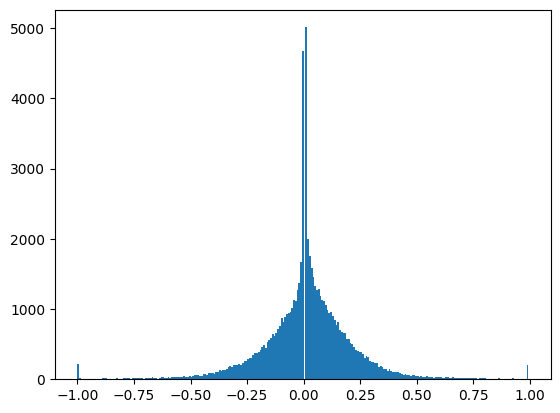

In [95]:
new_jet = gathered_jet[gathered_jet != 0]        

n_jet,bins_jet,patches_jet = plt.hist(x = new_jet,bins=255)

In [96]:
new_bins = bins_jet[bins_jet!=0]
new_n = n_jet
sorted_weights = []
index_weights = []
while len(new_n) > 0:
    sorted_weights.append(new_bins[new_n==new_n.max()])
    index_weights.append(new_n[new_n == new_n.max()])
    new_bins = new_bins[new_n != new_n.max()]
    new_n = new_n[new_n != new_n.max()]
    

sorted_weights                               ###### weights appear in order from most to least frequent

[array([0.015625]),
 array([-0.0078125]),
 array([0.0234375]),
 array([0.03125]),
 array([-0.015625]),
 array([0.0390625]),
 array([0.046875]),
 array([-0.0234375]),
 array([0.0546875]),
 array([0.0703125]),
 array([0.0625]),
 array([-0.03125]),
 array([0.078125]),
 array([0.0859375]),
 array([-0.046875]),
 array([-0.0390625]),
 array([0.09375]),
 array([0.1015625]),
 array([-0.0546875]),
 array([0.109375]),
 array([0.125]),
 array([-0.0625]),
 array([0.1171875]),
 array([-0.0703125]),
 array([-0.078125]),
 array([0.1328125]),
 array([-0.0859375]),
 array([-0.1015625]),
 array([0.140625]),
 array([-0.09375,  0.15625]),
 array([0.1484375]),
 array([-0.109375]),
 array([-0.1171875]),
 array([0.1640625]),
 array([0.171875]),
 array([-0.125]),
 array([0.1796875]),
 array([0.1875]),
 array([-0.140625]),
 array([-0.1328125]),
 array([-0.1484375]),
 array([0.203125]),
 array([0.1953125]),
 array([-0.15625]),
 array([-0.1640625]),
 array([0.2109375]),
 array([0.21875]),
 array([-0.1796875]),
 


#### The same for arrythmia and the other models

In [97]:
%%time
gathered_arr = []
bias_arr = []
model_num = 20
for i in range(model_num):
    for layer in range(0,len(loaded_models_arr[i].layers),2):
        for weights in loaded_models_arr[i].weights[layer]:
            for w in weights:
                gathered_arr.append(w.numpy())
                
for i in range(model_num):
    for layer in range(1,len(loaded_models_arr[i].layers),2):
        for weights in loaded_models_arr[i].weights[layer]:
                bias_arr.append(weights.numpy())
bias_arr = np.array(bias_arr)
gathered_arr = np.array(gathered_arr)

gathered_arr.shape

CPU times: user 8.25 s, sys: 3.7 ms, total: 8.26 s
Wall time: 8.25 s


(60900,)

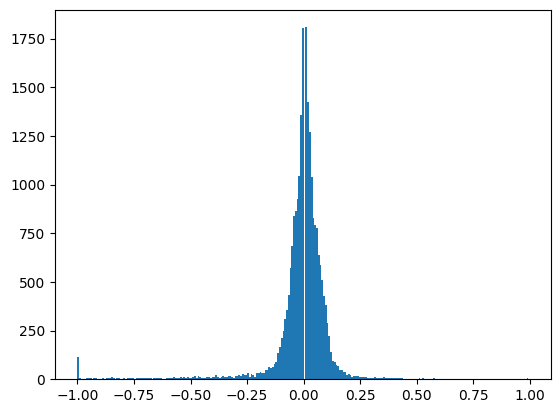

In [98]:
new_arr = gathered_arr[gathered_arr != 0]        

n_arr,bins_arr,patches_arr = plt.hist(x = new_arr,bins=255)

#### Cardio

In [99]:
%%time
gathered_car = []
bias_car = []
model_num = 20
for i in range(model_num):
    for layer in range(0,len(loaded_models_car[i].layers),2):
        for weights in loaded_models_car[i].weights[layer]:
            for w in weights:
                gathered_car.append(w.numpy())
                
for i in range(model_num):
    for layer in range(1,len(loaded_models_car[i].layers),2):
        for weights in loaded_models_car[i].weights[layer]:
                bias_car.append(weights.numpy())
bias_car = np.array(bias_car)
gathered_car = np.array(gathered_car)

gathered_car.shape

CPU times: user 888 ms, sys: 3.98 ms, total: 892 ms
Wall time: 890 ms


(6000,)

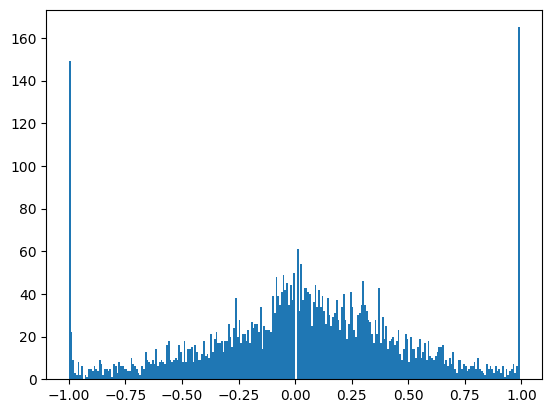

In [100]:
new_car = gathered_car[gathered_car != 0]        

n_car,bins_car,patches_car = plt.hist(x = new_car,bins=255)

#### Breast_cancer

In [101]:
%%time
gathered_bc = []
bias_bc = []
model_num = 20
for i in range(model_num):
    for layer in range(0,len(loaded_models_bc[i].layers),2):
        for weights in loaded_models_bc[i].weights[layer]:
            for w in weights:
                gathered_bc.append(w.numpy())
                
for i in range(model_num):
    for layer in range(1,len(loaded_models_bc[i].layers),2):
        for weights in loaded_models_bc[i].weights[layer]:
                bias_bc.append(weights.numpy())
bias_bc = np.array(bias_bc)
gathered_bc = np.array(gathered_bc)

gathered_bc.shape

CPU times: user 949 ms, sys: 0 ns, total: 949 ms
Wall time: 947 ms


(5962,)

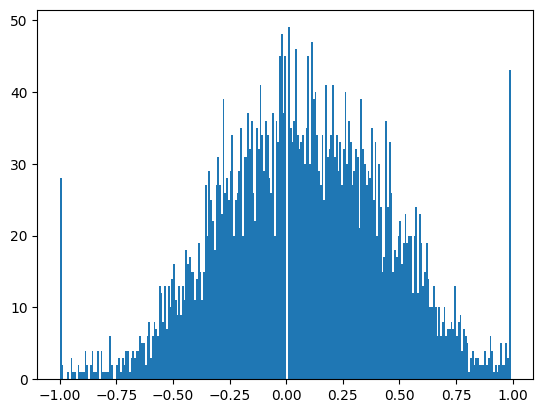

In [102]:
new_bc = gathered_bc[gathered_bc != 0]        

n_bc,bins_bc,patches_bc = plt.hist(x = new_bc,bins=255)

#### Gather all into one

In [103]:
gathered = np.concatenate((gathered_jet,gathered_arr,gathered_car,gathered_bc))
print(gathered.shape)
bias = np.concatenate((bias_jet,bias_arr,bias_car,bias_bc))
bias.shape

(206323,)


(4593,)

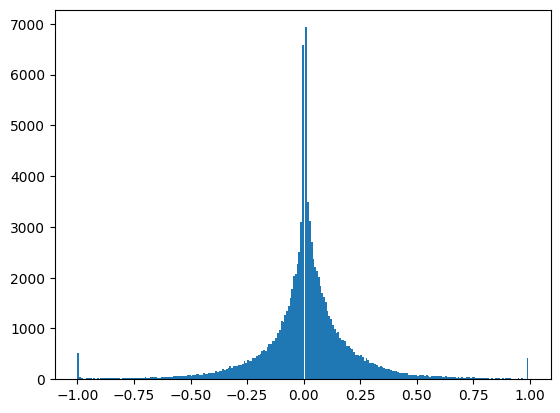

In [104]:
new = gathered[gathered != 0]        

n,bins,patches = plt.hist(x = new,bins=255)

In [105]:
new.shape

(104438,)

Write weights and biases to txt file

In [229]:
np.savetxt("weight_pool.txt",new)
np.savetxt("bias.txt",bias)

Load weights and biases from txt file

In [2393]:
new = []
with open("weight_pool.txt", 'r') as f:
    for lines in f:
        lines = float(lines)
        new.append(lines)
new = np.array(new)
bias = []
with open("bias.txt", 'r') as f:
    for lines in f:
        lines = float(lines)
        bias.append(lines)
bias = np.array(bias)

### Function that creates models with weights taken from the pool of pretrained weights

In [106]:
from testing_utils import generate_sparse

# Retrain models with random weights from the weight pool. Use results to improve the linear regression model if needed

Train 50 models multi-layered models with mixed implementation, from precision=8 to precision=2 and for reuse factors from 1 to 4

In [107]:
import estimator as est
import utils

In [19]:
from tensorflow.keras.models import load_model
from qkeras.utils import _add_supported_quantized_objects
import qkeras.qtools.qtools_util
import qkeras.estimate
loaded_models = []
id_num = 8
layer_num = 50
reuse = 1
filename = "./retraining_full/test_" + str(id_num) + "/reuse_" + str(reuse) + "/model_"
for model_no in range(layer_num):
    co = {}
    _add_supported_quantized_objects(co)
    loaded_models.append(load_model(filename + str(model_no) + '/KERAS_check_best_mode.h5', custom_objects=co))
#model = 


In [20]:
precision = np.zeros(layer_num).astype('int') + 8
id_num = precision[0]
RF = np.ones(layer_num)
#filename = "./alt_results/results/test_" + str(id_num) + "/model_"
reuse = int(RF[0])
filename = "./retraining_full/test_" + str(id_num) + "/reuse_" + str(reuse) + "/model_"
filename

'./retraining_full/test_8/reuse_1/model_'

In [114]:
layer_num = 50
models = []
RF = []
precision = []
sparsity = []
bits = 8
int_bits = 0
model_layers = [[] for x in range(layer_num)]
for i in range(0,layer_num,1):  
    model = Sequential()
    layer_in = random.randint(4,16)
    layer_2 = random.randint(4,60)                           ###64
    layer_3 = random.randint(4,64)                           ###32
    layer_out = random.randint(5,32)
    model_layers[i].append(layer_in)
    model_layers[i].append(layer_2)
    model_layers[i].append(layer_3)
    model_layers[i].append(layer_out)
    model = Sequential()
    model.add(QDense(layer_2, input_shape=(layer_in,), name='fc1', kernel_quantizer=quantized_bits(bits,int_bits,alpha=1,use_stochastic_rounding=True),bias_quantizer=quantized_bits(bits,int_bits,alpha=1),
                    kernel_initializer=initialiser, kernel_regularizer=l1(0.0001)   ))
    model.add(QActivation(activation=quantized_relu(bits,int_bits,use_stochastic_rounding=False), name='relu1'))
    model.add(QDense(layer_3, name='fc2',
                    kernel_quantizer=quantized_bits(bits,int_bits,alpha=1,use_stochastic_rounding=True), bias_quantizer=quantized_bits(bits,int_bits,alpha=1),
                    kernel_initializer=initialiser, kernel_regularizer=l1(0.0001 ) ))
    model.add(QActivation(activation=quantized_relu(bits,int_bits,use_stochastic_rounding=False), name='relu2'))
    model.add(QDense(layer_out, name='fc3',
                     kernel_quantizer=quantized_bits(bits,int_bits,alpha=1,use_stochastic_rounding=True), bias_quantizer=quantized_bits(bits,int_bits,alpha=1),
                     kernel_initializer=initialiser, kernel_regularizer=l1(0.0001 ) ))
#     model.add(QActivation(activation=quantized_relu(bits,int_bits,use_stochastic_rounding=False), name='relu3'))
#     model.add(QDense(layer_5, name='output',
#                     kernel_quantizer=quantized_bits(bits,int_bits,alpha=1,use_stochastic_rounding=True), bias_quantizer=quantized_bits(bits,int_bits,alpha=1),
#                     kernel_initializer=initialiser, kernel_regularizer=l1(0.0001 ) ))
    model.add(Activation(activation='softmax', name='softmax'))
    sparsity.append(np.random.uniform(0.2,0.9))
    for layer in range(0,len(model.layers),2):
        generate_sparse(model,layer,model.weights[layer].shape[0],model.weights[layer].shape[1],sparsity[i])
    models.append(model)
    model_layers[i].append(layer_in)
    model_layers[i].append(layer_out)
    RF.append(1)
    
    if not (os.path.exists(filename + str(i))):
        os.makedirs(filename + str(i))
    with open(filename + str(i) + "/layers.txt",'w') as f:
        f.write(str(model_layers[i][0]) + " " + str(model_layers[i][1]))
        f.close
    



... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizing model
... quantizin

In [ ]:
%%time
selector = []
for j in range(8,1,-1):
    precision = (np.zeros(layer_num).astype(int) + j)
    id_num = precision[0]
    x = 0
    for reuse in range(x,5,1):
        RF = np.zeros(layer_num) + reuse
        filename = "./retraining_full/test_" + str(id_num) + "/reuse_" + str(reuse) + "/model_"
        selector = []
        for i in range(0,layer_num,1):
            config = hls4ml.utils.config_from_keras_model(models[i],granularity='name')
            config['LayerName']['fc1_input']['Precision']['result'] = 'fixed<' + str(precision[i]) + ',2>'
            config['LayerName']['relu1']['Precision']['result'] = 'ap_ufixed<' + str(precision[i]) + ',0,AP_RND_CONV,AP_SAT>'
            config['LayerName']['relu2']['Precision']['result'] = 'ap_ufixed<' + str(precision[i]) + ',0,AP_RND_CONV,AP_SAT>'
            #config['LayerName']['relu3']['Precision']['result'] = 'ap_ufixed<' + str(precision[i]) + ',0,AP_RND_CONV,AP_SAT>'
            
            selector.append(1)
            #selector.append(random.randint(0,1))
                #config['LayerName']['output']['Precision']['result'] = 'fixed<16,4>'
            config['LayerName']['softmax']['exp_table_t'] = 'ap_fixed<18,8>'
            config['LayerName']['softmax']['inv_table_t'] = 'ap_fixed<18,4>'
            config['Model']['ReuseFactor'] = reuse
            models[i].save(filename + str(i) + "/KERAS_check_best_mode.h5")
            hls_model = hls4ml.converters.convert_from_keras_model(
                models[i],hls_config = config,output_dir = filename + str(i) + '/hls4ml_prj',part = 'xc7z007s-clg225-2')
            hls_model.compile()
            os.system('cp -r project_orig.tcl build_prj_orig.tcl init.sh build_prj_orig_lut.tcl init_lut.sh ' + filename + str(i) + '/hls4ml_prj')
            os.chdir(filename + str(i) + '/hls4ml_prj')
            if selector[i] == 0:
                os.system('bash init_lut.sh')
                os.system('rm init.sh')
            elif selector[i] == 1:
                os.system('bash init.sh')
                os.system('rm init_lut.sh')
            os.chdir('/home/dmitsas/Downloads/notebooks/misc/')
        for z in range(layer_num):
            os.system("rm -r " + filename + str(z) + "/hls4ml_prj/myproject_prj/solution1/.autopilot")

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 16:57:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_0/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_0/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.36 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.48 seconds; current allocated memory: 622.996 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.069 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HL

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.5 seconds; current allocated memory: 1.124 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.99 seconds. CPU system time: 0.08 seconds. Elapsed time: 12.07 seconds; current allocated memory: 1.355 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.18 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.375 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 135.33 seconds. CPU system time: 3.41 seconds. Elapsed time: 138.13 seconds; current allocated memory: -87.8

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 16:59:42 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_1/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_1/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.34 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.45 seconds; current allocated memory: 623.094 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.14 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.15 seconds; current allocated memory: 1.046 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.046 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.62 seconds. CPU system time: 0 seconds. Elapsed time: 1.62 seconds; current allocated memory: 1.075 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.08 seconds. CPU system time: 0.07 seconds. Elapsed time: 8.16 seconds; current allocated memory: 1.230 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.83 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.87 seconds; current allocated memory: 1.244 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 116.31 seconds. CPU system time: 3.43 seconds. Elapsed time: 119.11 seconds; current allocated memory: -222.6

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 17]
Layer name: relu1, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc2, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:01:59 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_2/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_2/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.91 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.05 seconds; current allocated memory: 593.992 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [327]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.6 seconds. CPU syste

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.75 seconds. CPU system time: 0 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.020 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.81 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.84 seconds; current allocated memory: 1.084 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.63 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.64 seconds; current allocated memory: 1.090 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 63.35 seconds. CPU system time: 2.97 seconds. Elapsed time: 65.77 seconds; current allocated memory: -379.531

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 52]
Layer name: relu1, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc2, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:03:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_3/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_3/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.14 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.24 seconds; current allocated memory: 608.434 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_806') [4393]  (3.19 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.88 seconds.

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.47 seconds. CPU system time: 0 seconds. Elapsed time: 2.47 seconds; current allocated memory: 1.134 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.24 seconds. CPU system time: 0.02 seconds. Elapsed time: 12.27 seconds; current allocated memory: 1.372 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.19 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.21 seconds; current allocated memory: 1.392 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 137.44 seconds. CPU system time: 3.12 seconds. Elapsed time: 139.94 seconds; current allocated memory: -70.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:06:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_4/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_4/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.74 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.82 seconds; current allocated memory: 592.258 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.52 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.53 seconds; current allocated memory: 1.036 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 9 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 8 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.24 seconds. CPU system time: 0.05 seconds. Elapsed time: 6.3 seconds; current allocated memory: 1.153 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.73 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.165 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 69.45 seconds. CPU system time: 2.8 seconds. Elapsed time: 71.5 seconds; current allocated memory: -303.105 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:07:33 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_5/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_5/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.64 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.73 seconds; current allocated memory: 587.102 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.84 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.85 seconds; current allocated memory: 1.013 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 2 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.6 seconds. CPU system time: 0.02 seconds. Elapsed time: 3.62 seconds; current allocated memory: 1.079 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.61 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.087 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 44.75 seconds. CPU system time: 2.78 seconds. Elapsed time: 46.83 seconds; current allocated memory: -382.469 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:08:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_6/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_6/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.15 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.22 seconds; current allocated memory: 622.480 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.59 seconds. CPU system time: 0 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.058 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.96 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.97 seconds; current allocated memory: 1.095 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.53 seconds. CPU system time: 0.08 seconds. Elapsed time: 9.61 seconds; current allocated memory: 1.296 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.02 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.05 seconds; current allocated memory: 1.313 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 130.87 seconds. CPU system time: 3.47 seconds. Elapsed time: 133.72 seconds; current allocated memory: -151.9

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:11:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_7/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_7/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.98 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.05 seconds; current allocated memory: 591.293 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [908]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.94 seconds. CPU syst

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.33 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.35 seconds; current allocated memory: 1.059 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 5 instance(s).
INFO: [R

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.07 seconds. CPU system time: 0.1 seconds. Elapsed time: 7.17 seconds; current allocated memory: 1.193 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.81 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.83 seconds; current allocated memory: 1.206 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 72.11 seconds. CPU system time: 3.24 seconds. Elapsed time: 74.66 seconds; current allocated memory: -260.977 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:12:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_8/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_8/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.85 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.93 seconds; current allocated memory: 598.555 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.016 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_30') [471]  (3.1 ns)

Resoluti

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.77 seconds. CPU system time: 0 seconds. Elapsed time: 0.77 seconds; current allocated memory: 1.027 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.75 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.77 seconds; current allocated memory: 1.097 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.58 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.104 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 74.29 seconds. CPU system time: 2.61 seconds. Elapsed time: 76.15 seconds; current allocated memory: -365.266 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:14:20 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_9/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_9/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.42 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.56 seconds; current allocated memory: 622.781 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [2090]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.67 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.05 seconds. CPU system time: 0 seconds. Elapsed time: 2.05 seconds; current allocated memory: 1.105 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.87 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.309 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.23 seconds. CPU system time: 0.03 seconds. Elapsed time: 10.27 seconds; current allocated memory: 1.319 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.03 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.05 seconds; current allocated memory: 1.337 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:16:50 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_10/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_10/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.78 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.86 seconds; current allocated memory: 590.684 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.49 seconds. CPU system time: 0 seconds. Elapsed time: 0.48 secon

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.77 seconds. CPU system time: 0 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.022 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 2 instance(s).
INFO: [RTG

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.2 seconds. CPU system time: 0.04 seconds. Elapsed time: 4.27 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.62 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.100 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 54.89 seconds. CPU system time: 3.07 seconds. Elapsed time: 57.22 seconds; current allocated memory: -368.949 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m57s *****
INFO: [HLS 200-112] Total CPU user time: 57.99 seconds. Total CPU system time: 3.98 seconds. Total

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:18:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_11/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_11/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.89 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.01 seconds; current allocated memory: 598.629 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.59 seconds. CPU system time: 0 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.038 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_151') [1415]  (3.16 ns)

Resol

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.3 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.3 seconds; current allocated memory: 1.057 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.42 seconds. CPU system time: 0.03 seconds. Elapsed time: 6.45 seconds; current allocated memory: 1.182 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.79 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.194 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 83.58 seconds. CPU system time: 3.06 seconds. Elapsed time: 85.99 seconds; current allocated memory: -273.715 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 31]
Layer name: relu1, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc2, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:19:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_12/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_12/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.76 seconds. CPU system time: 0.12 seconds. Elapsed time: 0.87 seconds; current allocated memory: 590.840 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_180') [1402]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.69 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.7 seconds; current allocated memory: 1.044 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 9

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.34 seconds. CPU system time: 0.05 seconds. Elapsed time: 6.39 seconds; current allocated memory: 1.170 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.8 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.183 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 69.64 seconds. CPU system time: 3.12 seconds. Elapsed time: 72 seconds; current allocated memory: -284.246 MB.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 61]
Layer name: relu2, layer type: Activation, input shapes: [[None, 61]], output shape: [None, 61]
Layer name: fc3, layer type: QDense, input shapes: [[None, 61]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:21:23 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_13/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_13/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.4 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.52 seconds; current allocated memory: 621.285 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1717]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.85 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.54 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.54 seconds; current allocated memory: 1.067 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.88 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.209 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.33 seconds. CPU system time: 0.04 seconds. Elapsed time: 7.37 seconds; current allocated memory: 1.215 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.81 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.228 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:23:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_14/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_14/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.61 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.71 seconds; current allocated memory: 625.727 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.61 seconds; current allocated memory: 1.088 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.51 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.51 seconds; current allocated memory: 1.088 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.85 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.86 seconds; current allocated memory: 1.146 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.92 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.380 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.05 seconds. CPU system time: 0.1 seconds. Elapsed time: 13.15 seconds; current allocated memory: 1.396 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.31 seconds. CPU system time: 0.05 seconds. Elapsed time: 1.35 seconds; current allocated memory: 1.417 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:26:56 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_15/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_15/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.63 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.72 seconds; current allocated memory: 584.582 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.11 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.11 seconds; current allocated memory: 1020.852 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config7>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.29 seconds. CPU system time: 0 seconds. Elapsed time: 0.3 seconds; current al

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8ns_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8ns_7s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.39 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.008 GB.
INFO: [HLS 200

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:27:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_16/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_16/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.63 seconds. CPU system time: 0.11 seconds. Elapsed time: 0.76 seconds; current allocated memory: 587.934 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_30') [498]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.06 seconds. CPU system time: 0 seconds. Elapsed time: 1.07 seconds; current allocated memory: 1.018 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Start

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 13 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 3 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.84 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.88 seconds; current allocated memory: 1.092 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.63 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.64 seconds; current allocated memory: 1.100 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 48.35 seconds. CPU system time: 2.79 seconds. Elapsed time: 50.19 seconds; current allocated memory: -368.836 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m50s *****
INFO: [HLS 200-112] Total CPU user time: 51.63 seconds. Total CPU system time: 3.64 seconds. Tota

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 38]
Layer name: relu1, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc2, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:29:00 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_17/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_17/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.43 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.56 seconds; current allocated memory: 617.566 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.45 seconds; current allocated memory: 1.045 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.37 seconds. CPU system time: 0 seconds. Elapsed time: 1.38 seconds; current allocated memory: 1.072 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.97 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.99 seconds; current allocated memory: 1.206 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.73 seconds. CPU system time: 0.06 seconds. Elapsed time: 7.8 seconds; current allocated memory: 1.212 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.95 seconds. CPU system time: 0.03 seconds. Elapsed time: 1 seconds; current allocated memory: 1.224 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for my

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 12]
Layer name: relu2, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc3, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:31:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_18/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_18/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.74 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.82 seconds; current allocated memory: 592.715 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.022 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.95 seconds. CPU system time: 0 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.31 seconds. CPU system time: 0.11 seconds. Elapsed time: 5.42 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.74 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.77 seconds; current allocated memory: 1.130 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 59.14 seconds. CPU system time: 3.04 seconds. Elapsed time: 61.47 seconds; current allocated memory: -338.051

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:32:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_19/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_19/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.42 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.54 seconds; current allocated memory: 609.836 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.12 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.14 se

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.68 seconds. CPU system time: 0 seconds. Elapsed time: 1.68 seconds; current allocated memory: 1.079 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 4 instance(s).
INFO: [RTG

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.86 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.242 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.25 seconds. CPU system time: 0.08 seconds. Elapsed time: 8.32 seconds; current allocated memory: 1.251 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.92 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.265 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:35:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_20/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_20/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.03 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.15 seconds; current allocated memory: 607.062 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.65 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.059 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.81 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.8 seconds; current allocated memory: 1.090 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.94 seconds. CPU system time: 0.05 seconds. Elapsed time: 8.99 seconds; current allocated memory: 1.276 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.97 seconds. CPU system time: 0.03 seconds. Elapsed time: 1 seconds; current allocated memory: 1.297 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 109.43 seconds. CPU system time: 3.19 seconds. Elapsed time: 111.91 seconds; current allocated memory: -167.660 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:37:36 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_21/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_21/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.55 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.66 seconds; current allocated memory: 614.535 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.031 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.14 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.15 seconds; current allocated memory: 1.051 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.57 seconds. CPU system time: 0.04 seconds. Elapsed time: 5.61 seconds; current allocated memory: 1.161 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.7 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.72 seconds; current allocated memory: 1.171 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 136.16 seconds. CPU system time: 3.55 seconds. Elapsed time: 138.98 seconds; current allocated memory: -296.83

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 55]
Layer name: relu1, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc2, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:40:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_22/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_22/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.38 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.51 seconds; current allocated memory: 617.238 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.72 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.74 seconds; current allocated memory: 1.099 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.95 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.96 seconds; current allocated memory: 1.165 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.98 seconds. CPU system time: 0.02 seconds. Elapsed time: 1 seconds; current allocated memory: 1.420 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.57 seconds. CPU system time: 0.06 seconds. Elapsed time: 13.63 seconds; current allocated memory: 1.435 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.27 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.3 seconds; current allocated memory: 1.455 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 13]
Layer name: relu1, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc2, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:44:28 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_23/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_23/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.54 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.62 seconds; current allocated memory: 585.148 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

	'add' operation ('add_ln859_58') [369]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.005 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.25 seconds. CPU system time: 0 seconds. Elapsed time: 0.25 seconds; current allocated memory: 1.005 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.23 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.26 seconds; current allocated memory: 1.024 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 8]
Layer name: relu2, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc3, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:45:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_24/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_24/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.58 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.63 seconds; current allocated memory: 585.906 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.65 seconds. CPU system time: 0 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.005 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.23 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.23 seconds; current allocated memory: 1.005 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.21 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.23 seconds; current allocated memory: 1.025 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:46:29 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_25/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_25/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.16 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.26 seconds; current allocated memory: 621.852 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.6 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.61 seconds; current allocated memory: 1.085 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>,

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.51 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.52 seconds; current allocated memory: 1.134 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-104] Estimated max fanout 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.78 seconds. CPU system time: 0.03 seconds. Elapsed time: 12.81 seconds; current allocated memory: 1.373 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.24 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.27 seconds; current allocated memory: 1.394 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 128.84 seconds. CPU system time: 3.04 seconds. Elapsed time: 131.33 seconds; current allocated memory: -68.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:49:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_26/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_26/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.98 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.1 seconds; current allocated memory: 619.316 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.28 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.31 seconds; current allocated memory: 1.111 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.67 seconds. CPU system time: 0 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.111 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.27 seconds. CPU system time: 0.02 seconds. Elapsed time: 3.28 seconds; current allocated memory: 1.205 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.93 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.96 seconds; current allocated memory: 1.485 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 16.21 seconds. CPU system time: 0.06 seconds. Elapsed time: 16.29 seconds; current allocated memory: 1.502 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.57 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.61 seconds; current allocated memory: 1.528 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:52:55 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_27/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_27/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.33 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.47 seconds; current allocated memory: 621.941 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.87 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.094 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.52 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.53 seconds; current allocated memory: 1.150 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.08 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.11 seconds; current allocated memory: 1.396 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.88 seconds. CPU system time: 0.06 seconds. Elapsed time: 12.94 seconds; current allocated memory: 1.410 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.25 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.26 seconds; current allocated memory: 1.430 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:56:49 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_28/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_28/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.73 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.79 seconds; current allocated memory: 591.266 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.49 seconds. CPU system time: 0 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.030 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_76') [699]  (3.16 ns)

Resolut

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.05 seconds. CPU system time: 0 seconds. Elapsed time: 1.06 seconds; current allocated memory: 1.040 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.31 seconds. CPU system time: 0.05 seconds. Elapsed time: 5.38 seconds; current allocated memory: 1.138 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.7 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.149 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 60.09 seconds. CPU system time: 2.65 seconds. Elapsed time: 62.02 seconds; current allocated memory: -318.676 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 4]
Layer name: relu1, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc2, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 56]
Layer name: relu2, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc3, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:58:09 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_29/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_29/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.86 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.96 seconds; current allocated memory: 590.012 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [423]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.42 seconds; current allocated memory: 1.014 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting gl

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8s_16_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.86 seconds. CPU system time: 0.04 seconds. Elapsed time: 4.9 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.63 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.64 seconds; current allocated memory: 1.129 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 58.87 seconds. CPU system time: 2.63 seconds. Elapsed time: 60.79 seconds; current allocated memory: -340.289 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 17:59:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_30/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_30/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.65 seconds. CPU system time: 0.13 seconds. Elapsed time: 2.78 seconds; current allocated memory: 614.984 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.108 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.37 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.37 seconds; current allocated memory: 1.207 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.01 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.04 seconds; current allocated memory: 1.498 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 16.37 seconds. CPU system time: 0.07 seconds. Elapsed time: 16.44 seconds; current allocated memory: 1.516 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.51 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.56 seconds; current allocated memory: 1.540 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 39]
Layer name: relu1, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc2, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 16]
Layer name: relu2, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc3, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:03:36 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_31/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_31/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.91 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.02 seconds; current allocated memory: 601.430 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.51 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.055 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_150') [2047]  (3.16 ns)

Re

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.78 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.78 seconds; current allocated memory: 1.083 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.05 seconds. CPU system time: 0.06 seconds. Elapsed time: 9.11 seconds; current allocated memory: 1.259 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.275 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 93.04 seconds. CPU system time: 3.21 seconds. Elapsed time: 95.55 seconds; current allocated memory: -190.324

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:05:23 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_32/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_32/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.6 seconds. CPU system time: 0.09 seconds. Elapsed time: 2.69 seconds; current allocated memory: 617.902 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.8 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.130 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>,

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.63 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.63 seconds; current allocated memory: 1.267 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.03 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.03 seconds; current allocated memory: 1.559 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 18.55 seconds. CPU system time: 0.07 seconds. Elapsed time: 18.62 seconds; current allocated memory: 1.579 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.8 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.85 seconds; current allocated memory: 1.607 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:09:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_33/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_33/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.21 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.32 seconds; current allocated memory: 600.273 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1713]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.97 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.78 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.78 seconds; current allocated memory: 1.082 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.9 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.254 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.83 seconds. CPU system time: 0.05 seconds. Elapsed time: 8.88 seconds; current allocated memory: 1.258 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.94 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.96 seconds; current allocated memory: 1.276 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 13]
Layer name: relu2, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc3, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:11:41 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_34/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_34/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.91 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.02 seconds; current allocated memory: 595.609 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.6 seconds. CPU system time: 0 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.23 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.24 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.2 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.24 seconds; current allocated memory: 1.168 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.79 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.180 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 74.34 seconds. CPU system time: 3.15 seconds. Elapsed time: 76.89 seconds; current allocated memory: -287.707 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:13:10 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_35/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_35/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.11 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.2 seconds; current allocated memory: 622.402 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_358') [2744]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.21 seconds.

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.89 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.9 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.88 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.275 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.35 seconds. CPU system time: 0.05 seconds. Elapsed time: 9.4 seconds; current allocated memory: 1.284 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.97 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.98 seconds; current allocated memory: 1.300 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 47]
Layer name: relu1, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc2, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 26]
Layer name: relu2, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc3, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:15:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_36/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_36/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.03 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.14 seconds; current allocated memory: 604.156 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.61 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.050 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_323') [2367]  (3.16 ns)

Re

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.71 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.72 seconds; current allocated memory: 1.079 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.98 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.99 seconds; current allocated memory: 1.234 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.85 seconds. CPU system time: 0.11 seconds. Elapsed time: 8.96 seconds; current allocated memory: 1.243 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.89 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.257 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
IN

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 22]
Layer name: relu1, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc2, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:17:41 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_37/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_37/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.57 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.67 seconds; current allocated memory: 619.043 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1976]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.94 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.7 seconds. CPU system time: 0 seconds. Elapsed time: 1.71 seconds; current allocated memory: 1.082 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.9 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.251 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.58 seconds. CPU system time: 0.08 seconds. Elapsed time: 9.66 seconds; current allocated memory: 1.255 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.02 seconds; current allocated memory: 1.273 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for my

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 60]
Layer name: relu2, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc3, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:19:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_38/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_38/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.29 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.37 seconds; current allocated memory: 616.156 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1925]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.18 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.98 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.98 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.1 seconds. CPU system time: 0.05 seconds. Elapsed time: 1.14 seconds; current allocated memory: 1.281 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.94 seconds. CPU system time: 0.16 seconds. Elapsed time: 10.1 seconds; current allocated memory: 1.290 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.01 seconds; current allocated memory: 1.307 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for my

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:22:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_39/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_39/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.7 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.79 seconds; current allocated memory: 589.949 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [299]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.38 seconds. CPU syste

INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.62 seconds. CPU system time: 0 seconds. Elapsed time: 0.62 seconds; current allocated memory: 1.013 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8ns_16

INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.071 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 44.77 seconds. CPU system time: 2.81 seconds. Elapsed time: 46.99 seconds; current allocated memory: -398.684 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m46s *****
INFO: [HLS 200-112] Total CPU user time: 48.51 seconds. Total CPU system time: 3.7 seconds. Total elapsed time: 49.69 seconds; peak allocated memory: 1.461 GB.
INFO: [Common 17-206] Exiting vitis_hls at Tue Aug 27 18:22:57 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]]

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:23:07 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_40/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_40/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.01 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.11 seconds; current allocated memory: 593.926 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.45 seconds; current allocated memory: 1.042 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_139') [1651]  (3.16 ns)

Re

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.47 seconds. CPU system time: 0 seconds. Elapsed time: 1.47 seconds; current allocated memory: 1.067 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.46 seconds. CPU system time: 0.04 seconds. Elapsed time: 7.51 seconds; current allocated memory: 1.200 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.94 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.97 seconds; current allocated memory: 1.218 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 83.48 seconds. CPU system time: 3.38 seconds. Elapsed time: 85.72 seconds; current allocated memory: -249.098

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 32]
Layer name: relu1, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc2, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:24:45 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_41/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_41/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.92 seconds. CPU system time: 0.08 seconds. Elapsed time: 1 seconds; current allocated memory: 592.758 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Syn

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_191') [1569]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.84 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.85 seconds; current allocated memory: 1.048 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100]

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 7 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.53 seconds. CPU system time: 0.14 seconds. Elapsed time: 7.66 seconds; current allocated memory: 1.182 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.9 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.195 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 80.17 seconds. CPU system time: 3.7 seconds. Elapsed time: 83.25 seconds; current allocated memory: -272.754 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 36]
Layer name: relu2, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc3, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:26:20 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_42/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_42/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.31 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.42 seconds; current allocated memory: 619.191 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.15 seconds. CPU system time: 0 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.036 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.64 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.4 seconds. CPU system time: 0 seconds. Elapsed time: 1.39 seconds; current allocated memory: 1.056 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.12 seconds. CPU system time: 0.07 seconds. Elapsed time: 6.19 seconds; current allocated memory: 1.177 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.76 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.187 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 113.82 seconds. CPU system time: 3.3 seconds. Elapsed time: 116.44 seconds; current allocated memory: -280.19

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 49]
Layer name: relu1, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc2, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:28:29 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_43/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_43/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.7 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.82 seconds; current allocated memory: 630.883 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.19 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.068 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.63 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.068 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
IN

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.91 seconds. CPU system time: 0 seconds. Elapsed time: 1.9 seconds; current allocated memory: 1.105 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.91 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.289 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.41 seconds. CPU system time: 0.03 seconds. Elapsed time: 9.43 seconds; current allocated memory: 1.298 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.96 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.98 seconds; current allocated memory: 1.313 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:31:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_44/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_44/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.79 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.86 seconds; current allocated memory: 593.711 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.35 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.36 seconds; current allocated memory: 1.029 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 4 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.51 seconds. CPU system time: 0.06 seconds. Elapsed time: 5.56 seconds; current allocated memory: 1.139 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.69 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.150 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 72.84 seconds. CPU system time: 2.92 seconds. Elapsed time: 75.18 seconds; current allocated memory: -317.734 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:33:00 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_45/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_45/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 6.01 seconds. CPU system time: 0.16 seconds. Elapsed time: 6.18 seconds; current allocated memory: 653.652 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.210 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [11633]  (3.19 ns)

Resolutio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 6.27 seconds. CPU system time: 0.01 seconds. Elapsed time: 6.28 seconds; current allocated memory: 1.559 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-104] Estimated max fanout 

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.12 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.17 seconds; current allocated memory: 1.898 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 28.47 seconds. CPU system time: 0.11 seconds. Elapsed time: 28.58 seconds; current allocated memory: 1.936 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 2.67 seconds. CPU system time: 0.06 seconds. Elapsed time: 2.73 seconds; current allocated memory: 1.976 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:40:10 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_46/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_46/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.88 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.98 seconds; current allocated memory: 599.492 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.025 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_96') [885]  (3.16 ns)

Reso

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.99 seconds. CPU system time: 0.02 seconds. Elapsed time: 1 seconds; current allocated memory: 1.038 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.77 seconds. CPU system time: 0.04 seconds. Elapsed time: 4.79 seconds; current allocated memory: 1.131 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.64 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.140 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 86.41 seconds. CPU system time: 3.35 seconds. Elapsed time: 88.97 seconds; current allocated memory: -328.355

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:41:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_47/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_47/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.61 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.66 seconds; current allocated memory: 587.418 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_40') [434]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.84 seconds. CPU system time: 0 seconds. Elapsed time: 0.84 seconds; current allocated memory: 1.011 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Bindin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.29 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.33 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:42:47 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_48/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_48/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.84 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.9 seconds; current allocated memory: 596.188 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_33') [248]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.57 seconds. C

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.5 seconds. CPU system time: 0 seconds. Elapsed time: 0.51 seconds; current allocated memory: 1.010 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 1 instance(s).
INFO: [RTGE

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:44:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_49/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_2/model_49/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.19 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.28 seconds; current allocated memory: 622.613 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.76 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.77 seconds; current allocated memory: 1.074 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.074 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.3 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.31 seconds; current allocated memory: 1.125 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.52 seconds. CPU system time: 0.04 seconds. Elapsed time: 11.58 seconds; current allocated memory: 1.351 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.1 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.13 seconds; current allocated memory: 1.371 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 122.84 seconds. CPU system time: 3.35 seconds. Elapsed time: 125.43 seconds; current allocated memory: -92.5

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:46:21 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_0/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_0/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.27 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.36 seconds; current allocated memory: 622.965 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.36 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.069 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [2825]  (3.16 ns)

Resolution: F

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.4 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.42 seconds; current allocated memory: 1.121 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.72 seconds. CPU system time: 0.05 seconds. Elapsed time: 11.77 seconds; current allocated memory: 1.352 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.17 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.19 seconds; current allocated memory: 1.372 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 129.52 seconds. CPU system time: 3.41 seconds. Elapsed time: 132.56 seconds; current allocated memory: -90.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:48:46 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_1/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_1/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.23 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.32 seconds; current allocated memory: 623.086 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.11 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.046 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.046 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.54 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.55 seconds; current allocated memory: 1.075 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.65 seconds. CPU system time: 0.05 seconds. Elapsed time: 7.71 seconds; current allocated memory: 1.229 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.85 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.243 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 113.94 seconds. CPU system time: 3.44 seconds. Elapsed time: 116.62 seconds; current allocated memory: -223.5

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 17]
Layer name: relu1, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc2, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:50:53 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_2/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_2/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.84 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.91 seconds; current allocated memory: 593.988 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.18 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.19 seconds; current allocated memory: 1.007 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HL

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.7 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.72 seconds; current allocated memory: 1.020 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.42 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.46 seconds; current allocated memory: 1.083 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.55 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.090 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 58.85 seconds. CPU system time: 2.89 seconds. Elapsed time: 61 seconds; current allocated memory: -379.688 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 52]
Layer name: relu1, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc2, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:52:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_3/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_3/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.17 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.26 seconds; current allocated memory: 608.441 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_806') [4393]  (3.19 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.8 seconds. 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.43 seconds. CPU system time: 0 seconds. Elapsed time: 2.43 seconds; current allocated memory: 1.128 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.04 seconds. CPU system time: 0.03 seconds. Elapsed time: 12.08 seconds; current allocated memory: 1.378 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.2 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.22 seconds; current allocated memory: 1.399 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 137.04 seconds. CPU system time: 3.57 seconds. Elapsed time: 139.93 seconds; current allocated memory: -63.5

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:54:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_4/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_4/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.72 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.8 seconds; current allocated memory: 592.207 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.42 seconds. CPU system time: 0 seconds. Elapsed time: 1.44 seconds; current allocated memory: 1.036 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 9 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 8 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.54 seconds. CPU system time: 0.03 seconds. Elapsed time: 5.57 seconds; current allocated memory: 1.152 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.7 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.165 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 65.6 seconds. CPU system time: 3.05 seconds. Elapsed time: 67.74 seconds; current allocated memory: -303.430 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:55:56 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_5/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_5/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.58 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.66 seconds; current allocated memory: 587.066 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.82 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.84 seconds; current allocated memory: 1.013 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 2 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.42 seconds. CPU system time: 0.02 seconds. Elapsed time: 3.44 seconds; current allocated memory: 1.078 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.55 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.087 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 42.27 seconds. CPU system time: 2.5 seconds. Elapsed time: 43.99 seconds; current allocated memory: -382.582 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:56:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_6/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_6/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.06 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.13 seconds; current allocated memory: 622.488 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.55 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.058 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.91 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.92 seconds; current allocated memory: 1.094 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.26 seconds. CPU system time: 0.06 seconds. Elapsed time: 9.33 seconds; current allocated memory: 1.295 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.99 seconds. CPU system time: 0.01 seconds. Elapsed time: 1 seconds; current allocated memory: 1.311 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 125.19 seconds. CPU system time: 3.28 seconds. Elapsed time: 127.71 seconds; current allocated memory: -153.387 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 18:59:10 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_7/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_7/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.75 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.86 seconds; current allocated memory: 591.242 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [908]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.88 seconds. CPU syst

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.35 seconds. CPU system time: 0 seconds. Elapsed time: 1.34 seconds; current allocated memory: 1.058 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 5 instance(s).
INFO: [RTGE

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.5 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.55 seconds; current allocated memory: 1.192 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.76 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.204 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 68.03 seconds. CPU system time: 2.76 seconds. Elapsed time: 70.04 seconds; current allocated memory: -262.883 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:00:31 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_8/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_8/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.86 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.94 seconds; current allocated memory: 598.504 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.016 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_30') [471]  (3.1 ns)

Resoluti

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.76 seconds. CPU system time: 0 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.027 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.74 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.78 seconds; current allocated memory: 1.097 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.56 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.104 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 71.39 seconds. CPU system time: 2.82 seconds. Elapsed time: 73.41 seconds; current allocated memory: -365.371 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:01:56 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_9/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_9/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.33 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.45 seconds; current allocated memory: 622.793 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [2090]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.35 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.98 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.99 seconds; current allocated memory: 1.103 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.9 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.307 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.41 seconds. CPU system time: 0.06 seconds. Elapsed time: 10.46 seconds; current allocated memory: 1.317 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.03 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.07 seconds; current allocated memory: 1.335 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:04:13 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_10/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_10/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.73 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.82 seconds; current allocated memory: 590.684 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 secon

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.78 seconds. CPU system time: 0 seconds. Elapsed time: 0.77 seconds; current allocated memory: 1.022 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 2 instance(s).
INFO: [RTG

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.67 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.71 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.100 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 50.45 seconds. CPU system time: 2.83 seconds. Elapsed time: 52.46 seconds; current allocated memory: -369.129 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m52s *****
INFO: [HLS 200-112] Total CPU user time: 53.44 seconds. Total CPU system time: 3.79 seconds. Tota

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:05:17 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_11/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_11/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.85 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.93 seconds; current allocated memory: 598.629 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.57 seconds. CPU system time: 0 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.038 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_151') [1415]  (3.16 ns)

Resol

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.27 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.28 seconds; current allocated memory: 1.057 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.22 seconds. CPU system time: 0.03 seconds. Elapsed time: 6.24 seconds; current allocated memory: 1.181 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.74 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.193 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 81.04 seconds. CPU system time: 2.99 seconds. Elapsed time: 83.27 seconds; current allocated memory: -274.199

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 31]
Layer name: relu1, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc2, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:06:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_12/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_12/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.68 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.74 seconds; current allocated memory: 590.840 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_180') [1402]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.62 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.63 seconds; current allocated memory: 1.044 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100]

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 9

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.96 seconds. CPU system time: 0.02 seconds. Elapsed time: 5.98 seconds; current allocated memory: 1.170 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.72 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.183 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 63.59 seconds. CPU system time: 2.62 seconds. Elapsed time: 65.46 seconds; current allocated memory: -284.945

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 61]
Layer name: relu2, layer type: Activation, input shapes: [[None, 61]], output shape: [None, 61]
Layer name: fc3, layer type: QDense, input shapes: [[None, 61]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:08:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_13/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_13/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.28 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.38 seconds; current allocated memory: 621.285 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1756]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.75 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.39 seconds. CPU system time: 0 seconds. Elapsed time: 1.39 seconds; current allocated memory: 1.067 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.94 seconds. CPU system time: 0.03 seconds. Elapsed time: 6.98 seconds; current allocated memory: 1.215 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.75 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.227 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 114.11 seconds. CPU system time: 3.29 seconds. Elapsed time: 116.65 seconds; current allocated memory: -239.2

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:10:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_14/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_14/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.56 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.68 seconds; current allocated memory: 625.727 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.57 seconds; current allocated memory: 1.088 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.5 seconds; current allocated memory: 1.088 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
IN

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.5 seconds. CPU system time: 0 seconds. Elapsed time: 2.51 seconds; current allocated memory: 1.143 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.9 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.377 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.44 seconds. CPU system time: 0.04 seconds. Elapsed time: 12.48 seconds; current allocated memory: 1.393 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.26 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.28 seconds; current allocated memory: 1.414 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
I

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:13:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_15/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_15/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.51 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.57 seconds; current allocated memory: 584.578 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config7>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.28 seconds. CPU system time: 0 seconds. Elapsed time: 0.28 seconds; current allocated memory: 1021.535 MB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8ns_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8ns_7s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.008 GB.
INFO: [HLS 200-10

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:13:49 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_16/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_16/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.57 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.64 seconds; current allocated memory: 587.918 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_30') [498]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.02 seconds. CPU system time: 0 seconds. Elapsed time: 1.02 seconds; current allocated memory: 1.018 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Start

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 13 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 3 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.67 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.71 seconds; current allocated memory: 1.091 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.100 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 45.34 seconds. CPU system time: 2.52 seconds. Elapsed time: 47.11 seconds; current allocated memory: -369.145 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m47s *****
INFO: [HLS 200-112] Total CPU user time: 48.28 seconds. Total CPU system time: 3.36 seconds. Tota

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 38]
Layer name: relu1, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc2, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:14:47 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_17/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_17/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.41 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.52 seconds; current allocated memory: 611.625 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.039 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.36 seconds. CPU system time: 0 seconds. Elapsed time: 1.36 seconds; current allocated memory: 1.066 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.62 seconds. CPU system time: 0.06 seconds. Elapsed time: 6.7 seconds; current allocated memory: 1.205 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.78 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.217 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 123.54 seconds. CPU system time: 3.18 seconds. Elapsed time: 126.09 seconds; current allocated memory: -249.387

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 12]
Layer name: relu2, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc3, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:17:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_18/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_18/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.7 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.79 seconds; current allocated memory: 592.727 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.022 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.9 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.51 seconds. CPU system time: 0.04 seconds. Elapsed time: 4.55 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.63 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.130 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 55.06 seconds. CPU system time: 2.57 seconds. Elapsed time: 56.84 seconds; current allocated memory: -338.703

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:18:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_19/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_19/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.37 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.49 seconds; current allocated memory: 609.836 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.06 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.07 se

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.68 seconds. CPU system time: 0 seconds. Elapsed time: 1.67 seconds; current allocated memory: 1.079 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 4 instance(s).
INFO: [RTG

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.18 seconds. CPU system time: 0.06 seconds. Elapsed time: 8.24 seconds; current allocated memory: 1.249 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.85 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.87 seconds; current allocated memory: 1.264 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 123.15 seconds. CPU system time: 3.5 seconds. Elapsed time: 125.92 seconds; current allocated memory: -202.05

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:20:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_20/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_20/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.01 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.07 seconds; current allocated memory: 607.031 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.67 seconds. CPU system time: 0 seconds. Elapsed time: 0.67 seconds; current allocated memory: 1.059 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.8 seconds. CPU system time: 0 seconds. Elapsed time: 1.8 seconds; current allocated memory: 1.089 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mu

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.01 seconds. CPU system time: 0.05 seconds. Elapsed time: 9.04 seconds; current allocated memory: 1.275 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.296 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 109.2 seconds. CPU system time: 3.05 seconds. Elapsed time: 111.54 seconds; current allocated memory: -169.12

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:22:33 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_21/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_21/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.43 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.54 seconds; current allocated memory: 625.578 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.040 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.11 seconds. CPU system time: 0 seconds. Elapsed time: 1.11 seconds; current allocated memory: 1.060 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.4 seconds. CPU system time: 0.02 seconds. Elapsed time: 5.43 seconds; current allocated memory: 1.171 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.69 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.180 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 131.35 seconds. CPU system time: 3.1 seconds. Elapsed time: 133.66 seconds; current allocated memory: -287.230 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 55]
Layer name: relu1, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc2, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:24:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_22/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_22/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.13 seconds. CPU system time: 0.08 seconds. Elapsed time: 2.22 seconds; current allocated memory: 617.219 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.74 seconds. CPU system time: 0 seconds. Elapsed time: 0.74 seconds; current allocated memory: 1.098 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.58 seconds. CPU system time: 0 seconds. Elapsed time: 2.58 seconds; current allocated memory: 1.155 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.93 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.416 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.98 seconds. CPU system time: 0.05 seconds. Elapsed time: 13.03 seconds; current allocated memory: 1.432 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.24 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.26 seconds; current allocated memory: 1.452 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 13]
Layer name: relu1, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc2, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:28:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_23/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_23/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.49 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.56 seconds; current allocated memory: 592.055 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.52 seconds. CPU system time: 0 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.011 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.23 seconds. CPU system time: 0 seconds. Elapsed time: 0.24 seconds; current allocated memory: 1.011 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'rel

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.1 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.13 seconds; current allocated memory: 1.030 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_laten

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 8]
Layer name: relu2, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc3, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:29:33 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_24/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_24/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.5 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.58 seconds; current allocated memory: 591.840 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.21 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.011 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.14 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.15 seconds; current allocated memory: 1.030 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:30:23 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_25/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_25/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.03 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.11 seconds; current allocated memory: 621.844 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.59 seconds. CPU system time: 0 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.084 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.39 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.41 seconds; current allocated memory: 1.129 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12 seconds. CPU system time: 0.06 seconds. Elapsed time: 12.05 seconds; current allocated memory: 1.379 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.18 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.401 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 122.25 seconds. CPU system time: 3.09 seconds. Elapsed time: 124.55 seconds; current allocated memory: -61.316 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:32:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_26/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_26/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.97 seconds. CPU system time: 0.13 seconds. Elapsed time: 2.1 seconds; current allocated memory: 619.312 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.18 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.19 seconds; current allocated memory: 1.111 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.63 seconds. CPU system time: 0 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.111 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.16 seconds. CPU system time: 0 seconds. Elapsed time: 3.16 seconds; current allocated memory: 1.190 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.97 seconds. CPU system time: 0.02 seconds. Elapsed time: 1 seconds; current allocated memory: 1.479 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 16.42 seconds. CPU system time: 0.06 seconds. Elapsed time: 16.48 seconds; current allocated memory: 1.497 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.65 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.67 seconds; current allocated memory: 1.522 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:36:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_27/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_27/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.07 seconds. CPU system time: 0.09 seconds. Elapsed time: 2.16 seconds; current allocated memory: 621.891 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.72 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.73 seconds; current allocated memory: 1.094 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.53 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.54 seconds; current allocated memory: 1.147 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.95 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.99 seconds; current allocated memory: 1.392 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.61 seconds. CPU system time: 0.05 seconds. Elapsed time: 12.66 seconds; current allocated memory: 1.397 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.26 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.29 seconds; current allocated memory: 1.427 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:39:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_28/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_28/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.77 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.85 seconds; current allocated memory: 591.234 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.030 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_76') [699]  (3.16 ns)

Resolut

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.05 seconds. CPU system time: 0 seconds. Elapsed time: 1.06 seconds; current allocated memory: 1.040 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.08 seconds. CPU system time: 0.03 seconds. Elapsed time: 5.11 seconds; current allocated memory: 1.138 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.66 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.149 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 57.39 seconds. CPU system time: 2.82 seconds. Elapsed time: 59.18 seconds; current allocated memory: -319.168

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 4]
Layer name: relu1, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc2, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 56]
Layer name: relu2, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc3, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:41:03 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_29/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_29/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.75 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.83 seconds; current allocated memory: 590.043 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [423]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.37 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.38 seconds; current allocated memory: 1.014 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8s_16_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.38 seconds. CPU system time: 0.04 seconds. Elapsed time: 4.43 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.62 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.64 seconds; current allocated memory: 1.128 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 53.9 seconds. CPU system time: 2.88 seconds. Elapsed time: 55.98 seconds; current allocated memory: -340.559 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:42:11 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_30/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_30/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.47 seconds. CPU system time: 0.09 seconds. Elapsed time: 2.56 seconds; current allocated memory: 614.996 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.108 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.16 seconds. CPU system time: 0 seconds. Elapsed time: 3.16 seconds; current allocated memory: 1.189 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.99 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.01 seconds; current allocated memory: 1.492 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 15.67 seconds. CPU system time: 0.04 seconds. Elapsed time: 15.71 seconds; current allocated memory: 1.509 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.43 seconds. CPU system time: 0.05 seconds. Elapsed time: 1.48 seconds; current allocated memory: 1.533 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 39]
Layer name: relu1, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc2, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 16]
Layer name: relu2, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc3, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:46:07 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_31/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_31/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.88 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.94 seconds; current allocated memory: 601.426 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.5 seconds. CPU system time: 0 seconds. Elapsed time: 0.51 seconds; current allocated memory: 1.055 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_150') [2047]  (3.16 ns)

Resolu

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.73 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.79 seconds; current allocated memory: 1.083 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.4 seconds. CPU system time: 0.04 seconds. Elapsed time: 8.45 seconds; current allocated memory: 1.248 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.91 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.264 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 85.9 seconds. CPU system time: 2.72 seconds. Elapsed time: 87.98 seconds; current allocated memory: -201.836 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:47:47 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_32/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_32/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.29 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.43 seconds; current allocated memory: 617.902 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.76 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.129 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.49 seconds. CPU system time: 0.02 seconds. Elapsed time: 3.5 seconds; current allocated memory: 1.229 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.98 seconds. CPU system time: 0.02 seconds. Elapsed time: 1 seconds; current allocated memory: 1.551 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 17.72 seconds. CPU system time: 0.09 seconds. Elapsed time: 17.81 seconds; current allocated memory: 1.571 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.63 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.68 seconds; current allocated memory: 1.599 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:51:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_33/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_33/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.16 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.27 seconds; current allocated memory: 600.273 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1713]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.82 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.73 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.75 seconds; current allocated memory: 1.081 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.86 seconds. CPU system time: 0 seconds. Elapsed time: 0.86 seconds; current allocated memory: 1.252 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.52 seconds. CPU system time: 0.02 seconds. Elapsed time: 8.53 seconds; current allocated memory: 1.257 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.85 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.275 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for m

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 13]
Layer name: relu2, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc3, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:53:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_34/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_34/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.82 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.87 seconds; current allocated memory: 595.613 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.66 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.69 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.28 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.29 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.92 seconds. CPU system time: 0.04 seconds. Elapsed time: 5.96 seconds; current allocated memory: 1.168 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.7 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.73 seconds; current allocated memory: 1.179 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 71.29 seconds. CPU system time: 2.8 seconds. Elapsed time: 73.29 seconds; current allocated memory: -288.281 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:55:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_35/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_35/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.07 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.17 seconds; current allocated memory: 622.402 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_358') [2744]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3 seconds. CP

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.84 seconds. CPU system time: 0 seconds. Elapsed time: 1.85 seconds; current allocated memory: 1.092 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.99 seconds. CPU system time: 0.05 seconds. Elapsed time: 9.04 seconds; current allocated memory: 1.283 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.97 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.98 seconds; current allocated memory: 1.299 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 116.69 seconds. CPU system time: 3.27 seconds. Elapsed time: 119.05 seconds; current allocated memory: -166.2

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 47]
Layer name: relu1, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc2, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 26]
Layer name: relu2, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc3, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:57:23 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_36/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_36/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.92 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.01 seconds; current allocated memory: 604.156 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.050 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_323') [2367]  (3.16 ns)

Re

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.57 seconds; current allocated memory: 1.078 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.89 seconds. CPU system time: 0.04 seconds. Elapsed time: 7.92 seconds; current allocated memory: 1.242 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.87 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.89 seconds; current allocated memory: 1.256 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 104.91 seconds. CPU system time: 3.14 seconds. Elapsed time: 107.19 seconds; current allocated memory: -209.8

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 22]
Layer name: relu1, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc2, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 19:59:21 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_37/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_37/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.28 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.36 seconds; current allocated memory: 624.984 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1976]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.9 seconds. CPU syst

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.67 seconds. CPU system time: 0 seconds. Elapsed time: 1.67 seconds; current allocated memory: 1.087 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.85 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.255 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.29 seconds. CPU system time: 0.05 seconds. Elapsed time: 8.34 seconds; current allocated memory: 1.259 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.92 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.277 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 60]
Layer name: relu2, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc3, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:01:29 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_38/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_38/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.14 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.26 seconds; current allocated memory: 616.152 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1925]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.12 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.89 seconds. CPU system time: 0 seconds. Elapsed time: 1.9 seconds; current allocated memory: 1.092 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.89 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.279 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.34 seconds. CPU system time: 0.05 seconds. Elapsed time: 9.4 seconds; current allocated memory: 1.289 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.96 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.98 seconds; current allocated memory: 1.305 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:03:31 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_39/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_39/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.66 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.73 seconds; current allocated memory: 595.887 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [299]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.36 seconds. CPU syste

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.018 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8ns_16_3_1': 1 instance(s).
INFO: [RTGE

INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.52 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.077 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 43.62 seconds. CPU system time: 2.87 seconds. Elapsed time: 45.63 seconds; current allocated memory: -398.930 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m45s *****
INFO: [HLS 200-112] Total CPU user time: 46.57 seconds. Total CPU system time: 3.71 seconds. Total elapsed time: 47.84 seconds; peak allocated memory: 1.467 GB.
INFO: [Common 17-206] Exiting vitis_hls at Tue Aug 27 20:04:19 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:04:28 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_40/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_40/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.76 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.84 seconds; current allocated memory: 599.863 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.42 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.42 seconds; current allocated memory: 1.048 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_139') [1651]  (3.16 ns)

Re

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.43 seconds. CPU system time: 0 seconds. Elapsed time: 1.44 seconds; current allocated memory: 1.072 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.05 seconds. CPU system time: 0.03 seconds. Elapsed time: 7.08 seconds; current allocated memory: 1.204 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.81 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.83 seconds; current allocated memory: 1.223 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 78.12 seconds. CPU system time: 2.94 seconds. Elapsed time: 80.22 seconds; current allocated memory: -250.062

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 32]
Layer name: relu1, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc2, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:06:00 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_41/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_41/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.7 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.8 seconds; current allocated memory: 592.758 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Sy

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_191') [1569]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.76 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.78 seconds; current allocated memory: 1.048 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100]

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 7 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.36 seconds. CPU system time: 0.03 seconds. Elapsed time: 6.39 seconds; current allocated memory: 1.181 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.78 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.194 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 72.19 seconds. CPU system time: 3.31 seconds. Elapsed time: 74.91 seconds; current allocated memory: -273.418

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 36]
Layer name: relu2, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc3, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:07:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_42/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_42/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.18 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.29 seconds; current allocated memory: 619.195 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.87 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.036 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.17 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.056 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.85 seconds. CPU system time: 0.03 seconds. Elapsed time: 5.88 seconds; current allocated memory: 1.176 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.67 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.187 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 105.79 seconds. CPU system time: 3.16 seconds. Elapsed time: 108.08 seconds; current allocated memory: -280.68

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 49]
Layer name: relu1, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc2, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:09:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_43/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_43/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.7 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.76 seconds; current allocated memory: 630.879 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.19 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.19 seconds; current allocated memory: 1.068 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.6 seconds. CPU system time: 0 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.068 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO:

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.81 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.81 seconds; current allocated memory: 1.104 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.86 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.288 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.89 seconds. CPU system time: 0.06 seconds. Elapsed time: 8.95 seconds; current allocated memory: 1.297 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.94 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.312 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:12:20 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_44/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_44/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.69 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.77 seconds; current allocated memory: 593.711 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.24 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.24 seconds; current allocated memory: 1.029 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 4 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.07 seconds. CPU system time: 0.04 seconds. Elapsed time: 5.1 seconds; current allocated memory: 1.139 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.65 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.150 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 65.66 seconds. CPU system time: 2.5 seconds. Elapsed time: 67.36 seconds; current allocated memory: -318.230 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:13:39 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_45/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_45/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 5.86 seconds. CPU system time: 0.16 seconds. Elapsed time: 6.01 seconds; current allocated memory: 653.652 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.75 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.77 seconds; current allocated memory: 1.209 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [11633]  (3.19 ns)

Resolutio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 5.47 seconds. CPU system time: 0.01 seconds. Elapsed time: 5.47 seconds; current allocated memory: 1.461 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.1 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.12 seconds; current allocated memory: 1.885 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 27.44 seconds. CPU system time: 0.06 seconds. Elapsed time: 27.49 seconds; current allocated memory: 1.912 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 2.35 seconds. CPU system time: 0.05 seconds. Elapsed time: 2.39 seconds; current allocated memory: 1.953 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:20:21 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_46/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_46/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.87 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.96 seconds; current allocated memory: 599.488 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.55 seconds. CPU system time: 0 seconds. Elapsed time: 0.55 seconds; current allocated memory: 1.025 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_96') [885]  (3.16 ns)

Resolut

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.93 seconds. CPU system time: 0 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.038 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.63 seconds. CPU system time: 0.02 seconds. Elapsed time: 4.66 seconds; current allocated memory: 1.131 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.63 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.140 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 83.88 seconds. CPU system time: 2.98 seconds. Elapsed time: 86.09 seconds; current allocated memory: -328.691

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:21:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_47/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_47/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.57 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.64 seconds; current allocated memory: 587.418 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_40') [434]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.84 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.84 seconds; current allocated memory: 1.010 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Bin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.23 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.26 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:22:53 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_48/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_48/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.73 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.81 seconds; current allocated memory: 596.188 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_28') [234]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.54 seconds. C

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.49 seconds. CPU system time: 0 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.010 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 1 instance(s).
INFO: [RTG

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:24:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_49/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_3/model_49/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.21 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.29 seconds; current allocated memory: 622.613 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.74 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.76 seconds; current allocated memory: 1.074 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.27 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.28 seconds; current allocated memory: 1.122 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.62 seconds. CPU system time: 0.05 seconds. Elapsed time: 11.66 seconds; current allocated memory: 1.348 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.11 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.14 seconds; current allocated memory: 1.368 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 123.32 seconds. CPU system time: 3.13 seconds. Elapsed time: 125.74 seconds; current allocated memory: -95.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:26:24 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_0/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_0/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.28 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.36 seconds; current allocated memory: 622.512 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.35 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.069 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [2825]  (3.16 ns)

Resolution: F

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.3 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.31 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.38 seconds. CPU system time: 0.04 seconds. Elapsed time: 11.41 seconds; current allocated memory: 1.351 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.1 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.12 seconds; current allocated memory: 1.371 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 127.16 seconds. CPU system time: 3.25 seconds. Elapsed time: 129.42 seconds; current allocated memory: -89.4

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:28:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_1/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_1/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.22 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.29 seconds; current allocated memory: 622.637 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.1 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.12 seconds; current allocated memory: 1.045 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.5 seconds. CPU system time: 0 seconds. Elapsed time: 0.5 seconds; current allocated memory: 1.045 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.53 seconds. CPU system time: 0 seconds. Elapsed time: 1.54 seconds; current allocated memory: 1.074 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.44 seconds. CPU system time: 0.07 seconds. Elapsed time: 7.51 seconds; current allocated memory: 1.228 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.8 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.84 seconds; current allocated memory: 1.242 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 110.74 seconds. CPU system time: 3.49 seconds. Elapsed time: 113.35 seconds; current allocated memory: -221.43

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 17]
Layer name: relu1, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc2, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:30:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_2/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_2/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.8 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.87 seconds; current allocated memory: 593.520 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.18 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.18 seconds; current allocated memory: 1.007 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [327]  (3.08 ns)

Resolution:

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.7 seconds. CPU system time: 0 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.020 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generatin

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.33 seconds. CPU system time: 0.05 seconds. Elapsed time: 3.37 seconds; current allocated memory: 1.083 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.52 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.54 seconds; current allocated memory: 1.089 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 56.99 seconds. CPU system time: 2.73 seconds. Elapsed time: 58.8 seconds; current allocated memory: -377.461 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 52]
Layer name: relu1, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc2, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:31:57 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_3/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_3/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.09 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.2 seconds; current allocated memory: 623.977 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_806') [4393]  (3.19 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.8 seconds. 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.39 seconds. CPU system time: 0 seconds. Elapsed time: 2.4 seconds; current allocated memory: 1.126 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.85 seconds. CPU system time: 0.07 seconds. Elapsed time: 11.91 seconds; current allocated memory: 1.376 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.13 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.397 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 136.85 seconds. CPU system time: 3.46 seconds. Elapsed time: 139.5 seconds; current allocated memory: -62.5

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:34:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_4/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_4/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.66 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.73 seconds; current allocated memory: 591.738 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.45 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.49 seconds; current allocated memory: 1.035 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 6 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.5 seconds. CPU system time: 0.05 seconds. Elapsed time: 5.53 seconds; current allocated memory: 1.151 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.69 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.163 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 65.34 seconds. CPU system time: 2.88 seconds. Elapsed time: 67.37 seconds; current allocated memory: -301.695 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:35:46 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_5/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_5/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.57 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.65 seconds; current allocated memory: 586.602 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.79 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.012 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 2 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.4 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.44 seconds; current allocated memory: 1.078 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.086 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 42.64 seconds. CPU system time: 2.76 seconds. Elapsed time: 44.56 seconds; current allocated memory: -380.211 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:36:41 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_6/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_6/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.04 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.1 seconds; current allocated memory: 622.008 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.057 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.87 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.87 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.33 seconds. CPU system time: 0.06 seconds. Elapsed time: 9.4 seconds; current allocated memory: 1.294 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.99 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.01 seconds; current allocated memory: 1.310 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 125.14 seconds. CPU system time: 3.65 seconds. Elapsed time: 127.98 seconds; current allocated memory: -151.80

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:39:00 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_7/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_7/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.82 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.9 seconds; current allocated memory: 590.777 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [908]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.92 seconds. CPU syst

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.37 seconds. CPU system time: 0 seconds. Elapsed time: 1.37 seconds; current allocated memory: 1.058 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGE

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.54 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.59 seconds; current allocated memory: 1.191 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.75 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.204 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 68.88 seconds. CPU system time: 2.86 seconds. Elapsed time: 70.86 seconds; current allocated memory: -259.875

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:40:21 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_8/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_8/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.85 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.92 seconds; current allocated memory: 598.055 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.016 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_30') [471]  (3.1 ns)

Resol

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.72 seconds. CPU system time: 0 seconds. Elapsed time: 0.72 seconds; current allocated memory: 1.026 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 4 instance(s).
INFO: [RTG

INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.54 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.103 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 70.44 seconds. CPU system time: 2.72 seconds. Elapsed time: 72.3 seconds; current allocated memory: -363.121 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h1m12s *****
INFO: [HLS 200-112] Total CPU user time: 73.11 seconds. Total CPU system time: 3.58 seconds. Total elapsed time: 74.41 seconds; peak allocated memory: 1.458 GB.
INFO: [Common 17-206] Exiting vitis_hls at Tue Aug 27 20:41:36 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]]

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:41:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_9/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_9/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510]

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.33 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.4 seconds; current allocated memory: 622.344 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [2090]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.29 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.02 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.03 seconds; current allocated memory: 1.102 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.86 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.306 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.06 seconds. CPU system time: 0.05 seconds. Elapsed time: 10.11 seconds; current allocated memory: 1.316 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.97 seconds. CPU system time: 0.03 seconds. Elapsed time: 1 seconds; current allocated memory: 1.334 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:43:59 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_10/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_10/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.68 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.77 seconds; current allocated memory: 590.199 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.41 seconds. CPU system time: 0 seconds. Elapsed time: 0.41 secon

INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.75 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.021 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.56 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.59 seconds; current allocated memory: 1.092 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.54 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.55 seconds; current allocated memory: 1.099 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 48.73 seconds. CPU system time: 2.69 seconds. Elapsed time: 50.69 seconds; current allocated memory: -366.926 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m50s *****
INFO: [HLS 200-112] Total CPU user time: 51.7 seconds. Total CPU system time: 3.6 seconds. Total 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:45:01 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_11/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_11/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.86 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.95 seconds; current allocated memory: 598.145 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.037 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_151') [1415]  (3.16 ns)

Resol

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.21 seconds. CPU system time: 0 seconds. Elapsed time: 1.21 seconds; current allocated memory: 1.056 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.06 seconds. CPU system time: 0.02 seconds. Elapsed time: 6.07 seconds; current allocated memory: 1.180 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.69 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.192 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 79.9 seconds. CPU system time: 3.07 seconds. Elapsed time: 82.3 seconds; current allocated memory: -272.227 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 31]
Layer name: relu1, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc2, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:46:34 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_12/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_12/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.71 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.75 seconds; current allocated memory: 591.340 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_211') [1459]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.61 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.64 seconds; current allocated memory: 1.044 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100]

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 9

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.11 seconds. CPU system time: 0.05 seconds. Elapsed time: 6.15 seconds; current allocated memory: 1.169 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.74 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.182 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 65.26 seconds. CPU system time: 2.95 seconds. Elapsed time: 67.51 seconds; current allocated memory: -282.973

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 61]
Layer name: relu2, layer type: Activation, input shapes: [[None, 61]], output shape: [None, 61]
Layer name: fc3, layer type: QDense, input shapes: [[None, 61]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:47:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_13/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_13/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.32 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.43 seconds; current allocated memory: 620.828 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1717]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.74 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.43 seconds. CPU system time: 0 seconds. Elapsed time: 1.43 seconds; current allocated memory: 1.066 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.97 seconds. CPU system time: 0.05 seconds. Elapsed time: 7.01 seconds; current allocated memory: 1.214 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.77 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.227 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 115.85 seconds. CPU system time: 3.16 seconds. Elapsed time: 118.13 seconds; current allocated memory: -237.1

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:50:01 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_14/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_14/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.54 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.6 seconds; current allocated memory: 625.242 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.54 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.55 seconds; current allocated memory: 1.087 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.087 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.46 seconds. CPU system time: 0 seconds. Elapsed time: 2.46 seconds; current allocated memory: 1.141 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.89 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.374 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.44 seconds. CPU system time: 0.07 seconds. Elapsed time: 12.52 seconds; current allocated memory: 1.390 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.12 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.411 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:52:47 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_15/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_15/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.53 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.61 seconds; current allocated memory: 584.066 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-111] Finished Binding: CPU user time: 0.09 seconds. CPU system time: 0 seconds. Elapsed time: 0.09 seconds; current allocated memory: 1014.371 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config7>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.27 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.28 seconds; current allocated memory: 1015.055 MB.
INFO: [BIND 205-100] Starting m

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8ns_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8ns_7s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.002 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ---------------------------------------------------

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:53:33 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_16/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_16/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.55 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.66 seconds; current allocated memory: 587.434 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_30') [498]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.02 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.04 seconds; current allocated memory: 1.012 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] St

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 13 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 3 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.66 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.7 seconds; current allocated memory: 1.085 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.094 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 46.26 seconds. CPU system time: 2.63 seconds. Elapsed time: 48 seconds; current allocated memory: -372.684 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m47s *****
INFO: [HLS 200-112] Total CPU user time: 48.92 seconds. Total CPU system time: 3.5 seconds. Total ela

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 38]
Layer name: relu1, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc2, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:54:31 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_17/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_17/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.37 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.45 seconds; current allocated memory: 611.176 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.038 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.34 seconds. CPU system time: 0 seconds. Elapsed time: 1.33 seconds; current allocated memory: 1.065 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.69 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.73 seconds; current allocated memory: 1.205 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.74 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.217 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 124.5 seconds. CPU system time: 3.52 seconds. Elapsed time: 127.19 seconds; current allocated memory: -247.11

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 12]
Layer name: relu2, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc3, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:56:49 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_18/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_18/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.74 seconds. CPU system time: 0.12 seconds. Elapsed time: 0.88 seconds; current allocated memory: 592.246 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.45 seconds; current allocated memory: 1.021 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.94 seconds. CPU system time: 0 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.55 seconds. CPU system time: 0.06 seconds. Elapsed time: 4.61 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.63 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.129 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 56.05 seconds. CPU system time: 2.92 seconds. Elapsed time: 57.92 seconds; current allocated memory: -336.555

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 20:57:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_19/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_19/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.33 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.41 seconds; current allocated memory: 609.398 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.04 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.06 se

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.59 seconds. CPU system time: 0 seconds. Elapsed time: 1.59 seconds; current allocated memory: 1.078 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 4 instance(s).
INFO: [RTG

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.99 seconds. CPU system time: 0.04 seconds. Elapsed time: 8.03 seconds; current allocated memory: 1.248 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.82 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.86 seconds; current allocated memory: 1.263 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 120.59 seconds. CPU system time: 3.29 seconds. Elapsed time: 122.91 seconds; current allocated memory: -200.1

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:00:11 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_20/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_20/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.97 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.05 seconds; current allocated memory: 606.578 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.63 seconds. CPU system time: 0 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.059 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.76 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.77 seconds; current allocated memory: 1.088 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.73 seconds. CPU system time: 0.07 seconds. Elapsed time: 8.79 seconds; current allocated memory: 1.272 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.89 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.295 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 105.41 seconds. CPU system time: 2.91 seconds. Elapsed time: 107.27 seconds; current allocated memory: -167.2

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:02:09 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_21/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_21/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.41 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.53 seconds; current allocated memory: 614.078 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.030 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.1 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.12 seconds; current allocated memory: 1.050 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.38 seconds. CPU system time: 0.02 seconds. Elapsed time: 5.4 seconds; current allocated memory: 1.160 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.68 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.170 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 129.96 seconds. CPU system time: 3.01 seconds. Elapsed time: 132.08 seconds; current allocated memory: -295.188

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 55]
Layer name: relu1, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc2, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:04:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_22/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_22/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.23 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.35 seconds; current allocated memory: 616.785 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.71 seconds. CPU system time: 0 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.098 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.66 seconds. CPU system time: 0 seconds. Elapsed time: 2.66 seconds; current allocated memory: 1.153 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.97 seconds. CPU system time: 0.03 seconds. Elapsed time: 1 seconds; current allocated memory: 1.414 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.32 seconds. CPU system time: 0.05 seconds. Elapsed time: 13.36 seconds; current allocated memory: 1.430 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.27 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.3 seconds; current allocated memory: 1.450 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 13]
Layer name: relu1, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc2, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:08:21 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_23/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_23/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.57 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.61 seconds; current allocated memory: 585.633 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_58') [369]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.56 seconds. CPU system time: 0 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.005 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.25 seconds. CPU system time: 0 seconds. Elapsed time: 0.25 seconds; current allocated memory: 1.005 GB.
INFO: [HLS 200-10] -------------------------

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.17 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.024 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_laten

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 8]
Layer name: relu2, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc3, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:09:11 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_24/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_24/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.54 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.6 seconds; current allocated memory: 585.422 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.61 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.62 seconds; current allocated memory: 1.005 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.21 seconds. CPU system time: 0 seconds. Elapsed time: 0.22 seconds; current allocated memory: 1.005 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.13 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.024 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:10:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_25/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_25/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.07 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.17 seconds; current allocated memory: 621.379 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.6 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.61 seconds; current allocated memory: 1.083 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>,

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.45 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.46 seconds; current allocated memory: 1.128 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.09 seconds. CPU system time: 0.07 seconds. Elapsed time: 12.17 seconds; current allocated memory: 1.377 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.17 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.398 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 124.07 seconds. CPU system time: 3.35 seconds. Elapsed time: 126.74 seconds; current allocated memory: -61.5

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:12:19 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_26/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_26/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.94 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.06 seconds; current allocated memory: 618.824 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.15 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.16 seconds; current allocated memory: 1.110 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.65 seconds. CPU system time: 0 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.110 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.1 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.11 seconds; current allocated memory: 1.179 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.89 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.476 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 15.51 seconds. CPU system time: 0.03 seconds. Elapsed time: 15.54 seconds; current allocated memory: 1.493 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.39 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.41 seconds; current allocated memory: 1.519 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:15:49 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_27/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_27/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.89 seconds. CPU system time: 0.11 seconds. Elapsed time: 2 seconds; current allocated memory: 621.441 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.71 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.084 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.44 seconds. CPU system time: 0 seconds. Elapsed time: 2.44 seconds; current allocated memory: 1.135 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.89 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.398 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.27 seconds. CPU system time: 0.06 seconds. Elapsed time: 12.34 seconds; current allocated memory: 1.403 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.14 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.18 seconds; current allocated memory: 1.433 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:19:19 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_28/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_28/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.7 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.75 seconds; current allocated memory: 590.766 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.030 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_76') [699]  (3.16 ns)

Reso

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.05 seconds. CPU system time: 0 seconds. Elapsed time: 1.05 seconds; current allocated memory: 1.040 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.02 seconds. CPU system time: 0.02 seconds. Elapsed time: 5.04 seconds; current allocated memory: 1.137 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.66 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.67 seconds; current allocated memory: 1.148 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 55.98 seconds. CPU system time: 2.57 seconds. Elapsed time: 57.67 seconds; current allocated memory: -316.910

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 4]
Layer name: relu1, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc2, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 56]
Layer name: relu2, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc3, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:20:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_29/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_29/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.72 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.8 seconds; current allocated memory: 589.508 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [423]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.014 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting gl

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8s_16_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s'.
INFO: [HLS 200-111] Finished Cre

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.34 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.38 seconds; current allocated memory: 1.119 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.61 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.62 seconds; current allocated memory: 1.128 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 53.05 seconds. CPU system time: 2.52 seconds. Elapsed time: 54.7 seconds; current allocated memory: -338.281 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m54s *****
INFO: [HLS 200-112] Total CPU user time: 55.72 seconds. Total CPU system time: 3.4 seconds. Total 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:21:33 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_30/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_30/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.44 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.56 seconds; current allocated memory: 622.547 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.107 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.11 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.12 seconds; current allocated memory: 1.181 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.98 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.01 seconds; current allocated memory: 1.489 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 15.78 seconds. CPU system time: 0.05 seconds. Elapsed time: 15.83 seconds; current allocated memory: 1.506 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.42 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.44 seconds; current allocated memory: 1.530 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 39]
Layer name: relu1, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc2, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 16]
Layer name: relu2, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc3, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:25:25 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_31/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_31/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.84 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.9 seconds; current allocated memory: 600.910 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.054 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_150') [2047]  (3.16 ns)

Resol

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.76 seconds. CPU system time: 0 seconds. Elapsed time: 1.76 seconds; current allocated memory: 1.082 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.5 seconds. CPU system time: 0.04 seconds. Elapsed time: 8.55 seconds; current allocated memory: 1.247 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.94 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.263 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 87.43 seconds. CPU system time: 3.18 seconds. Elapsed time: 89.94 seconds; current allocated memory: -199.961 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:27:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_32/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_32/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.33 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.43 seconds; current allocated memory: 617.465 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.78 seconds. CPU system time: 0 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.130 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.54 seconds. CPU system time: 0 seconds. Elapsed time: 3.55 seconds; current allocated memory: 1.216 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.92 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.548 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 17.4 seconds. CPU system time: 0.07 seconds. Elapsed time: 17.47 seconds; current allocated memory: 1.568 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.55 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.57 seconds; current allocated memory: 1.596 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:31:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_33/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_33/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.15 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.24 seconds; current allocated memory: 599.773 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1713]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.84 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.72 seconds. CPU system time: 0 seconds. Elapsed time: 1.73 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.89 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.251 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.52 seconds. CPU system time: 0.05 seconds. Elapsed time: 8.56 seconds; current allocated memory: 1.256 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.88 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.273 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 13]
Layer name: relu2, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc3, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:33:07 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_34/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_34/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.76 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.84 seconds; current allocated memory: 595.129 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.54 seconds. CPU system time: 0 seconds. Elapsed time: 0.54 seconds; current allocated memory: 1.035 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.2 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.051 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.76 seconds. CPU system time: 0.03 seconds. Elapsed time: 5.79 seconds; current allocated memory: 1.167 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.67 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.179 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 69.19 seconds. CPU system time: 2.83 seconds. Elapsed time: 71.14 seconds; current allocated memory: -286.016 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:34:29 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_35/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_35/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.06 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.16 seconds; current allocated memory: 621.980 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_358') [2744]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.04 seconds.

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.82 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.84 seconds; current allocated memory: 1.092 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.89 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.273 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.12 seconds. CPU system time: 0.04 seconds. Elapsed time: 9.17 seconds; current allocated memory: 1.282 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.92 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.298 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 47]
Layer name: relu1, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc2, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 26]
Layer name: relu2, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc3, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:36:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_36/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_36/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.91 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.01 seconds; current allocated memory: 603.621 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.59 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.61 seconds; current allocated memory: 1.050 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_323') [2367]  (3.16 ns)

Re

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.57 seconds. CPU system time: 0 seconds. Elapsed time: 1.58 seconds; current allocated memory: 1.077 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.88 seconds. CPU system time: 0.03 seconds. Elapsed time: 7.9 seconds; current allocated memory: 1.241 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.87 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.89 seconds; current allocated memory: 1.255 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 107.12 seconds. CPU system time: 3.06 seconds. Elapsed time: 109.37 seconds; current allocated memory: -208.17

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 22]
Layer name: relu1, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc2, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:38:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_37/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_37/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.28 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.37 seconds; current allocated memory: 618.605 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1976]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.92 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.67 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.68 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.87 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.89 seconds; current allocated memory: 1.248 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.41 seconds. CPU system time: 0.02 seconds. Elapsed time: 8.45 seconds; current allocated memory: 1.253 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.89 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.271 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 60]
Layer name: relu2, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc3, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:40:47 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_38/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_38/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.2 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.3 seconds; current allocated memory: 615.656 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Syn

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1925]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.04 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.94 seconds. CPU system time: 0 seconds. Elapsed time: 1.93 seconds; current allocated memory: 1.091 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.86 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.278 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.65 seconds. CPU system time: 0.05 seconds. Elapsed time: 9.7 seconds; current allocated memory: 1.287 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.99 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.01 seconds; current allocated memory: 1.304 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:42:50 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_39/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_39/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.65 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.75 seconds; current allocated memory: 589.480 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [299]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.37 seconds. CPU syste

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.61 seconds. CPU system time: 0 seconds. Elapsed time: 0.61 seconds; current allocated memory: 1.012 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_9s_16_3_1': 1 instance(s).
INFO: [RTGEN

INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.5 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.071 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 43.45 seconds. CPU system time: 2.57 seconds. Elapsed time: 45.39 seconds; current allocated memory: -396.516 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m45s *****
INFO: [HLS 200-112] Total CPU user time: 46.6 seconds. Total CPU system time: 3.51 seconds. Total elapsed time: 47.76 seconds; peak allocated memory: 1.458 GB.
INFO: [Common 17-206] Exiting vitis_hls at Tue Aug 27 21:43:37 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]],

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:43:46 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_40/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_40/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.78 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.87 seconds; current allocated memory: 593.391 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.45 seconds; current allocated memory: 1.041 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_139') [1651]  (3.16 ns)

Re

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.44 seconds. CPU system time: 0 seconds. Elapsed time: 1.45 seconds; current allocated memory: 1.065 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.06 seconds. CPU system time: 0.03 seconds. Elapsed time: 7.09 seconds; current allocated memory: 1.197 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.8 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.216 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 77.78 seconds. CPU system time: 2.82 seconds. Elapsed time: 79.88 seconds; current allocated memory: -247.969 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 32]
Layer name: relu1, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc2, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:45:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_41/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_41/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.7 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.77 seconds; current allocated memory: 592.273 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_191') [1569]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.77 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.77 seconds; current allocated memory: 1.048 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100]

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 7 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.31 seconds. CPU system time: 0.02 seconds. Elapsed time: 6.33 seconds; current allocated memory: 1.180 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.73 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.193 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 71.78 seconds. CPU system time: 2.92 seconds. Elapsed time: 73.58 seconds; current allocated memory: -271.246

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 36]
Layer name: relu2, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc3, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:46:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_42/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_42/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.2 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.29 seconds; current allocated memory: 618.742 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.88 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.036 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.54 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.54 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
IN

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.14 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.14 seconds; current allocated memory: 1.055 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.73 seconds. CPU system time: 0.03 seconds. Elapsed time: 5.76 seconds; current allocated memory: 1.175 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.69 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.186 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 104.66 seconds. CPU system time: 2.82 seconds. Elapsed time: 106.6 seconds; current allocated memory: -278.53

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 49]
Layer name: relu1, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc2, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:48:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_43/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_43/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.63 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.73 seconds; current allocated memory: 630.430 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.15 seconds. CPU system time: 0 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.067 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.6 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.067 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.82 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.83 seconds; current allocated memory: 1.103 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.85 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.287 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.02 seconds. CPU system time: 0.05 seconds. Elapsed time: 9.07 seconds; current allocated memory: 1.296 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.88 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.311 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:51:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_44/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_44/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.7 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.8 seconds; current allocated memory: 593.211 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Sy

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.24 seconds. CPU system time: 0 seconds. Elapsed time: 1.26 seconds; current allocated memory: 1.029 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 4 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.18 seconds. CPU system time: 0.05 seconds. Elapsed time: 5.23 seconds; current allocated memory: 1.138 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.65 seconds. CPU system time: 0 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.149 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 66.61 seconds. CPU system time: 2.75 seconds. Elapsed time: 68.61 seconds; current allocated memory: -316.020 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:52:50 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_45/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_45/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 5.96 seconds. CPU system time: 0.14 seconds. Elapsed time: 6.1 seconds; current allocated memory: 653.184 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.78 seconds. CPU system time: 0 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.208 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [11633]  (3.19 ns)

Resolution: 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 5.45 seconds. CPU system time: 0.02 seconds. Elapsed time: 5.47 seconds; current allocated memory: 1.423 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.12 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.14 seconds; current allocated memory: 1.870 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 27.5 seconds. CPU system time: 0.1 seconds. Elapsed time: 27.59 seconds; current allocated memory: 1.873 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 2.34 seconds. CPU system time: 0.03 seconds. Elapsed time: 2.37 seconds; current allocated memory: 1.937 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 21:59:33 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_46/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_46/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.87 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.94 seconds; current allocated memory: 599.016 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.57 seconds. CPU system time: 0 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.024 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_96') [885]  (3.16 ns)

Resolut

INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.96 seconds. CPU system time: 0 seconds. Elapsed time: 0.96 seconds; current allocated memory: 1.038 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 4 instance(s).
INFO: [RT

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.64 seconds. CPU system time: 0.05 seconds. Elapsed time: 4.69 seconds; current allocated memory: 1.130 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.63 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.139 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 81.88 seconds. CPU system time: 2.85 seconds. Elapsed time: 83.86 seconds; current allocated memory: -326.504 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h1m23s *****
INFO: [HLS 200-112] Total CPU user time: 84.57 seconds. Total CPU system time: 3.74 seconds. Tota

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:01:07 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_47/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_47/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.6 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.63 seconds; current allocated memory: 586.926 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_40') [434]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.86 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.010 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Bin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.26 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.28 seconds; current allocated memory: 1.033 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:02:01 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_48/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_48/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.79 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.84 seconds; current allocated memory: 595.703 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 4, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_28') [234]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.57 seconds. C

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.49 seconds. CPU system time: 0 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.009 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8s_16_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:03:09 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_49/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_8/reuse_4/model_49/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-151

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.2 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.28 seconds; current allocated memory: 620.164 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.73 seconds. CPU system time: 0 seconds. Elapsed time: 1.73 seconds; current allocated memory: 1.074 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.3 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.31 seconds; current allocated memory: 1.121 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.31 seconds. CPU system time: 0.05 seconds. Elapsed time: 11.36 seconds; current allocated memory: 1.346 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.06 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.1 seconds; current allocated memory: 1.366 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 119.92 seconds. CPU system time: 3.01 seconds. Elapsed time: 122.08 seconds; current allocated memory: -94.5

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:05:25 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_0/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_0/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.3 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.39 seconds; current allocated memory: 612.602 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.37 seconds. CPU system time: 0 seconds. Elapsed time: 0.38 seconds; current allocated memory: 1.085 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [2806]  (3.16 ns)

Resolution: F

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.42 seconds. CPU system time: 0 seconds. Elapsed time: 2.42 seconds; current allocated memory: 1.138 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.99 seconds. CPU system time: 0.06 seconds. Elapsed time: 12.05 seconds; current allocated memory: 1.371 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.17 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.19 seconds; current allocated memory: 1.391 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 133.33 seconds. CPU system time: 3.54 seconds. Elapsed time: 136.14 seconds; current allocated memory: -72.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:07:53 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_1/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_1/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.23 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.31 seconds; current allocated memory: 612.828 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.16 seconds. CPU system time: 0 seconds. Elapsed time: 1.17 seconds; current allocated memory: 1.061 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.54 seconds. CPU system time: 0 seconds. Elapsed time: 0.55 seconds; current allocated memory: 1.061 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.64 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.65 seconds; current allocated memory: 1.089 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.94 seconds. CPU system time: 0.03 seconds. Elapsed time: 7.98 seconds; current allocated memory: 1.247 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.85 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.89 seconds; current allocated memory: 1.259 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 115.77 seconds. CPU system time: 3.1 seconds. Elapsed time: 118.14 seconds; current allocated memory: -207.10

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 17]
Layer name: relu1, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc2, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:10:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_2/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_2/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.81 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.9 seconds; current allocated memory: 600.707 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [427]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.63 seconds. CPU syst

INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.75 seconds. CPU system time: 0 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 1 instance(s).
INFO: [RT

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.52 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.57 seconds; current allocated memory: 1.099 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.56 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.104 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 59.68 seconds. CPU system time: 2.68 seconds. Elapsed time: 61.48 seconds; current allocated memory: -364.750

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 52]
Layer name: relu1, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc2, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:11:15 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_3/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_3/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.17 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.25 seconds; current allocated memory: 613.105 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_863') [4392]  (3.19 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.9 seconds. 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.52 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.53 seconds; current allocated memory: 1.148 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.36 seconds. CPU system time: 0.05 seconds. Elapsed time: 12.41 seconds; current allocated memory: 1.387 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.21 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.23 seconds; current allocated memory: 1.407 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 141.36 seconds. CPU system time: 3.49 seconds. Elapsed time: 144.12 seconds; current allocated memory: -55.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:13:50 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_4/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_4/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.66 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.76 seconds; current allocated memory: 597.480 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.56 seconds. CPU system time: 0 seconds. Elapsed time: 1.56 seconds; current allocated memory: 1.051 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 9 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 8 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.95 seconds. CPU system time: 0.03 seconds. Elapsed time: 5.99 seconds; current allocated memory: 1.170 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.75 seconds. CPU system time: 0 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.180 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 69.38 seconds. CPU system time: 2.88 seconds. Elapsed time: 71.7 seconds; current allocated memory: -287.086 MB.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:15:14 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_5/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_5/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.57 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.65 seconds; current allocated memory: 591.594 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.85 seconds. CPU system time: 0 seconds. Elapsed time: 0.87 seconds; current allocated memory: 1.026 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 2 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.62 seconds. CPU system time: 0.02 seconds. Elapsed time: 3.65 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.55 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.101 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 43.62 seconds. CPU system time: 2.49 seconds. Elapsed time: 45.49 seconds; current allocated memory: -368.258

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:16:11 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_6/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_6/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.07 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.17 seconds; current allocated memory: 624.195 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.62 seconds. CPU system time: 0 seconds. Elapsed time: 0.62 seconds; current allocated memory: 1.073 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.97 seconds. CPU system time: 0 seconds. Elapsed time: 1.98 seconds; current allocated memory: 1.109 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.64 seconds. CPU system time: 0.01 seconds. Elapsed time: 9.65 seconds; current allocated memory: 1.302 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.95 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.97 seconds; current allocated memory: 1.317 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 131.86 seconds. CPU system time: 3.31 seconds. Elapsed time: 134.46 seconds; current allocated memory: -147.0

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:18:36 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_7/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_7/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.84 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.91 seconds; current allocated memory: 597.004 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.11 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.12 seconds; current allocated memory: 1.042 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [796]  (3.1 ns)

Resolution: 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.4 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.42 seconds; current allocated memory: 1.072 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.81 seconds. CPU system time: 0.02 seconds. Elapsed time: 6.83 seconds; current allocated memory: 1.208 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.77 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.220 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 69.94 seconds. CPU system time: 2.72 seconds. Elapsed time: 71.91 seconds; current allocated memory: -246.168 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:19:59 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_8/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_8/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.86 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.94 seconds; current allocated memory: 604.512 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.031 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_43') [471]  (3.1 ns)

Resol

INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.78 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.040 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 2 instance(s).
INFO: 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.86 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.9 seconds; current allocated memory: 1.113 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.118 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 72.58 seconds. CPU system time: 2.66 seconds. Elapsed time: 74.47 seconds; current allocated memory: -350.582 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h1m14s *****
INFO: [HLS 200-112] Total CPU user time: 75.56 seconds. Total CPU system time: 3.5 seconds. Total 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:21:25 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_9/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_9/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.37 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.46 seconds; current allocated memory: 611.875 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [2078]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.33 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.16 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.17 seconds; current allocated memory: 1.119 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.87 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.89 seconds; current allocated memory: 1.327 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.64 seconds. CPU system time: 0.09 seconds. Elapsed time: 10.73 seconds; current allocated memory: 1.332 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.06 seconds. CPU system time: 0 seconds. Elapsed time: 1.06 seconds; current allocated memory: 1.353 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:23:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_10/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_10/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.71 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.81 seconds; current allocated memory: 596.125 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.48 se

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.81 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 2 instance(s).
INFO: [

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.9 seconds. CPU system time: 0.02 seconds. Elapsed time: 3.92 seconds; current allocated memory: 1.109 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.115 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 51.59 seconds. CPU system time: 2.98 seconds. Elapsed time: 53.66 seconds; current allocated memory: -353.980 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m53s *****
INFO: [HLS 200-112] Total CPU user time: 54.5 seconds. Total CPU system time: 3.86 seconds. Total 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:24:49 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_11/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_11/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.87 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.96 seconds; current allocated memory: 600.445 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.64 seconds. CPU system time: 0 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_190') [1412]  (3.16 ns)

Resol

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.31 seconds. CPU system time: 0 seconds. Elapsed time: 1.31 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.49 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.53 seconds; current allocated memory: 1.197 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.76 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.208 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 84.89 seconds. CPU system time: 3.12 seconds. Elapsed time: 87.23 seconds; current allocated memory: -259.301

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 31]
Layer name: relu1, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc2, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:26:28 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_12/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_12/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.73 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.79 seconds; current allocated memory: 595.949 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_212') [1389]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.71 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.73 seconds; current allocated memory: 1.058 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100]

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 9

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.36 seconds. CPU system time: 0.02 seconds. Elapsed time: 6.38 seconds; current allocated memory: 1.183 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.195 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 67.82 seconds. CPU system time: 2.75 seconds. Elapsed time: 69.86 seconds; current allocated memory: -272.047

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 61]
Layer name: relu2, layer type: Activation, input shapes: [[None, 61]], output shape: [None, 61]
Layer name: fc3, layer type: QDense, input shapes: [[None, 61]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:27:49 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_13/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_13/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.35 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.46 seconds; current allocated memory: 627.359 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1712]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.9 seconds. CPU syst

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.52 seconds. CPU system time: 0 seconds. Elapsed time: 1.53 seconds; current allocated memory: 1.082 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.51 seconds. CPU system time: 0.03 seconds. Elapsed time: 7.54 seconds; current allocated memory: 1.233 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.83 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.85 seconds; current allocated memory: 1.244 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 122.1 seconds. CPU system time: 3.05 seconds. Elapsed time: 124.36 seconds; current allocated memory: -222.54

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:30:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_14/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_14/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.61 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.69 seconds; current allocated memory: 618.695 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.58 seconds; current allocated memory: 1.093 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.54 seconds. CPU system time: 0 seconds. Elapsed time: 0.54 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.59 seconds. CPU system time: 0 seconds. Elapsed time: 2.6 seconds; current allocated memory: 1.149 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.86 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.89 seconds; current allocated memory: 1.386 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.03 seconds. CPU system time: 0.04 seconds. Elapsed time: 13.06 seconds; current allocated memory: 1.396 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.18 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.21 seconds; current allocated memory: 1.421 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:33:00 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_15/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_15/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.54 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.6 seconds; current allocated memory: 589.949 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config7>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.29 seconds. CPU system time: 0 seconds. Elapsed time: 0.29 seconds; current allocated memory: 1.011 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7ns_5s_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7ns_7s_14_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.42 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.022 GB.
INFO: [HLS 20

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:33:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_16/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_16/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.59 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.66 seconds; current allocated memory: 592.738 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.07 seconds. CPU system time: 0 seconds. Elapsed time: 1.07 seconds; current allocated memory: 1.032 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 13 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 3 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.85 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.89 seconds; current allocated memory: 1.106 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.57 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.114 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 48.02 seconds. CPU system time: 2.84 seconds. Elapsed time: 50.02 seconds; current allocated memory: -354.762 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m50s *****
INFO: [HLS 200-112] Total CPU user time: 51.03 seconds. Total CPU system time: 3.66 seconds. Tota

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 38]
Layer name: relu1, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc2, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:34:49 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_17/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_17/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.35 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.46 seconds; current allocated memory: 629.707 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.054 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.42 seconds. CPU system time: 0 seconds. Elapsed time: 1.41 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.99 seconds. CPU system time: 0.02 seconds. Elapsed time: 7.01 seconds; current allocated memory: 1.223 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.79 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.233 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 126.66 seconds. CPU system time: 3.33 seconds. Elapsed time: 129.25 seconds; current allocated memory: -233.4

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 12]
Layer name: relu2, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc3, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:37:09 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_18/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_18/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.69 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.76 seconds; current allocated memory: 596.168 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.94 seconds. CPU system time: 0 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.047 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generat

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.69 seconds. CPU system time: 0.01 seconds. Elapsed time: 4.7 seconds; current allocated memory: 1.135 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.6 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.64 seconds; current allocated memory: 1.144 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 56.95 seconds. CPU system time: 2.5 seconds. Elapsed time: 58.57 seconds; current allocated memory: -323.754 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:38:19 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_19/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_19/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.36 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.46 seconds; current allocated memory: 627.121 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.19 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.21 se

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.77 seconds. CPU system time: 0 seconds. Elapsed time: 1.77 seconds; current allocated memory: 1.095 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 4 instance(s).
INFO: [RTG

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.46 seconds. CPU system time: 0.06 seconds. Elapsed time: 8.52 seconds; current allocated memory: 1.269 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.9 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.281 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 124.3 seconds. CPU system time: 3.45 seconds. Elapsed time: 126.98 seconds; current allocated memory: -184.152

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:40:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_20/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_20/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.01 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.13 seconds; current allocated memory: 608.598 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.69 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.074 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>,

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.91 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.92 seconds; current allocated memory: 1.104 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.31 seconds. CPU system time: 0.03 seconds. Elapsed time: 9.34 seconds; current allocated memory: 1.287 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.91 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.301 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 113.31 seconds. CPU system time: 3.61 seconds. Elapsed time: 116.17 seconds; current allocated memory: -163.3

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:42:45 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_21/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_21/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.46 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.56 seconds; current allocated memory: 614.707 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.047 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.2 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.065 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.75 seconds. CPU system time: 0.09 seconds. Elapsed time: 5.85 seconds; current allocated memory: 1.179 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.72 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.186 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 134.85 seconds. CPU system time: 3.52 seconds. Elapsed time: 137.7 seconds; current allocated memory: -280.88

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 55]
Layer name: relu1, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc2, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:45:14 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_22/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_22/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 123.46 seconds. CPU system time: 1.49 seconds. Elapsed time: 124.97 seconds; current allocated memory: 472.492 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.492 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.18 seconds. CPU system time: 0.09 seconds. Elapsed time: 2.27 seconds; current allocated memory: 622.262 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.78 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.8 seconds; current allocated memory: 1.105 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.105 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INF

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.77 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.78 seconds; current allocated memory: 1.170 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.95 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.98 seconds; current allocated memory: 1.427 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.73 seconds. CPU system time: 0.05 seconds. Elapsed time: 13.78 seconds; current allocated memory: 1.442 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.29 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.3 seconds; current allocated memory: 1.460 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 13]
Layer name: relu1, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc2, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:49:13 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_23/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_23/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.52 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.6 seconds; current allocated memory: 587.340 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.59 seconds. CPU system time: 0 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.018 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.24 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.25 seconds; current allocated memory: 1.018 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...


INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.2 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.23 seconds; current allocated memory: 1.038 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_laten

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 8]
Layer name: relu2, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc3, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:50:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_24/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_24/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.55 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.59 seconds; current allocated memory: 590.242 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.23 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.23 seconds; current allocated memory: 1.019 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.2 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.23 seconds; current allocated memory: 1.038 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_laten

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:50:57 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_25/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_25/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.07 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.15 seconds; current allocated memory: 610.215 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.65 seconds. CPU system time: 0 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.099 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.49 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.51 seconds; current allocated memory: 1.148 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-104] Estimated max fanout 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.44 seconds. CPU system time: 0.03 seconds. Elapsed time: 12.47 seconds; current allocated memory: 1.388 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.18 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.408 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 126.31 seconds. CPU system time: 3.14 seconds. Elapsed time: 128.75 seconds; current allocated memory: -54.1

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:53:18 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_26/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_26/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.94 seconds. CPU system time: 0.09 seconds. Elapsed time: 2.03 seconds; current allocated memory: 617.512 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.29 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.31 seconds; current allocated memory: 1.118 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.67 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.118 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.25 seconds. CPU system time: 0 seconds. Elapsed time: 3.25 seconds; current allocated memory: 1.210 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.9 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.492 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 16.22 seconds. CPU system time: 0.04 seconds. Elapsed time: 16.28 seconds; current allocated memory: 1.510 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.48 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.51 seconds; current allocated memory: 1.534 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 22:56:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_27/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_27/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 105.65 seconds. CPU system time: 1.62 seconds. Elapsed time: 107.28 seconds; current allocated memory: 472.246 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.246 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.98 seconds. CPU system time: 0.09 seconds. Elapsed time: 2.08 seconds; current allocated memory: 620.738 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.73 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.75 seconds; current allocated memory: 1.101 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.72 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.74 seconds; current allocated memory: 1.101 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.63 seconds. CPU system time: 0 seconds. Elapsed time: 2.64 seconds; current allocated memory: 1.157 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.94 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.96 seconds; current allocated memory: 1.403 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.07 seconds. CPU system time: 0.08 seconds. Elapsed time: 13.14 seconds; current allocated memory: 1.418 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.21 seconds. CPU system time: 0 seconds. Elapsed time: 1.21 seconds; current allocated memory: 1.436 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:00:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_28/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_28/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.76 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.81 seconds; current allocated memory: 594.445 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.53 seconds. CPU system time: 0 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.13 seconds. CPU system time: 0 seconds. Elapsed time: 1.13 seconds; current allocated memory: 1.043 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.43 seconds. CPU system time: 0.04 seconds. Elapsed time: 5.48 seconds; current allocated memory: 1.141 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.68 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.151 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 59.38 seconds. CPU system time: 2.72 seconds. Elapsed time: 61.42 seconds; current allocated memory: -316.977

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 4]
Layer name: relu1, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc2, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 56]
Layer name: relu2, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc3, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:01:42 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_29/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_29/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.75 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.82 seconds; current allocated memory: 593.688 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.37 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.37 seconds; current allocated memory: 1.029 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_8s_15_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.64 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.67 seconds; current allocated memory: 1.136 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.63 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.143 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 56.22 seconds. CPU system time: 2.69 seconds. Elapsed time: 58.14 seconds; current allocated memory: -325.008

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:02:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_30/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_30/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 108.43 seconds. CPU system time: 2.21 seconds. Elapsed time: 110.64 seconds; current allocated memory: 472.391 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.391 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.42 seconds. CPU system time: 0.1 seconds. Elapsed time: 2.52 seconds; current allocated memory: 621.570 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.78 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.79 seconds; current allocated memory: 1.114 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.114 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
IN

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.38 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.38 seconds; current allocated memory: 1.211 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.96 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.97 seconds; current allocated memory: 1.504 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 16.33 seconds. CPU system time: 0.04 seconds. Elapsed time: 16.37 seconds; current allocated memory: 1.523 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.42 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.47 seconds; current allocated memory: 1.545 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 39]
Layer name: relu1, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc2, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 16]
Layer name: relu2, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc3, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:06:56 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_31/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_31/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.92 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.99 seconds; current allocated memory: 603.488 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_523') [2659]  (3.16 ns)

Re

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.73 seconds. CPU system time: 0 seconds. Elapsed time: 1.73 seconds; current allocated memory: 1.097 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.7 seconds. CPU system time: 0.04 seconds. Elapsed time: 8.74 seconds; current allocated memory: 1.257 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.89 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.279 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 89.31 seconds. CPU system time: 2.69 seconds. Elapsed time: 91.09 seconds; current allocated memory: -186.840 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:08:39 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_32/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_32/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.38 seconds. CPU system time: 0.1 seconds. Elapsed time: 2.48 seconds; current allocated memory: 622.133 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.84 seconds. CPU system time: 0 seconds. Elapsed time: 0.84 seconds; current allocated memory: 1.136 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.65 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.66 seconds; current allocated memory: 1.268 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.96 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.98 seconds; current allocated memory: 1.566 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 18.34 seconds. CPU system time: 0.08 seconds. Elapsed time: 18.42 seconds; current allocated memory: 1.581 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.58 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.62 seconds; current allocated memory: 1.612 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:12:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_33/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_33/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.18 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.29 seconds; current allocated memory: 619.039 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1704]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.84 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.78 seconds. CPU system time: 0 seconds. Elapsed time: 1.78 seconds; current allocated memory: 1.096 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.85 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.270 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.86 seconds. CPU system time: 0.02 seconds. Elapsed time: 8.89 seconds; current allocated memory: 1.278 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.86 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.290 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 13]
Layer name: relu2, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc3, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:14:53 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_34/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_34/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.78 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.87 seconds; current allocated memory: 599.102 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.050 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.24 seconds. CPU system time: 0 seconds. Elapsed time: 1.24 seconds; current allocated memory: 1.065 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.1 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.12 seconds; current allocated memory: 1.184 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.75 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.194 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 71.96 seconds. CPU system time: 2.72 seconds. Elapsed time: 73.92 seconds; current allocated memory: -273.359 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:16:18 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_35/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_35/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 54.07 seconds. CPU system time: 1.45 seconds. Elapsed time: 55.52 seconds; current allocated memory: 470.918 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.918 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.14 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.26 seconds; current allocated memory: 611.328 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automat

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.84 seconds. CPU system time: 0 seconds. Elapsed time: 0.84 seconds; current allocated memory: 1.078 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.99 seconds. CPU system time: 0 seconds. Elapsed time: 2 seconds; current allocated memory: 1.107 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.89 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.290 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.73 seconds. CPU system time: 0.07 seconds. Elapsed time: 9.8 seconds; current allocated memory: 1.300 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.01 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.04 seconds; current allocated memory: 1.314 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 47]
Layer name: relu1, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc2, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 26]
Layer name: relu2, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc3, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:18:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_36/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_36/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.97 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.07 seconds; current allocated memory: 609.523 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.67 seconds. CPU system time: 0 seconds. Elapsed time: 0.67 seconds; current allocated memory: 1.065 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_371') [2375]  (3.16 ns)

Resol

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.69 seconds. CPU system time: 0 seconds. Elapsed time: 1.69 seconds; current allocated memory: 1.092 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.4 seconds. CPU system time: 0.04 seconds. Elapsed time: 8.46 seconds; current allocated memory: 1.259 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.87 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.272 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 113.35 seconds. CPU system time: 3.15 seconds. Elapsed time: 115.8 seconds; current allocated memory: -193.500

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 22]
Layer name: relu1, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc2, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:20:47 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_37/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_37/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.34 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.42 seconds; current allocated memory: 624.027 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1987]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.04 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.83 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.84 seconds; current allocated memory: 1.096 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.85 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.87 seconds; current allocated memory: 1.267 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.72 seconds. CPU system time: 0.05 seconds. Elapsed time: 8.78 seconds; current allocated memory: 1.271 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.92 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.289 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 60]
Layer name: relu2, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc3, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:22:59 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_38/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_38/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.22 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.33 seconds; current allocated memory: 621.117 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1914]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.11 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.99 seconds. CPU system time: 0 seconds. Elapsed time: 2 seconds; current allocated memory: 1.107 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.84 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.86 seconds; current allocated memory: 1.296 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.77 seconds. CPU system time: 0.04 seconds. Elapsed time: 9.81 seconds; current allocated memory: 1.307 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.97 seconds. CPU system time: 0.03 seconds. Elapsed time: 1 seconds; current allocated memory: 1.322 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for m

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:25:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_39/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_39/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.64 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.73 seconds; current allocated memory: 595.176 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [299]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.38 seconds. CPU syste

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.64 seconds. CPU system time: 0 seconds. Elapsed time: 0.64 seconds; current allocated memory: 1.026 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_8ns_15_3_1': 1 instance(s).
INFO: [RTGE

INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.51 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.086 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 43.97 seconds. CPU system time: 2.47 seconds. Elapsed time: 45.62 seconds; current allocated memory: -384.074 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m45s *****
INFO: [HLS 200-112] Total CPU user time: 46.79 seconds. Total CPU system time: 3.41 seconds. Total elapsed time: 47.8 seconds; peak allocated memory: 1.461 GB.
INFO: [Common 17-206] Exiting vitis_hls at Tue Aug 27 23:25:52 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]]

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:26:01 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_40/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_40/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.76 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.86 seconds; current allocated memory: 597.469 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.056 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_165') [1639]  (3.16 ns)

Resol

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.5 seconds. CPU system time: 0 seconds. Elapsed time: 1.5 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mu

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.3 seconds. CPU system time: 0.04 seconds. Elapsed time: 7.34 seconds; current allocated memory: 1.218 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.8 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.231 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 80.58 seconds. CPU system time: 2.75 seconds. Elapsed time: 82.56 seconds; current allocated memory: -235.395 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 32]
Layer name: relu1, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc2, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:27:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_41/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_41/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.69 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.78 seconds; current allocated memory: 596.246 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_214') [1569]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.82 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.83 seconds; current allocated memory: 1.062 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100]

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 7 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.68 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.72 seconds; current allocated memory: 1.197 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.79 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.209 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 74.85 seconds. CPU system time: 2.76 seconds. Elapsed time: 76.85 seconds; current allocated memory: -257.449

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 36]
Layer name: relu2, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc3, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:29:03 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_42/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_42/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.22 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.31 seconds; current allocated memory: 625.980 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.94 seconds. CPU system time: 0 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.052 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.29 seconds. CPU system time: 0 seconds. Elapsed time: 1.3 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.18 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.21 seconds; current allocated memory: 1.193 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.74 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.202 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 109.84 seconds. CPU system time: 3.04 seconds. Elapsed time: 112.15 seconds; current allocated memory: -264.9

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 49]
Layer name: relu1, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc2, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:31:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_43/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_43/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 94.98 seconds. CPU system time: 1.6 seconds. Elapsed time: 96.59 seconds; current allocated memory: 471.953 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.953 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.7 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.77 seconds; current allocated memory: 617.379 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.066 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.25 seconds. CPU system time: 0 seconds. Elapsed time: 1.27 seconds; current allo

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 41, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.34 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.35 seconds; current allocated memory: 1.109 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:34:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_44/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_44/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.78 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.87 seconds; current allocated memory: 599.133 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_149') [1025]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.33 seconds. CPU system time: 0 seconds. Elapsed time: 1.33 seconds; current allocated memory: 1.044 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] St

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 4 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.53 seconds. CPU system time: 0.05 seconds. Elapsed time: 5.58 seconds; current allocated memory: 1.156 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.7 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.166 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 70.66 seconds. CPU system time: 2.78 seconds. Elapsed time: 72.83 seconds; current allocated memory: -301.820 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:35:34 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_45/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_45/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 182.97 seconds. CPU system time: 2.01 seconds. Elapsed time: 184.98 seconds; current allocated memory: 479.590 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 479.590 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 6.27 seconds. CPU system time: 0.17 seconds. Elapsed time: 6.46 seconds; current allocated memory: 671.988 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) au

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.8 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.196 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>,

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 5.67 seconds. CPU system time: 0.01 seconds. Elapsed time: 5.68 seconds; current allocated memory: 1.544 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-104] Estimated max fanout 

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.14 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.18 seconds; current allocated memory: 1.895 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 28.55 seconds. CPU system time: 0.08 seconds. Elapsed time: 28.63 seconds; current allocated memory: 1.922 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 2.39 seconds. CPU system time: 0.05 seconds. Elapsed time: 2.43 seconds; current allocated memory: 1.960 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:42:29 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_46/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_46/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.92 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.98 seconds; current allocated memory: 606.027 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.040 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_131') [883]  (3.16 ns)

Res

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.98 seconds. CPU system time: 0.01 seconds. Elapsed time: 1 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.93 seconds. CPU system time: 0.02 seconds. Elapsed time: 4.95 seconds; current allocated memory: 1.147 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.63 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.154 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 86.08 seconds. CPU system time: 2.94 seconds. Elapsed time: 88.24 seconds; current allocated memory: -313.688

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:44:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_47/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_47/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.6 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.67 seconds; current allocated memory: 592.031 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_64') [434]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.9 seconds. CPU system time: 0 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.024 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding:

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.31 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.33 seconds; current allocated memory: 1.047 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:45:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_48/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_48/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.77 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.84 seconds; current allocated memory: 598.805 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_45') [248]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.58 seconds. C

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.023 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 1 instance(s).
INFO: [RTG

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:46:18 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_49/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_2/model_49/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.29 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.39 seconds; current allocated memory: 610.934 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.82 seconds. CPU system time: 0 seconds. Elapsed time: 1.83 seconds; current allocated memory: 1.089 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.089 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.41 seconds. CPU system time: 0 seconds. Elapsed time: 2.41 seconds; current allocated memory: 1.138 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.94 seconds. CPU system time: 0.07 seconds. Elapsed time: 12 seconds; current allocated memory: 1.366 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.12 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.14 seconds; current allocated memory: 1.385 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 127.51 seconds. CPU system time: 3.23 seconds. Elapsed time: 130.01 seconds; current allocated memory: -78.242

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:48:43 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_0/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_0/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.34 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.44 seconds; current allocated memory: 612.602 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.085 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+g

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.45 seconds. CPU system time: 0 seconds. Elapsed time: 2.45 seconds; current allocated memory: 1.135 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.01 seconds. CPU system time: 0.05 seconds. Elapsed time: 12.07 seconds; current allocated memory: 1.368 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.12 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.14 seconds; current allocated memory: 1.388 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 133.85 seconds. CPU system time: 3.44 seconds. Elapsed time: 136.6 seconds; current allocated memory: -75.1

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:51:11 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_1/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_1/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.23 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.34 seconds; current allocated memory: 612.828 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.19 seconds. CPU system time: 0 seconds. Elapsed time: 1.21 seconds; current allocated memory: 1.061 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.56 seconds. CPU system time: 0 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.061 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.59 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.6 seconds; current allocated memory: 1.088 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.01 seconds. CPU system time: 0.05 seconds. Elapsed time: 8.06 seconds; current allocated memory: 1.246 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.88 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.89 seconds; current allocated memory: 1.258 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 116.83 seconds. CPU system time: 3.35 seconds. Elapsed time: 119.3 seconds; current allocated memory: -208.18

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 17]
Layer name: relu1, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc2, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:53:22 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_2/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_2/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.8 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.87 seconds; current allocated memory: 600.711 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [427]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.63 seconds. CPU syst

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.75 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.61 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.64 seconds; current allocated memory: 1.099 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.55 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.104 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 61.24 seconds. CPU system time: 3.1 seconds. Elapsed time: 63.41 seconds; current allocated memory: -364.984 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 52]
Layer name: relu1, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc2, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:54:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_3/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_3/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.18 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.29 seconds; current allocated memory: 613.105 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_863') [4392]  (3.19 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.87 seconds.

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.46 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.48 seconds; current allocated memory: 1.142 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.29 seconds. CPU system time: 0.05 seconds. Elapsed time: 12.34 seconds; current allocated memory: 1.384 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.14 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.18 seconds; current allocated memory: 1.404 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 140.61 seconds. CPU system time: 3.41 seconds. Elapsed time: 143.4 seconds; current allocated memory: -58.7

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:57:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_4/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_4/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.65 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.75 seconds; current allocated memory: 597.480 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.5 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.51 seconds; current allocated memory: 1.050 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fini

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 9 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 8 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.8 seconds. CPU system time: 0.02 seconds. Elapsed time: 5.83 seconds; current allocated memory: 1.169 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.72 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.72 seconds; current allocated memory: 1.180 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 67.67 seconds. CPU system time: 2.84 seconds. Elapsed time: 69.59 seconds; current allocated memory: -287.613 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:58:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_5/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_5/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.54 seconds. CPU system time: 0.11 seconds. Elapsed time: 0.64 seconds; current allocated memory: 591.594 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.91 seconds. CPU system time: 0 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.026 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 2 in

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.56 seconds. CPU system time: 0.05 seconds. Elapsed time: 3.61 seconds; current allocated memory: 1.092 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.55 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.100 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 44.19 seconds. CPU system time: 2.66 seconds. Elapsed time: 46.1 seconds; current allocated memory: -368.547 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Tue Aug 27 23:59:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_6/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_6/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.03 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.09 seconds; current allocated memory: 624.195 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.64 seconds. CPU system time: 0 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.073 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.95 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.97 seconds; current allocated memory: 1.108 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.74 seconds. CPU system time: 0.04 seconds. Elapsed time: 9.77 seconds; current allocated memory: 1.301 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.99 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.02 seconds; current allocated memory: 1.316 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 131.1 seconds. CPU system time: 3.27 seconds. Elapsed time: 133.55 seconds; current allocated memory: -148.83

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:01:55 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_7/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_7/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.79 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.88 seconds; current allocated memory: 597.000 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.12 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.13 seconds; current allocated memory: 1.043 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [796]  (3.1 ns)

Resolution: 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.39 seconds. CPU system time: 0 seconds. Elapsed time: 1.38 seconds; current allocated memory: 1.072 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.85 seconds. CPU system time: 0.05 seconds. Elapsed time: 6.9 seconds; current allocated memory: 1.207 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.77 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.220 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 71.24 seconds. CPU system time: 2.87 seconds. Elapsed time: 73.36 seconds; current allocated memory: -247.031 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:03:19 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_8/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_8/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.87 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.96 seconds; current allocated memory: 604.516 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.031 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_43') [471]  (3.1 ns)

Resol

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.8 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.040 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.87 seconds. CPU system time: 0.05 seconds. Elapsed time: 3.93 seconds; current allocated memory: 1.112 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.58 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.118 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 74.87 seconds. CPU system time: 2.93 seconds. Elapsed time: 77.18 seconds; current allocated memory: -350.852 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:04:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_9/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_9/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.4 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.5 seconds; current allocated memory: 611.871 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Syn

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [2078]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.35 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.14 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.15 seconds; current allocated memory: 1.117 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.92 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.325 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.66 seconds. CPU system time: 0.03 seconds. Elapsed time: 10.69 seconds; current allocated memory: 1.328 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.02 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.05 seconds; current allocated memory: 1.351 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:07:09 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_10/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_10/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.72 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.82 seconds; current allocated memory: 596.121 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 secon

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.8 seconds. CPU system time: 0 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 2 instance(s).
INFO: [RTGE

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.79 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.82 seconds; current allocated memory: 1.109 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.59 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.114 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 51.39 seconds. CPU system time: 2.51 seconds. Elapsed time: 53.13 seconds; current allocated memory: -354.324 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m53s *****
INFO: [HLS 200-112] Total CPU user time: 54.4 seconds. Total CPU system time: 3.39 seconds. Total 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:08:13 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_11/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_11/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.89 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.97 seconds; current allocated memory: 600.441 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.62 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_190') [1412]  (3.16 ns)

Re

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.33 seconds. CPU system time: 0 seconds. Elapsed time: 1.34 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.47 seconds. CPU system time: 0.03 seconds. Elapsed time: 6.5 seconds; current allocated memory: 1.196 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.76 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.207 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 83.83 seconds. CPU system time: 2.92 seconds. Elapsed time: 86.04 seconds; current allocated memory: -260.000 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 31]
Layer name: relu1, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc2, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:09:50 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_12/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_12/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.68 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.76 seconds; current allocated memory: 595.949 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_212') [1389]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.7 seconds. CPU system time: 0 seconds. Elapsed time: 1.7 seconds; current allocated memory: 1.058 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Star

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 9

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.29 seconds. CPU system time: 0.02 seconds. Elapsed time: 6.32 seconds; current allocated memory: 1.182 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.73 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.195 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 68.28 seconds. CPU system time: 2.92 seconds. Elapsed time: 70.44 seconds; current allocated memory: -272.789

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 61]
Layer name: relu2, layer type: Activation, input shapes: [[None, 61]], output shape: [None, 61]
Layer name: fc3, layer type: QDense, input shapes: [[None, 61]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:11:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_13/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_13/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.36 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.46 seconds; current allocated memory: 627.359 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1712]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.81 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.5 seconds. CPU system time: 0 seconds. Elapsed time: 1.5 seconds; current allocated memory: 1.081 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mu

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.32 seconds. CPU system time: 0.02 seconds. Elapsed time: 7.35 seconds; current allocated memory: 1.232 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.82 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.85 seconds; current allocated memory: 1.243 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 119.07 seconds. CPU system time: 3.23 seconds. Elapsed time: 121.56 seconds; current allocated memory: -223.4

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:13:25 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_14/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_14/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.61 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.7 seconds; current allocated memory: 618.691 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.54 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.55 seconds; current allocated memory: 1.093 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.54 seconds. CPU system time: 0 seconds. Elapsed time: 0.54 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.59 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.6 seconds; current allocated memory: 1.146 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.91 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.383 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.92 seconds. CPU system time: 0.05 seconds. Elapsed time: 12.97 seconds; current allocated memory: 1.397 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.24 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.26 seconds; current allocated memory: 1.418 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:16:18 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_15/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_15/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.54 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.59 seconds; current allocated memory: 589.949 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-111] Finished Binding: CPU user time: 0.1 seconds. CPU system time: 0 seconds. Elapsed time: 0.1 seconds; current allocated memory: 1.011 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config7>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.3 seconds. CPU system time: 0 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.011 GB.
INFO: [BIND 205-100] Starting micro-architec

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7ns_5s_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7ns_7s_14_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.022 GB.
INFO: [HLS 200-1

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:17:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_16/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_16/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.63 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.69 seconds; current allocated memory: 592.738 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.07 seconds. CPU system time: 0 seconds. Elapsed time: 1.08 seconds; current allocated memory: 1.032 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 13 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 3 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.82 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.86 seconds; current allocated memory: 1.106 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.58 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.114 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 48.42 seconds. CPU system time: 2.92 seconds. Elapsed time: 50.51 seconds; current allocated memory: -355.129 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m50s *****
INFO: [HLS 200-112] Total CPU user time: 51.28 seconds. Total CPU system time: 3.79 seconds. Total

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 38]
Layer name: relu1, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc2, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:18:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_17/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_17/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.39 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.48 seconds; current allocated memory: 629.707 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.054 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.42 seconds. CPU system time: 0 seconds. Elapsed time: 1.42 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.06 seconds. CPU system time: 0.03 seconds. Elapsed time: 7.09 seconds; current allocated memory: 1.222 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.8 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.232 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 128.85 seconds. CPU system time: 3.19 seconds. Elapsed time: 131.26 seconds; current allocated memory: -234.32

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 12]
Layer name: relu2, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc3, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:20:29 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_18/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_18/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.67 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.77 seconds; current allocated memory: 596.164 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1 seconds. CPU system time: 0 seconds. Elapsed time: 1 seconds; current allocated memory: 1.047 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.71 seconds. CPU system time: 0.04 seconds. Elapsed time: 4.75 seconds; current allocated memory: 1.134 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.66 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.144 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 58.25 seconds. CPU system time: 2.79 seconds. Elapsed time: 60.25 seconds; current allocated memory: -324.488

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Wed Aug 28 00:21:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_19/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Opening project '/home/dmitsas/Downloads/notebooks/misc/retraining_full_lut/test_7/reuse_3/model_19/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: s

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.39 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.5 seconds; current allocated memory: 627.125 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.2 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.22 sec

#### Take measurements for the retrained models

In [39]:
from tensorflow.keras.models import load_model
from qkeras.utils import _add_supported_quantized_objects
loaded_models = []
precision = np.zeros(layer_num).astype('int') + 8
id_num = precision[0]
RF = np.zeros(layer_num) + 4
reuse = int(RF[0])
filename = "../../../notebooks/misc/retraining_full/test_" + str(id_num) + "/reuse_" + str(reuse) + "/model_"
for model_no in range(layer_num):
    co = {}
    _add_supported_quantized_objects(co)
    loaded_models.append(load_model(filename + str(model_no) + '/KERAS_check_best_mode.h5', custom_objects=co))

In [31]:
from statistics import median

import utils
import estimator as est
reload(utils)
reload(est)

<module 'estimator' (<_frozen_importlib_external._NamespaceLoader object at 0x7fe2f818db70>)>

In [40]:
layer_num = 50
precision = np.zeros(layer_num).astype('int') + 8
id_num = precision[0]
RF = np.zeros(layer_num) + 4
reuse = int(RF[0])
filename = "../../../notebooks/misc/retraining_full/test_" + str(id_num) + "/reuse_" + str(reuse) + "/model_"
selector = np.ones(layer_num).astype(int)
filename

'../../../notebooks/misc/retraining_full/test_8/reuse_4/model_'

In [41]:
FF = []
LUT = []
DSP = []
FF_pred = []
LUT_pred = []
DSP_pred = []
for i in range(layer_num):
    ff,lut = utils.utils.get_resources(filename + str(i),model = loaded_models[i])
    DSP.append(utils.utils.get_DSP())
    FF.append(ff)
    LUT.append(lut)
    dsp_pred,lut_pred,ff_pred = utils.utils.gather(loaded_models[i],precision[i],int(RF[i]),selector[i],16,6,False)
    FF_pred.append(ff_pred)
    LUT_pred.append(lut_pred)
    DSP_pred.append(dsp_pred)
FF_pred = np.array(FF_pred)
LUT_pred = np.array(LUT_pred)
DSP_pred = np.array(DSP_pred)
FF = np.array(FF)
LUT = np.array(LUT)
DSP = np.array(DSP)

... quantizing model
-----------------------------------------------------------
zero LUT elements: 25
Total LUTs: 4102
Zeros: 130
Total multiplication LUTs: 2290
Total accumulator LUTs: 2652
Total DSPs: 52
Total layer additions: 178
Total bias additions: 26
Number of repeated weights: 28
Total Flip Flops: 3764
Real multiplications: 206
... quantizing model
-----------------------------------------------------------
zero LUT elements: 78
Total LUTs: 14185
Zeros: 511
Total multiplication LUTs: 8508
Total accumulator LUTs: 8844
Total DSPs: 202
Total layer additions: 758
Total bias additions: 46
Number of repeated weights: 154
Total Flip Flops: 12484
Real multiplications: 805
... quantizing model
-----------------------------------------------------------
zero LUT elements: 43
Total LUTs: 4311
Zeros: 146
Total multiplication LUTs: 2670
Total accumulator LUTs: 2530
Total DSPs: 50
Total layer additions: 222
Total bias additions: 8
Number of repeated weights: 9
Total Flip Flops: 4158
Real mu

-----------------------------------------------------------
zero LUT elements: 6
Total LUTs: 525
Zeros: 138
Total multiplication LUTs: 248
Total accumulator LUTs: 286
Total DSPs: 6
Total layer additions: 14
Total bias additions: 8
Number of repeated weights: 0
Total Flip Flops: 604
Real multiplications: 22
... quantizing model
-----------------------------------------------------------
zero LUT elements: 16
Total LUTs: 2648
Zeros: 123
Total multiplication LUTs: 1395
Total accumulator LUTs: 1755
Total DSPs: 30
Total layer additions: 97
Total bias additions: 20
Number of repeated weights: 7
Total Flip Flops: 2267
Real multiplications: 117
... quantizing model
-----------------------------------------------------------
zero LUT elements: 62
Total LUTs: 10813
Zeros: 656
Total multiplication LUTs: 6363
Total accumulator LUTs: 6842
Total DSPs: 156
Total layer additions: 560
Total bias additions: 62
Number of repeated weights: 139
Total Flip Flops: 10075
Real multiplications: 624
... quantizi

-----------------------------------------------------------
zero LUT elements: 9
Total LUTs: 2959
Zeros: 279
Total multiplication LUTs: 1659
Total accumulator LUTs: 1875
Total DSPs: 33
Total layer additions: 95
Total bias additions: 30
Number of repeated weights: 9
Total Flip Flops: 2473
Real multiplications: 129
... quantizing model
-----------------------------------------------------------
zero LUT elements: 18
Total LUTs: 2734
Zeros: 279
Total multiplication LUTs: 1580
Total accumulator LUTs: 1677
Total DSPs: 30
Total layer additions: 117
Total bias additions: 12
Number of repeated weights: 6
Total Flip Flops: 2473
Real multiplications: 129
... quantizing model
-----------------------------------------------------------
zero LUT elements: 3
Total LUTs: 737
Zeros: 65
Total multiplication LUTs: 392
Total accumulator LUTs: 403
Total DSPs: 3
Total layer additions: 23
Total bias additions: 8
Number of repeated weights: 0
Total Flip Flops: 764
Real multiplications: 31
... quantizing mode

-----------------------------------------------------------
zero LUT elements: 26
Total LUTs: 4446
Zeros: 429
Total multiplication LUTs: 2532
Total accumulator LUTs: 2834
Total DSPs: 55
Total layer additions: 165
Total bias additions: 53
Number of repeated weights: 30
Total Flip Flops: 3978
Real multiplications: 219
... quantizing model
-----------------------------------------------------------
zero LUT elements: 99
Total LUTs: 15529
Zeros: 1680
Total multiplication LUTs: 9578
Total accumulator LUTs: 9427
Total DSPs: 215
Total layer additions: 811
Total bias additions: 46
Number of repeated weights: 98
Total Flip Flops: 13157
Real multiplications: 858
... quantizing model
-----------------------------------------------------------
zero LUT elements: 15
Total LUTs: 2771
Zeros: 248
Total multiplication LUTs: 1638
Total accumulator LUTs: 1664
Total DSPs: 32
Total layer additions: 120
Total bias additions: 8
Number of repeated weights: 0
Total Flip Flops: 2455
Real multiplications: 128
..

-----------------------------------------------------------
zero LUT elements: 12
Total LUTs: 1395
Zeros: 101
Total multiplication LUTs: 748
Total accumulator LUTs: 858
Total DSPs: 17
Total layer additions: 59
Total bias additions: 7
Number of repeated weights: 4
Total Flip Flops: 1400
Real multiplications: 67
... quantizing model
-----------------------------------------------------------
zero LUT elements: 21
Total LUTs: 4011
Zeros: 370
Total multiplication LUTs: 2321
Total accumulator LUTs: 2509
Total DSPs: 49
Total layer additions: 147
Total bias additions: 46
Number of repeated weights: 20
Total Flip Flops: 3566
Real multiplications: 194
... quantizing model
-----------------------------------------------------------
zero LUT elements: 54
Total LUTs: 7745
Zeros: 803
Total multiplication LUTs: 4831
Total accumulator LUTs: 4598
Total DSPs: 105
Total layer additions: 393
Total bias additions: 25
Number of repeated weights: 28
Total Flip Flops: 7120
Real multiplications: 419
... quant

zero LUT elements: 16
Total LUTs: 1689
Zeros: 177
Total multiplication LUTs: 941
Total accumulator LUTs: 1027
Total DSPs: 20
Total layer additions: 71
Total bias additions: 8
Number of repeated weights: 0
Total Flip Flops: 1610
Real multiplications: 79
... quantizing model
-----------------------------------------------------------
zero LUT elements: 38
Total LUTs: 9705
Zeros: 194
Total multiplication LUTs: 5029
Total accumulator LUTs: 6812
Total DSPs: 128
Total layer additions: 466
Total bias additions: 58
Number of repeated weights: 153
Total Flip Flops: 8694
Real multiplications: 526
... quantizing model
-----------------------------------------------------------
zero LUT elements: 214
Total LUTs: 45982
Zeros: 1021
Total multiplication LUTs: 25976
Total accumulator LUTs: 30349
Total DSPs: 607
Total layer additions: 2696
Total bias additions: 63
Number of repeated weights: 807
Total Flip Flops: 32588
Real multiplications: 2759
... quantizing model
------------------------------------

In [42]:
math.sqrt(mse(LUT,LUT_pred))             #####root mean squared error

445.67039390114303

In [43]:
r2_score(LUT,LUT_pred)

0.9844034205446391

In [44]:
real_muls = reg_ff.regression.get_muls(loaded_models,layer_num)

real_muls = np.array(real_muls)
real_muls.shape

(3, 50)

In [45]:
####### table that shows the error for each layer and create arrays for them 

impl = []
impl_pred = []
dif = []
dif_FF = []
for l,value in enumerate(selector):
    if value == 1 :
        print(str(l) + ": " + str(LUT[l]) + "    " + str(LUT_pred[l]) + "     " + str(100*abs(LUT[l] - LUT_pred[l])/LUT[l]) + "     " + str(real_muls[0:3,l]))
        impl.append(LUT[l])
        impl_pred.append(LUT_pred[l])
        dif.append(100*abs(LUT[l] - LUT_pred[l])/LUT[l])
        dif_FF.append(100*abs(FF[l] - FF_pred[l])/FF[l])
        
        

0: [ 3798 14025  4336]    [ 4102 14185  4311]     [8.00421274 1.14081996 0.57656827]     [206 805 230]
1: [2616 7076 1822]    [3064 8045 1963]     [17.12538226 13.6941775   7.73874863]     [137 434  87]
2: [ 565 1144  927]    [ 683 2172 1086]     [20.88495575 89.86013986 17.15210356]     [ 26 102  48]
3: [ 6953 14155  2237]    [ 7328 14138  2459]     [5.39335539 0.1200989  9.92400536]     [391 782 121]
4: [2758 4472 1369]    [3021 4565 1500]     [9.53589558 2.07960644 9.56902849]     [129 236  70]
5: [1815 1753  603]    [2069 1831  758]     [13.99449036  4.44951512 25.70480929]     [93 85 34]
6: [ 3884 10154  1968]    [ 4142 10064  2137]     [6.64263646 0.88635021 8.58739837]     [211 563 103]
7: [1277 3946 4883]    [1460 4159 4718]     [14.33046202  5.39787126  3.37907024]     [ 62 253 253]
8: [1228 1450  394]    [1757 2790  525]     [43.0781759  92.4137931  33.24873096]     [ 80 134  22]
9: [ 2290 10359  4609]    [ 2648 10813  4560]     [15.63318777  4.38266242  1.06313734]     [117 

Find mean and median error for LUTs and FFs

In [46]:
dif_LUT = np.array(dif)
LUT_error = []
for i in dif:
    for j in i:
        if j < 60:
            LUT_error.append(j)
LUT_error = np.array(LUT_error)
#dif.mean()

LUT_error.mean()

12.23584081690126

In [47]:
median(LUT_error)

9.492588369441277

In [48]:
dif_FF = np.array(dif_FF)
FF_error = []
for i in dif_FF:
    for j in i:
        if j < 60:
            FF_error.append(j)
FF_error = np.array(FF_error)
FF_error.mean()

23.190888196311313

In [49]:
median(FF_error)

20.777916487500875

## Test multi-layered models

In [50]:
from tensorflow.keras.models import load_model
from qkeras.utils import _add_supported_quantized_objects
import qkeras.qtools.qtools_util
import qkeras.estimate
loaded_models = []
id_num = 6
layer_num = 300
filename = "../../../notebooks/misc/sim_results/results/test_" + str(id_num) + "/model_"

for model_no in range(layer_num):
    co = {}
    _add_supported_quantized_objects(co)
    loaded_models.append(load_model(filename + str(model_no) + '/KERAS_check_best_mode.h5', custom_objects=co))
#model = 


recover implementation and precision values for each model if a simulation needs to be measured

In [51]:
selector = []
layer_num = 300
for i in range(layer_num):
    if os.path.exists(filename + str(i) + "/hls4ml_prj/init_lut.sh"):
        selector.append(0)
    else: 
        selector.append(1)
        
    #with open(filename + "/hls4ml_prj",'r' ) as f:
        #for lines in f:
            

In [52]:
precision = []
for i in range(0,layer_num,1):
    with open(filename + str(i) + "/precision.txt") as f:
        for lines in f:
            precision.append(int(lines))
f.close()

In [53]:
RF = []
for i in range(0,layer_num,1):
    with open(filename + str(i) + "/reuse.txt") as f:
        for lines in f:
            RF.append(int(lines))
f.close()

In [54]:
selector = []
for i in range(0,layer_num,1):
    with open(filename + str(i) + "/impl.txt") as f:
        for lines in f:
            selector.append(int(lines))
f.close()

In [55]:
initialiser = tf.keras.initializers.lecun_uniform()

In [56]:
filename

'../../../notebooks/misc/sim_results/results/test_6/model_'

In [24]:
########### create a new simulation, with custom number of models,random size of layers,random,sparsity,RF,precision
### All parameters can be modified 

layer_num = 300
models = []
RF = []
precision = []
sparsity = []
bits = 8
int_bits = 0
model_layers = [[] for x in range(layer_num)]
for i in range(layer_num):  
    model = Sequential()
    layer_1 = random.randint(4,16)
    layer_2 = random.randint(4,60)                           ###64
    layer_3 = random.randint(4,64)                           ###32
    layer_4 = random.randint(5,32)
    model_layers[i].append(layer_1)
    model_layers[i].append(layer_2)
    model_layers[i].append(layer_3)

    model = Sequential()
    model.add(QDense(layer_2, input_shape=(layer_1,), name='fc1', kernel_quantizer=quantized_bits(bits,int_bits,alpha=1,use_stochastic_rounding=True),bias_quantizer=quantized_bits(bits,int_bits,alpha=1),
                    kernel_initializer=initialiser, kernel_regularizer=l1(0.0001)   ))
    model.add(QActivation(activation=quantized_relu(bits,int_bits,use_stochastic_rounding=False), name='relu1'))
    model.add(QDense(layer_3, name='fc2',
                    kernel_quantizer=quantized_bits(bits,int_bits,alpha=1,use_stochastic_rounding=True), bias_quantizer=quantized_bits(bits,int_bits,alpha=1),
                    kernel_initializer=initialiser, kernel_regularizer=l1(0.0001 ) ))
    model.add(QActivation(activation=quantized_relu(bits,int_bits,use_stochastic_rounding=False), name='relu2'))
    model.add(QDense(layer_4, name='fc3',
                     kernel_quantizer=quantized_bits(bits,int_bits,alpha=1,use_stochastic_rounding=True), bias_quantizer=quantized_bits(bits,int_bits,alpha=1),
                     kernel_initializer=initialiser, kernel_regularizer=l1(0.0001 ) ))
#     model.add(QActivation(activation=quantized_relu(bits,int_bits,use_stochastic_rounding=False), name='relu3'))
#     model.add(QDense(layer_5, name='output',
#                     kernel_quantizer=quantized_bits(bits,int_bits,alpha=1,use_stochastic_rounding=True), bias_quantizer=quantized_bits(bits,int_bits,alpha=1),
#                     kernel_initializer=initialiser, kernel_regularizer=l1(0.0001 ) ))
    model.add(Activation(activation='softmax', name='softmax'))
    sparsity.append(np.random.uniform(0.2,0.8))
    for layer in range(0,len(model.layers),2):
        generate_sparse(model,layer,model.weights[layer].shape[0],model.weights[layer].shape[1],sparsity[i])
    
    models.append(model)
    model.save(filename + str(i) + "/KERAS_check_best_mode.h5")
    RF.append(random.randint(1,3))
    precision.append(random.randint(2,8))

    
    if not (os.path.exists(filename + str(i))):
        os.makedirs(filename + str(i))
    with open(filename + str(i) + "/layers.txt",'w') as f:
        f.write(str(model_layers[i][0]) + " " + str(model_layers[i][1]))
        f.close
    with open(filename + str(i) + "/precision.txt",'w') as f:
        f.write(str(precision[i]))
        f.close
        
    with open(filename + str(i) + "/reuse.txt",'w') as f:
        f.write(str(int(RF[i])))
        f.close



... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


... quantizing model
... quantizing model
... quantizing model


In [27]:
####### convert the created models into hls models and run synthesis for each of them to measure the real values
####### for LUTs FFs and DSPs


%%time
selector = []
#RF = np.ones(layer_num).astype("int")
#selector = np.zeros(layer_num)
for i in range(0,layer_num,1):
    config = hls4ml.utils.config_from_keras_model(models[i],granularity='name')
    #config['Model']['Precision']='fixed<16,4>'
    config['LayerName']['fc1_input']['Precision']['result'] = 'fixed<' + str(precision[i]) + ',2>'
    config['LayerName']['relu1']['Precision']['result'] = 'ap_ufixed<' + str(precision[i]) + ',0,AP_RND_CONV,AP_SAT>'
    config['LayerName']['relu2']['Precision']['result'] = 'ap_ufixed<' + str(precision[i]) + ',0,AP_RND_CONV,AP_SAT>'
    #config['LayerName']['relu3']['Precision']['result'] = 'ap_ufixed<' + str(precision[i]) + ',0,AP_RND_CONV,AP_SAT>'
            
    #selector.append(1)
    selector.append(random.randint(0,1))
                #config['LayerName']['output']['Precision']['result'] = 'fixed<16,4>'
    config['LayerName']['softmax']['exp_table_t'] = 'ap_fixed<18,8>'
    config['LayerName']['softmax']['inv_table_t'] = 'ap_fixed<18,4>'
    config['Model']['ReuseFactor'] = RF[i]
    #config['LayerName']['fc1']['Precision']['result'] = 'fixed<16,4>'
    #config['LayerName']['fc2']['Precision']['result'] = 'fixed<16,4>'
    models[i].save(filename + str(i) + "/KERAS_check_best_mode.h5")
    hls_model = hls4ml.converters.convert_from_keras_model(
        models[i],hls_config = config,output_dir = filename + str(i) + '/hls4ml_prj',part = 'xc7z007s-clg225-2')
    hls_model.compile()
    os.system('cp -r project_orig.tcl build_prj_orig.tcl init.sh build_prj_orig_lut.tcl init_lut.sh ' + filename + str(i) + '/hls4ml_prj')
    os.chdir(filename + str(i) + '/hls4ml_prj')
    if selector[i] == 0:
        os.system('bash init_lut.sh')
        os.system('rm init.sh')
    elif selector[i] == 1:
        os.system('bash init.sh')
        os.system('rm init_lut.sh')
    os.chdir('/home/dmitsas/Downloads/notebooks/misc/')
    if i==150:
        for k in range(layer_num+1):
            os.system("rm -r " + filename + str(k) + "/hls4ml_prj/myproject_prj/solution1/.autopilot")
for i in range(layer_num):
    with open(filename + str(i) + "/impl.txt",'w') as f:
        f.write(str(selector[i]))
        f.close

    


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: relu2, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc3, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: relu2, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc3, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:23:29 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_0/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_0/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 226.69 seconds. CPU system time: 2.04 seconds. Elapsed time: 228.73 seconds; current allocated memory: 474.543 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 474.543 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.88 seconds. CPU system time: 0.1 seconds. Elapsed time: 2.99 seconds; current allocated memory: 679.152 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automati

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.6 seconds. CPU system time: 0 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.149 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 're

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.36 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.217 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 41, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:29:17 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_1/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_1/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_to

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.74 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.81 seconds; current allocated memory: 584.047 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability:

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_114') [857]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.45 seconds. CPU system time: 0 seconds. Elapsed time: 1.47 seconds; current allocated memory: 1.003 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Star

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_0': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_0': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_0': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8ns_16_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8s_16_3_0': 4 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 7]
Layer name: relu1, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc2, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 7]
Layer name: relu1, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc2, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:30:33 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_2/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_2/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_to

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.75 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.84 seconds; current allocated memory: 620.023 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [704]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.66 seconds. CPU syste

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.26 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.28 seconds; current allocated memory: 1.081 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.38 seconds. CPU system time: 0.15 seconds. Elapsed time: 6.52 seconds; current allocated memory: 1.200 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.88 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.215 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 67.7 seconds. CPU system time: 3.09 seconds. Elapsed time: 70.05 seconds; current allocated memory: -248.465 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 10]
Layer name: relu1, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc2, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:31:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_3/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_3/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_to

INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.91 seconds. CPU system time: 0.09 seconds. Elapsed time: 1 seconds; current allocated memory: 608.805 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
IN

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.14 seconds. CPU system time: 0 seconds. Elapsed time: 0.15 seconds; current allocated memory: 1.057 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1356]  (3.13 ns)

Resolution: F

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.43 seconds. CPU system time: 0 seconds. Elapsed time: 1.44 seconds; current allocated memory: 1.091 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.07 seconds. CPU system time: 0.05 seconds. Elapsed time: 7.11 seconds; current allocated memory: 1.226 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.02 seconds; current allocated memory: 1.240 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 73.58 seconds. CPU system time: 3.17 seconds. Elapsed time: 76.12 seconds; current allocated memory: -223.059 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 38]
Layer name: relu1, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc2, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 17]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 17]], output shape: [None, 17]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:33:22 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_4/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_4/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 100.11 seconds. CPU system time: 1.59 seconds. Elapsed time: 101.69 seconds; current allocated memory: 472.465 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.465 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.81 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.89 seconds; current allocated memory: 618.824 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.7 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.097 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.43 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.45 seconds; current all

	'add' operation ('add_ln447_12') [320]  (3.24 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.9 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.91 seconds; current allocated memory: 1.172 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.31 seconds. CPU system time: 0 seconds. Elapsed time: 0.31 seconds; current allocated memory: 1.172 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] --------------------------------------------

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' pipeline 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_3ns_5ns_7_1_1': 18 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3ns_5s_8_1_1': 13 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3ns_6ns_8_1_1': 27 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3ns_6s_9_1_1': 32 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3ns_7ns_9_1_1': 24 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3ns_7s_10_1

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 56]
Layer name: relu1, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc2, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 31]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 31]], output shape: [None, 31]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:37:13 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_5/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_5/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 64.34 seconds. CPU system time: 1.53 seconds. Elapsed time: 65.87 seconds; current allocated memory: 472.797 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 472.812 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.66 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.77 seconds; current allocated memory: 672.676 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 31, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automaticall

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.01 seconds; current allocated memory: 1.279 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.5 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.5 seconds; current allocated memory: 1.338 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 48, function 'myproject'
Resolution: For help on HLS 200-

INFO: [RTGEN 206-100] Generating core module 'mul_2ns_5ns_6_1_1': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_5s_7_1_1': 13 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_6ns_7_1_1': 29 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_6s_7_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_6s_8_1_1': 15 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7ns_8_1_1': 18 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7s_8_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7s_9_1_1': 21 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_8ns_9_1_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_8s_10_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_8s_9_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 11]
Layer name: relu1, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc2, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:40:15 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_6/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_6/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 11.71 seconds. CPU system time: 0.94 seconds. Elapsed time: 12.65 seconds; current allocated memory: 468.727 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 468.727 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.74 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.85 seconds; current allocated memory: 623.715 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.16 seconds. CPU system time: 0 seconds. Elapsed time: 0.16 seconds; current allocated memory: 1.123 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.145 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 40, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 24]
Layer name: relu1, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc2, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 44]
Layer name: relu2, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc3, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:41:21 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_7/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_7/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.3 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.4 seconds; current allocated memory: 620.277 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fix

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.41 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.42 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.83 seconds. CPU system time: 0 seconds. Elapsed time: 0.83 seconds; current allo

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.33 seconds. CPU system time: 0 seconds. Elapsed time: 0.34 seconds; current allocated memory: 1.198 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 42, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 55]
Layer name: relu1, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc2, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 33]
Layer name: relu2, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc3, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:43:56 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_8/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_8/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_to

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 84.66 seconds. CPU system time: 1.38 seconds. Elapsed time: 86.06 seconds; current allocated memory: 471.293 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.293 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.17 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.26 seconds; current allocated memory: 620.164 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automa

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.76 seconds. CPU system time: 0 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.084 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 7, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.2 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.2 seconds; current allocated memory: 1.128 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5ns_11_3_0': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_3_0': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_3_0': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mu

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 12570 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp166) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.06 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.09 seconds; current allocated memory: 1.338 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.11 seconds. CPU system time: 0.03 seconds. Elapsed time: 11.14 seconds; current allocated memory: 1.350 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.22 seconds. CPU system time: 0.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 4]
Layer name: relu1, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc2, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 56]
Layer name: relu2, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc3, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:46:55 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_9/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_9/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.87 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.94 seconds; current allocated memory: 603.355 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.07 seconds. CPU system time: 0 seconds. Elapsed time: 0.07 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.59 seconds. CPU system time: 0 seconds. Elapsed time: 1.58 seconds; current allocated memory: 1.069 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.04 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.06 seconds; current allocated memory: 1.213 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.92 seconds. CPU system time: 0.02 seconds. Elapsed time: 7.93 seconds; current allocated memory: 1.220 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.88 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.233 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
IN

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 45]
Layer name: relu1, layer type: Activation, input shapes: [[None, 45]], output shape: [None, 45]
Layer name: fc2, layer type: QDense, input shapes: [[None, 45]], output shape: [None, 27]
Layer name: relu2, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc3, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:48:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_10/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_10/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.05 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.15 seconds; current allocated memory: 631.871 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.61 seconds. CPU system time: 0 seconds. Elapsed time: 1.61 seconds; current allocated memory: 1.094 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.56 seconds. CPU system time: 0 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.094 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.27 seconds. CPU system time: 0 seconds. Elapsed time: 0.26 seconds; current allocated memory: 1.124 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 39, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 44]
Layer name: relu2, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc3, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:50:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_11/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_11/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.08 seconds; current allocated memory: 588.230 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: 

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 7, function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1876]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.08 seconds. CPU system time: 0.03 seconds. Elapsed time: 2.11 seconds; current allocated memory: 1.033 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Startin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5ns_10_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_10_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6ns_10_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6ns_11_3_0': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6s_10_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6s_11_3_0': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_7ns_11_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_7ns_12_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_7s_11_3_0': 2 instan

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.23 seconds. CPU system time: 0.04 seconds. Elapsed time: 9.28 seconds; current allocated memory: 1.237 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.86 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.89 seconds; current allocated memory: 1.251 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 95.09 seconds. CPU system time: 3.16 seconds. Elapsed time: 97.56 seconds; current allocated memory: -212.234

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 30]
Layer name: relu2, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc3, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:52:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_12/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_12/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 71.94 seconds. CPU system time: 1.46 seconds. Elapsed time: 73.4 seconds; current allocated memory: 471.738 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.738 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.47 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.56 seconds; current allocated memory: 623.137 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automat

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.9 seconds. CPU system time: 0 seconds. Elapsed time: 2.9 seconds; current allocated memory: 1.142 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.26 seconds. CPU system time: 0 seconds. Elapsed time: 0.26 seconds; current allocated memory: 1.254 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 46]
Layer name: relu2, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc3, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:55:53 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_13/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_13/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.83 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.92 seconds; current allocated memory: 610.805 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 4, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [42]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [S

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.32 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.33 seconds; current allocated memory: 1.128 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.81 seconds. CPU system time: 0.07 seconds. Elapsed time: 6.89 seconds; current allocated memory: 1.246 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.81 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.83 seconds; current allocated memory: 1.256 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 69.39 seconds. CPU system time: 3.12 seconds. Elapsed time: 71.46 seconds; current allocated memory: -206.469

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 48]
Layer name: relu1, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc2, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 44]
Layer name: relu2, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc3, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 00:57:17 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_14/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_14/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.520 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.77 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.84 seconds; current allocated memory: 622.078 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mod

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.69 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.71 seconds; current allocated memory: 1.096 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.65 seconds. CPU system time: 0 seconds. Elapsed time: 2.65 seconds; current allocated memory: 1.165 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5ns_11_3_0': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_3_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_3_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 16347 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp154) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.98 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.01 seconds; current allocated memory: 1.399 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.07 seconds. CPU system time: 0.06 seconds. Elapsed time: 13.12 seconds; current allocated memory: 1.415 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.33 seconds. CPU system time: 0.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 7]
Layer name: relu1, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc2, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:00:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_15/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_15/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.58 seconds. CPU system time: 0.13 seconds. Elapsed time: 0.71 seconds; current allocated memory: 613.773 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 18, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.2 seconds. CPU system time: 0 seconds. Elapsed time: 0.2 seconds; current allocated memory: 1.046 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.1 seconds. CPU system time: 0 seconds. Elapsed time: 0.1 seconds; current allocated memory: 1.046 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 38, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [63]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 56]
Layer name: relu1, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc2, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:01:24 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_16/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_16/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 58.91 seconds. CPU system time: 1.34 seconds. Elapsed time: 60.26 seconds; current allocated memory: 472.160 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.160 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.43 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.54 seconds; current allocated memory: 663.344 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INF

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.46 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.55 seconds; current allocated memory: 1.188 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.73 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.73 seconds; current allocated memory: 1.190 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.241 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 50, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 24]
Layer name: relu1, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc2, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 12]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 12]], output shape: [None, 12]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:04:11 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_17/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_17/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.71 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.8 seconds; current allocated memory: 616.258 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.3 seconds. CPU system time: 0 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.043 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470]

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.05 seconds. CPU system time: 0 seconds. Elapsed time: 1.04 seconds; current allocated memory: 1.062 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_4s_5ns_9_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generati

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.3 seconds. CPU system time: 0.03 seconds. Elapsed time: 5.32 seconds; current allocated memory: 1.154 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.75 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.77 seconds; current allocated memory: 1.165 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 59.43 seconds. CPU system time: 2.75 seconds. Elapsed time: 61.31 seconds; current allocated memory: -299.980 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 17]
Layer name: relu1, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc2, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 31]
Layer name: relu2, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc3, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:05:24 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_18/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_18/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 35.87 seconds. CPU system time: 1.36 seconds. Elapsed time: 37.24 seconds; current allocated memory: 470.879 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.879 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.96 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.08 seconds; current allocated memory: 620.551 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 30, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INF

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.24 seconds. CPU system time: 0 seconds. Elapsed time: 0.24 seconds; current allocated memory: 1.125 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.5 seconds; current alloc

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.51 seconds. CPU system time: 0 seconds. Elapsed time: 0.51 seconds; current allocated memory: 1.152 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 42, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 15]
Layer name: relu2, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc3, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:07:07 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_19/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_19/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.95 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.05 seconds; current allocated memory: 608.320 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.66 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.67 seconds; current allocated memory: 1.048 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.co

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.42 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.42 seconds; current allocated memory: 1.068 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5ns_11_1_0': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_1_0': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.09 seconds. CPU system time: 0.04 seconds. Elapsed time: 7.13 seconds; current allocated memory: 1.202 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.81 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.84 seconds; current allocated memory: 1.216 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 86.06 seconds. CPU system time: 3 seconds. Elapsed time: 88.26 seconds; current allocated memory: -248.023 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 10]
Layer name: relu1, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc2, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 40]
Layer name: relu2, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc3, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:08:46 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_20/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_20/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.94 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.05 seconds; current allocated memory: 617.070 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fi

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.14 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.15 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.63 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.64 seconds; current allocated memory: 1.091 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.27 seconds. CPU system time: 0.05 seconds. Elapsed time: 8.32 seconds; current allocated memory: 1.243 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.11 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.256 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 86.1 seconds. CPU system time: 3.01 seconds. Elapsed time: 88.43 seconds; current allocated memory: -206.332 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 39]
Layer name: relu2, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc3, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:10:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_21/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_21/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 60.44 seconds. CPU system time: 1.31 seconds. Elapsed time: 61.77 seconds; current allocated memory: 471.707 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 471.707 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.64 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.75 seconds; current allocated memory: 669.734 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XF

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.180 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.49 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.296 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 52, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 35]
Layer name: relu2, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc3, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:13:38 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_22/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_22/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 74.28 seconds. CPU system time: 1.47 seconds. Elapsed time: 75.78 seconds; current allocated memory: 472.012 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.012 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.12 seconds. CPU system time: 0.16 seconds. Elapsed time: 2.28 seconds; current allocated memory: 621.594 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.42 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.51 seconds; current allocated memory: 1.174 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.64 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.65 seconds; current allocated memory: 1.174 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.34 seconds; current allocated memory: 1.263 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 51, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 35]
Layer name: relu1, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc2, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:17:25 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_23/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_23/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 73.51 seconds. CPU system time: 1.38 seconds. Elapsed time: 74.9 seconds; current allocated memory: 472.125 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.125 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.57 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.68 seconds; current allocated memory: 621.953 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.112 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.34 seconds; current allocated memory: 1.179 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 45, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 11]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 11]], output shape: [None, 11]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:20:41 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_24/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_24/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.23 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.32 seconds; current allocated memory: 613.781 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.19 seconds. CPU system time: 0 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.086 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.086 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [H

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.29 seconds. CPU system time: 0 seconds. Elapsed time: 2.29 seconds; current allocated memory: 1.135 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.63 seconds. CPU system time: 0.07 seconds. Elapsed time: 11.69 seconds; current allocated memory: 1.359 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.23 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.26 seconds; current allocated memory: 1.376 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 125.43 seconds. CPU system time: 3.28 seconds. Elapsed time: 127.97 seconds; current allocated memory: -84.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 21]
Layer name: relu1, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc2, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 44]
Layer name: relu2, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc3, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:23:00 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_25/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_25/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.88 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.95 seconds; current allocated memory: 583.840 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.16 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.24 seconds; current allocated memory: 718.383 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<1

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.03 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.04 seconds; current allocated memory: 1.000 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.65 seconds. CPU system time: 0 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.024 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_latency

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:24:38 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_26/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_26/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 56.83 seconds. CPU system time: 1.48 seconds. Elapsed time: 58.32 seconds; current allocated memory: 471.656 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.656 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.44 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.54 seconds; current allocated memory: 620.746 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.087 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.38 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.128 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 42, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 14]
Layer name: relu1, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc2, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:27:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_27/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_27/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.65 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.7 seconds; current allocated memory: 560.375 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.02 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.09 seconds; current allocated memory: 715.719 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.64 seconds. CPU system time: 0 seconds. Elapsed time: 0.64 seconds; current allocated memory: 991.531 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.54 seconds. CPU system time: 0 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1010.348 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:28:10 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_28/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_28/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.61 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.68 seconds; current allocated memory: 610.227 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synth

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [68]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [S

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.95 seconds. CPU system time: 0 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.039 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.87 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.89 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.8 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.130 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 50.21 seconds. CPU system time: 2.57 seconds. Elapsed time: 52.09 seconds; current allocated memory: -335.156 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 25]
Layer name: relu1, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc2, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 55]
Layer name: relu2, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc3, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:29:13 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_29/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_29/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.28 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.36 seconds; current allocated memory: 598.730 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.38 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.45 seconds; current allocated memory: 736.379 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet:

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.97 seconds. CPU system time: 0.02 seconds. Elapsed time: 3.99 seconds; current allocated memory: 1.087 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.71 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.77 seconds; current allocated memory: 1.101 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' is 10927 from HDL expression: ((1'b

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:31:36 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_30/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_30/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 29.71 seconds. CPU system time: 1.15 seconds. Elapsed time: 30.86 seconds; current allocated memory: 470.766 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 470.766 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.94 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.05 seconds; current allocated memory: 617.020 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatic

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.69 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.113 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.153 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 43, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 15]
Layer name: relu1, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc2, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 46]
Layer name: relu2, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc3, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:33:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_31/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_31/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 49.69 seconds. CPU system time: 1.36 seconds. Elapsed time: 51.06 seconds; current allocated memory: 470.965 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.965 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.11 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.23 seconds; current allocated memory: 622.730 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.1 seconds. CPU system time: 0 seconds. Elapsed time: 0.11 seconds; current allocated memory: 1.185 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.27

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.42 seconds. CPU system time: 0 seconds. Elapsed time: 0.42 seconds; current allocated memory: 1.217 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 43, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 52]
Layer name: relu2, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc3, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:35:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_32/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_32/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.25 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.35 seconds; current allocated memory: 618.688 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 18, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.2 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.118 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.55 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.57 seconds; current allocated memory: 1.181 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.67 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.7 seconds; current allocated memory: 1.421 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.34 seconds. CPU system time: 0.05 seconds. Elapsed time: 13.4 seconds; current allocated memory: 1.426 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.81 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.84 seconds; current allocated memory: 1.462 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 21]
Layer name: relu1, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc2, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 25]
Layer name: relu2, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc3, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:38:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_33/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_33/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 30.66 seconds. CPU system time: 1.21 seconds. Elapsed time: 31.86 seconds; current allocated memory: 468.902 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 468.902 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.95 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.06 seconds; current allocated memory: 620.656 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 30, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.66 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.146 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.44 seconds. CPU system time: 0 seconds. Elapsed time: 1.44 seconds; current allocated memory: 1.179 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.64 seconds. CPU system time: 0.05 seconds. Elapsed time: 2.7 seconds; current allocated memory: 1.312 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.77 seconds. CPU system time: 0.07 seconds. Elapsed time: 7.83 seconds; current allocated memory: 1.317 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.43 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.45 seconds; current allocated memory: 1.335 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 56]
Layer name: relu1, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc2, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:39:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_34/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_34/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 252.18 seconds. CPU system time: 2.4 seconds. Elapsed time: 254.63 seconds; current allocated memory: 475.234 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0.01 seconds. Elapsed time: 0 seconds; current allocated memory: 475.234 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 4 seconds. CPU system time: 0.12 seconds. Elapsed time: 4.12 seconds; current allocated memory: 683.227 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
IN

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.81 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.241 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.345 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 44, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 57]
Layer name: relu1, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc2, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 44]
Layer name: relu2, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc3, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 17]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 17]], output shape: [None, 17]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:46:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_35/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_35/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 123.89 seconds. CPU system time: 1.71 seconds. Elapsed time: 125.6 seconds; current allocated memory: 472.922 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.922 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.94 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.05 seconds; current allocated memory: 622.496 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [X

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.108 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.67 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.68 seconds; current al

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.31 seconds. CPU system time: 0 seconds. Elapsed time: 0.31 seconds; current allocated memory: 1.166 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 43, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6,

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 47]
Layer name: relu1, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc2, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:50:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_36/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_36/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 39.81 seconds. CPU system time: 1.21 seconds. Elapsed time: 41.03 seconds; current allocated memory: 470.832 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.832 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.06 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.17 seconds; current allocated memory: 622.227 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFOR

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.26 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.27 seconds; current allocated memory: 1.182 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.09 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.1 seconds; current allocated memory: 1.220 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 42]
Layer name: relu1, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc2, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: relu2, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc3, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:52:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_37/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_37/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 76.67 seconds. CPU system time: 1.5 seconds. Elapsed time: 78.16 seconds; current allocated memory: 472.125 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0.01 seconds. Elapsed time: 0 seconds; current allocated memory: 472.125 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.68 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.8 seconds; current allocated memory: 668.586 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.47 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.47 seconds; current allocated memory: 1.214 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.27 seconds. CPU system time: 0 seconds. Elapsed time: 0.27 seconds; current allocated memory: 1.295 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 53, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.54 seconds. CPU system time

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 59]
Layer name: relu1, layer type: Activation, input shapes: [[None, 59]], output shape: [None, 59]
Layer name: fc2, layer type: QDense, input shapes: [[None, 59]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:56:10 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_38/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_38/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 80.66 seconds. CPU system time: 1.46 seconds. Elapsed time: 82.13 seconds; current allocated memory: 472.922 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.922 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.5 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.62 seconds; current allocated memory: 668.148 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.43 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.43 seconds; current allocated memory: 1.187 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.249 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 52, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1 seconds. CPU system time: 0

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 53]
Layer name: relu1, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc2, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 01:59:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_39/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_39/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.96 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.04 seconds; current allocated memory: 615.836 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synth

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.71 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.056 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.4 seconds. CPU system time: 0 seconds. Elapsed time: 1.4 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mu

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.53 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.56 seconds; current allocated memory: 1.201 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.43 seconds. CPU system time: 0.16 seconds. Elapsed time: 7.58 seconds; current allocated memory: 1.208 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.12 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.219 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 27]
Layer name: relu2, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc3, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:00:55 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_40/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_40/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 55.1 seconds. CPU system time: 1.29 seconds. Elapsed time: 56.41 seconds; current allocated memory: 471.348 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.348 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.13 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.27 seconds; current allocated memory: 622.039 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.205 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.02 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.02 seconds; current allo

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 54, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.65 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.261 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 14]
Layer name: relu1, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc2, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 35]
Layer name: relu2, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc3, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:03:25 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_41/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_41/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.82 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.9 seconds; current allocated memory: 596.699 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fi

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.18 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.19 seconds; current allocated memory: 1.032 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HL

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.67 seconds. CPU system time: 0 seconds. Elapsed time: 1.67 seconds; current allocated memory: 1.067 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_8_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_8_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_6ns_8_3_0': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.48 seconds. CPU system time: 0.04 seconds. Elapsed time: 8.52 seconds; current allocated memory: 1.217 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.07 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.1 seconds; current allocated memory: 1.230 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 84.75 seconds. CPU system time: 3.05 seconds. Elapsed time: 87 seconds; current allocated memory: -233.230 MB.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 24]
Layer name: relu1, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc2, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 8]
Layer name: relu2, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc3, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:05:03 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_42/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_42/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.53 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.58 seconds; current allocated memory: 559.656 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.11 seconds; current allocated memory: 723.762 MB.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.33 seconds. CPU system time: 0 seconds. Elapsed time: 0.32 seconds; current allocated memory: 1010.422 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.63 seconds. CPU system time: 0.05 seconds. Elapsed time: 2.68 seconds; current allocated memory: 1.018 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 13]
Layer name: relu1, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc2, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 30]
Layer name: relu2, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc3, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:06:03 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_43/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_43/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 214-178] Inlining function 'unsigned int nnet::softmax_idx_from_real_val<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>(ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>)' into 'void nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>*, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>*)' (firmware/nnet_utils/nnet_activation.h:216:0)
INFO: [HLS 214-248] Applying array_partition to 'b8': Complete partitioning on dimension 1. (firmware/weights/b8.h:12:0)
INFO: [HLS 214-248] Applying array_partition to 'b5': Complete partitioning on dimension 1. (firmware/weights/b5.h:12:0)
INFO: [HLS 214-248] Applying array_partition to 'b2': Complete partitioning on dimension 1. (firmware/weights/b2.h:12:0)
INFO: [HLS 214-248] Applying array_partition to 'mult': Complete partitioning on dimension 1. (firmware/nnet_utils/nnet_dense_latency.h:17:32)
INFO

INFO: [HLS 200-10] Starting hardware synthesis ...
INFO: [HLS 200-10] Synthesizing 'myproject' ...
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 4, function 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r_V_526') [72]  (5.28 ns)

Resolution: For help o


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 7, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [309]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.74 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.74 seconds; current allocated memory: 1.168 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_5ns_6_1_0': 9 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_5s_7_1_0': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_6ns_7_1_0': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_6s_7_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_6s_8_1_0': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7ns_7_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7ns_8_1_0': 17 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7s_8_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7s_9_1_0': 13 in

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 27]
Layer name: relu2, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc3, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 27]
Layer name: relu2, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc3, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:07:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_44/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_44/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.88 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.98 seconds; current allocated memory: 593.566 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.35 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.47 seconds; current allocated memory: 733.266 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.42 seconds. CPU system time: 0 seconds. Elapsed time: 2.42 seconds; current allocated memory: 1.025 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.67 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.68 seconds; current allocated memory: 1.027 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.43 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.47 seconds; current allocated memory: 1.066 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' is 6381 from HDL expression: ((1'b0

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:09:29 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_45/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_45/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.76 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.83 seconds; current allocated memory: 589.766 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 4, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [84]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [S

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.3 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.31 seconds; current allocated memory: 1.057 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mu

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.56 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.6 seconds; current allocated memory: 1.185 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.77 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.198 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 65.93 seconds. CPU system time: 3.02 seconds. Elapsed time: 68.12 seconds; current allocated memory: -266.070 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h1m8s *****
INFO: [HLS 200-112] Total CPU user time: 68.65 seconds. Total CPU system time: 4.08 seconds. Total 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 17]
Layer name: relu2, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc3, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:10:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_46/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_46/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 27.13 seconds. CPU system time: 1.14 seconds. Elapsed time: 28.25 seconds; current allocated memory: 470.281 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.281 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.93 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.01 seconds; current allocated memory: 613.031 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.61 seconds. CPU system time: 0 seconds. Elapsed time: 0.62 seconds; current allocated memory: 1.061 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.22 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.24 seconds; current allo

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.85 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.85 seconds; current allocated memory: 1.093 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.27 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.28 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pi

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 53]
Layer name: relu2, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc3, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:12:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_47/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_47/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.91 seconds. CPU system time: 0.09 seconds. Elapsed time: 1 seconds; current allocated memory: 614.285 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Syn

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.96 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.97 se

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.46 seconds. CPU system time: 0 seconds. Elapsed time: 1.46 seconds; current allocated memory: 1.139 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_6_3_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_7_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5s_7_3_1': 5 instance(s).
INFO: [RTGEN 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.21 seconds. CPU system time: 0.05 seconds. Elapsed time: 7.25 seconds; current allocated memory: 1.279 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.78 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.290 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 77.43 seconds. CPU system time: 2.97 seconds. Elapsed time: 79.6 seconds; current allocated memory: -171.926 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 26]
Layer name: relu1, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc2, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:13:57 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_48/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_48/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 43.83 seconds. CPU system time: 1.23 seconds. Elapsed time: 45.06 seconds; current allocated memory: 471.043 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.043 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.23 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.34 seconds; current allocated memory: 622.742 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.54 seconds. CPU system time: 0 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.99 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.99 seconds; current allo

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 50, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.72 seconds. CPU system time: 0 seconds. Elapsed time: 0.73 seconds; current allocated memory: 1.169 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 21]
Layer name: relu1, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc2, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 60]
Layer name: relu2, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc3, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:16:09 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_49/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_49/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 53.22 seconds. CPU system time: 1.23 seconds. Elapsed time: 54.48 seconds; current allocated memory: 471.176 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.176 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.23 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.3 seconds; current allocated memory: 630.758 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.3 seconds. CPU system time: 0 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.064 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.23 seconds. CPU system time: 0 seconds. Elapsed time: 0.23 seconds; current allocated memory: 1.064 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HL

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.39 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.42 seconds; current allocated memory: 1.096 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5ns_10_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_9_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6ns_10_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mu

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.21 seconds. CPU system time: 0.04 seconds. Elapsed time: 7.25 seconds; current allocated memory: 1.245 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.97 seconds. CPU system time: 0.03 seconds. Elapsed time: 1 seconds; current allocated memory: 1.255 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 109.32 seconds. CPU system time: 3.32 seconds. Elapsed time: 111.75 seconds; current allocated memory: -207.965 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 52]
Layer name: relu1, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc2, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:18:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_50/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_50/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 103.56 seconds. CPU system time: 1.6 seconds. Elapsed time: 105.17 seconds; current allocated memory: 472.020 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.020 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.03 seconds. CPU system time: 0.07 seconds. Elapsed time: 2.09 seconds; current allocated memory: 611.340 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFOR

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.73 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.73 seconds; current allocated memory: 1.057 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.74 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.75 seconds; current allocated memory: 1.129 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 49]
Layer name: relu1, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc2, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 28]
Layer name: relu2, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc3, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:21:49 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_51/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_51/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 72.29 seconds. CPU system time: 1.55 seconds. Elapsed time: 73.86 seconds; current allocated memory: 472.613 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.613 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.53 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.66 seconds; current allocated memory: 669.414 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.56 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.64 seconds; current allocated memory: 1.213 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.95 seconds. CPU system time: 0 seconds. Elapsed time: 1.95 seconds; current allocated memory: 1.215 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.298 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 50, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 38]
Layer name: relu1, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc2, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:25:28 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_52/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_52/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 123.29 seconds. CPU system time: 2.07 seconds. Elapsed time: 125.38 seconds; current allocated memory: 473.176 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 473.176 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.42 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.54 seconds; current allocated memory: 679.227 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.64 seconds. CPU system time: 0 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.188 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.327 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 53, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 30]
Layer name: relu2, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc3, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:30:07 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_53/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_53/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.75 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.81 seconds; current allocated memory: 592.141 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.21 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.25 seconds; current allocated memory: 731.453 MB.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mod

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [252]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.36 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.37 seconds; current allocated memory: 1.033 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CP

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.66 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.67 seconds; current allocated memory: 1.044 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.28 seconds. CPU system time: 0.04 seconds. Elapsed time: 8.32 seconds; current allocated memory: 1.206 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.9 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.223 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 96.39 seconds. CPU system time: 3.22 seconds. Elapsed time: 98.77 seconds; current allocated memory: -240.414 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 29]
Layer name: relu2, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc3, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 12]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 12]], output shape: [None, 12]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:31:57 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_54/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_54/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 86.04 seconds. CPU system time: 1.33 seconds. Elapsed time: 87.37 seconds; current allocated memory: 471.531 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.531 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.28 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.41 seconds; current allocated memory: 618.578 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INF

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.54 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.56 seconds; current allocated memory: 1.125 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.8 seconds. CPU system time: 0 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.125 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO:

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.59 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.62 seconds; current allocated memory: 1.174 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.19 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.22 seconds; current allocated memory: 1.418 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.05 seconds. CPU system time: 0.07 seconds. Elapsed time: 13.12 seconds; current allocated memory: 1.435 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.35 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.41 seconds; current allocated memory: 1.454 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 49]
Layer name: relu1, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc2, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 60]
Layer name: relu2, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc3, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 31]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 31]], output shape: [None, 31]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:35:13 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_55/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_55/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 206.5 seconds. CPU system time: 2.01 seconds. Elapsed time: 208.49 seconds; current allocated memory: 474.762 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 474.777 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.87 seconds. CPU system time: 0.17 seconds. Elapsed time: 3.04 seconds; current allocated memory: 676.738 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.77 seconds. CPU system time: 0 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.223 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.51 seconds. CPU system time: 0 seconds. Elapsed time: 0.51 seconds; current allocated memory: 1.334 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 44, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: relu1, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc2, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 53]
Layer name: relu2, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc3, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:41:23 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_56/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_56/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 55.14 seconds. CPU system time: 1.37 seconds. Elapsed time: 56.52 seconds; current allocated memory: 471.570 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.570 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.18 seconds. CPU system time: 0.14 seconds. Elapsed time: 1.32 seconds; current allocated memory: 620.598 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatic

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.3 seconds. CPU system time: 0 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.119 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.56 seconds. CPU system time: 0 seconds. Elapsed time: 0.57 seconds; current allocated

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.200 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 43, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 10]
Layer name: relu1, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc2, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 17]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 17]], output shape: [None, 17]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:44:03 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_57/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_57/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.88 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.94 seconds; current allocated memory: 617.461 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CP

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.15 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.14 seconds; current allocated memory: 1.060 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.65 seconds. CPU system time: 0 seconds. Elapsed time: 1.66 seconds; current allocated memory: 1.100 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.28 seconds. CPU system time: 0.08 seconds. Elapsed time: 8.37 seconds; current allocated memory: 1.259 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.13 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.17 seconds; current allocated memory: 1.275 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 84.16 seconds. CPU system time: 3.04 seconds. Elapsed time: 86.43 seconds; current allocated memory: -187.879

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 14]
Layer name: relu1, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc2, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 58]
Layer name: relu2, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc3, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:45:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_58/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_58/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.99 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.05 seconds; current allocated memory: 605.719 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.4 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.49 seconds; current allocated memory: 747.562 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) to (firmware/nnet_utils/nnet_activation.h:50:1) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<2, 

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.48 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.54 seconds; current allocated memory: 1.075 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.66 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.68 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.67 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.71 seconds; current allocated memory: 1.111 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' is 5350 from HDL expression: ((1'b0

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 17]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 17]], output shape: [None, 17]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 17]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 17]], output shape: [None, 17]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:47:22 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_59/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_59/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 80.55 seconds. CPU system time: 1.49 seconds. Elapsed time: 82.05 seconds; current allocated memory: 472.098 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.098 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.49 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.59 seconds; current allocated memory: 619.344 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.077 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln447_12') [320]  (3.24 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.3 seconds. CPU system time: 0 seconds. Elapsed time: 1.31 seconds; current allocated memory: 1.117 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.31 seconds. CPU system time: 0 seconds. Elapsed time: 0.31 seconds; current allocated memory: 1.117 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HL

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:50:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_60/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_60/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 25.65 seconds. CPU system time: 1.36 seconds. Elapsed time: 27 seconds; current allocated memory: 471.086 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 471.086 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.1 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.2 seconds; current allocated memory: 621.723 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.63 seconds. CPU system time: 0 seconds. Elapsed time: 0.62 seconds; current allocated memory: 1.153 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.53 seconds. CPU system time: 0 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.198 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 52, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 23]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 23]], output shape: [None, 23]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:51:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_61/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_61/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 56.99 seconds. CPU system time: 1.29 seconds. Elapsed time: 58.29 seconds; current allocated memory: 471.602 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.602 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.22 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.33 seconds; current allocated memory: 620.902 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.2 seconds. CPU system time: 0 seconds. Elapsed time: 0.2 seconds; current allocated memory: 1.100 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.54 seconds. CPU system time: 0 seconds. Elapsed time: 0.55 seconds; current allocated

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.135 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 43, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 52]
Layer name: relu1, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc2, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 12]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 12]], output shape: [None, 12]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:54:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_62/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_62/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.07 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.15 seconds; current allocated memory: 610.086 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nn

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.74 seconds. CPU system time: 0 seconds. Elapsed time: 0.74 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.52 seconds. CPU system time: 0 seconds. Elapsed time: 1.52 seconds; current allocated memory: 1.100 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_0': 9 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_0': 15 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul

INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.12 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.14 seconds; current allocated memory: 1.245 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.58 seconds. CPU system time: 0.04 seconds. Elapsed time: 7.62 seconds; current allocated memory: 1.253 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.265 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
IN

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 45]
Layer name: relu2, layer type: Activation, input shapes: [[None, 45]], output shape: [None, 45]
Layer name: fc3, layer type: QDense, input shapes: [[None, 45]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:55:53 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_63/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_63/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.14 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.2 seconds; current allocated memory: 619.824 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.37 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.37 seconds; current allocated memory: 1.125 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.89 seconds. CPU system time: 0 seconds. Elapsed time: 1.88 seconds; current allocated memory: 1.162 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.22 seconds. CPU system time: 0.04 seconds. Elapsed time: 9.26 seconds; current allocated memory: 1.337 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.86 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.349 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 107.83 seconds. CPU system time: 2.91 seconds. Elapsed time: 109.88 seconds; current allocated memory: -111.68

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 48]
Layer name: relu1, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc2, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 42]
Layer name: relu2, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc3, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 02:57:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_64/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_64/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 85.31 seconds. CPU system time: 1.57 seconds. Elapsed time: 86.89 seconds; current allocated memory: 471.867 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.867 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.53 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.63 seconds; current allocated memory: 616.918 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.59 seconds. CPU system time: 0 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.082 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'r

INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.26 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.32 seconds; current allocated memory: 1.131 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 48, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:00:47 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_65/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_65/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.79 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.89 seconds; current allocated memory: 623.184 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_f

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.13 seconds. CPU system time: 0 seconds. Elapsed time: 0.13 seconds; current allocated memory: 1.055 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [488]  (3.1 ns)

Resolution: For

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.28 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.3 seconds; current allocated memory: 1.082 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_8_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_8_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_6ns_8_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.01 seconds. CPU system time: 0.12 seconds. Elapsed time: 7.16 seconds; current allocated memory: 1.197 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.09 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.12 seconds; current allocated memory: 1.208 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 72.65 seconds. CPU system time: 3.26 seconds. Elapsed time: 75.19 seconds; current allocated memory: -255.785

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 36]
Layer name: relu1, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc2, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:02:14 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_66/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_66/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.93 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.02 seconds; current allocated memory: 604.691 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.042 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 7, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_436') [2167]  (3.16 ns)

Resol

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.48 seconds. CPU system time: 0 seconds. Elapsed time: 1.47 seconds; current allocated memory: 1.073 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5ns_11_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_3_0': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.46 seconds. CPU system time: 0.1 seconds. Elapsed time: 7.57 seconds; current allocated memory: 1.221 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.82 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.85 seconds; current allocated memory: 1.233 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 100.17 seconds. CPU system time: 3.48 seconds. Elapsed time: 102.92 seconds; current allocated memory: -230.34

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 22]
Layer name: relu1, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc2, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 52]
Layer name: relu2, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc3, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:04:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_67/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_67/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.21 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.3 seconds; current allocated memory: 623.656 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.7 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.82 seconds; current allocated memory: 761.406 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 7, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.16 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.17 seconds; current allocated memory: 1.118 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.46 seconds. CPU system time

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.05 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.07 seconds; current allocated memory: 1.140 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_7_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5s_6_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5s_7_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.76 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.306 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.79 seconds. CPU system time: 0.07 seconds. Elapsed time: 9.86 seconds; current allocated memory: 1.317 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.89 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.329 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 31]
Layer name: relu2, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc3, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:06:14 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_68/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_68/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.6 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.66 seconds; current allocated memory: 559.395 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 0.96 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.06 seconds; current allocated memory: 697.812 MB.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, relu_config7>'... converting 89 basic blocks.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) to (firmware/nnet_utils/nnet_activation.h:50:1) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, relu_config4>'... converting 109 basic

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.48 seconds; current allocated memory: 985.762 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, funct

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_7_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_8_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_7_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_8_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_6ns_8_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_6s_8_1_1': 1 instance

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.23 seconds. CPU system time: 0.04 seconds. Elapsed time: 4.28 seconds; current allocated memory: 1.045 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.52 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.54 seconds; current allocated memory: 1.052 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 64.18 seconds. CPU system time: 2.63 seconds. Elapsed time: 65.92 seconds; current allocated memory: -414.965

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 15]
Layer name: relu1, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc2, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:07:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_69/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_69/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 44.95 seconds. CPU system time: 1.27 seconds. Elapsed time: 46.24 seconds; current allocated memory: 471.234 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.234 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.22 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.34 seconds; current allocated memory: 630.125 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.


INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.26 seconds. CPU system time: 0 seconds. Elapsed time: 0.26 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.55 seconds. CPU system time: 0 seconds. Elapsed time: 0.55 seconds; current allocat

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.25 seconds. CPU system time: 0 seconds. Elapsed time: 0.25 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 39, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 11]
Layer name: relu1, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc2, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 39]
Layer name: relu2, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc3, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:09:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_70/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_70/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.64 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.72 seconds; current allocated memory: 560.145 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizabilit

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [637]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.78 seconds. CPU system time: 0 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1012.340 MB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_9_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6ns_11_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6s_11_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_7ns_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_8ns_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_8s_12_3_1': 2 ins

INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.59 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.62 seconds; current allocated memory: 1.101 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 54.01 seconds. CPU system time: 2.75 seconds. Elapsed time: 55.96 seconds; current allocated memory: -365.672 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m55s *****
INFO: [HLS 200-112] Total CPU user time: 56.57 seconds. Total CPU system time: 3.72 seconds. Total elapsed time: 58.05 seconds; peak allocated memory: 1.458 GB.
INFO: [Common 17-206] Exiting vitis_hls at Sun Sep  1 03:10:33 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 24]
Layer name: relu1, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc2, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 25]
Layer name: relu2, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc3, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:10:42 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_71/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_71/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.97 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.06 seconds; current allocated memory: 624.316 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'n

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.82 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.130 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.36 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.38 seconds; current a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.173 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 42, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 59]
Layer name: relu2, layer type: Activation, input shapes: [[None, 59]], output shape: [None, 59]
Layer name: fc3, layer type: QDense, input shapes: [[None, 59]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:12:38 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_72/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_72/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 184.52 seconds. CPU system time: 2.05 seconds. Elapsed time: 186.59 seconds; current allocated memory: 473.234 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 473.234 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.38 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.5 seconds; current allocated memory: 674.465 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) aut

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.82 seconds. CPU system time: 0 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.199 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 9, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.03 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.05 seconds; current allocated memory: 1.294 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_6_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_7_3_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5s_6_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 18259 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp179) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.18 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.562 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 16.04 seconds. CPU system time: 0.17 seconds. Elapsed time: 16.2 seconds; current allocated memory: 1.567 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.45 seconds. CPU system time: 0.03

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 28]
Layer name: relu2, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc3, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:17:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_73/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_73/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 38.43 seconds. CPU system time: 1.46 seconds. Elapsed time: 39.89 seconds; current allocated memory: 470.074 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 470.074 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.07 seconds; current allocated memory: 625.574 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.59 seconds. CPU system time: 0 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.062 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.16 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.17 seconds; current allo

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 45, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.098 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:19:46 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_74/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_74/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 40.37 seconds. CPU system time: 1.29 seconds. Elapsed time: 41.65 seconds; current allocated memory: 472.219 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.219 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.3 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.43 seconds; current allocated memory: 622.961 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 30, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.07 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.1 seconds; current allocated memory: 1.178 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.49 seconds. CPU system time: 0 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.209 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 36]
Layer name: relu1, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc2, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 31]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 31]], output shape: [None, 31]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:22:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_75/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_75/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 149.98 seconds. CPU system time: 1.84 seconds. Elapsed time: 151.84 seconds; current allocated memory: 474.195 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 474.195 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 3.05 seconds. CPU system time: 0.15 seconds. Elapsed time: 3.2 seconds; current allocated memory: 674.840 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.44 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.46 seconds; current allocated memory: 1.266 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.49 seconds. CPU system time: 0 seconds. Elapsed time: 0.5 seconds; current allocated memory: 1.515 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 54, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.02 seconds. CPU system time:

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:28:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_76/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_76/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.58 seconds. CPU system time: 0.13 seconds. Elapsed time: 0.72 seconds; current allocated memory: 591.594 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.77 seconds. CPU system time: 0 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.018 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_8ns_16_3_0': 4 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s'.
INFO: [HLS 200-111] Finished Creat

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 56]
Layer name: relu1, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc2, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 54]
Layer name: relu2, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc3, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 56]
Layer name: relu1, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc2, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 54]
Layer name: relu2, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc3, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:29:09 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_77/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_77/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 179.92 seconds. CPU system time: 2.35 seconds. Elapsed time: 182.27 seconds; current allocated memory: 474.207 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 474.207 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.39 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.49 seconds; current allocated memory: 682.152 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatica

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.2 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.154 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.77 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.77 seconds; current alloc

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.9 seconds. CPU system time: 0 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.212 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101]

INFO: [RTGEN 206-104] Estimated max fanout for 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' is 8144 from HDL expression: (1'b0 == ap_block_pp0_stage0_11001)
INFO: [RTGEN 206-100] Generating core module 'mul_mul_18s_18s_30_4_1': 27 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 4.71 seconds. CPU system time: 0.07 seconds. Elapsed time: 4.9 seconds; current allocated memory: 1.415 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting inte

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 25]
Layer name: relu1, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc2, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:33:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_78/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_78/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.48 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.53 seconds; current allocated memory: 557.539 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 0.93 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.01 seconds; current allocated memory: 712.902 MB.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, relu_config7>'... converting 17 basic blocks.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) to (firmware/nnet_utils/nnet_activation.h:50:1) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, relu_config4>'... converting 101 basi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.21 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 985.094 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5ns_11_1_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_1_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6s_12_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_7ns_13_1_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_7s_13_1_1': 3 in

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:34:42 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_79/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_79/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.03 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.12 seconds; current allocated memory: 598.496 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.31 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.42 seconds; current allocated memory: 735.984 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [166]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.49 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.52 seconds; current allocated memory: 1.057 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.01 seconds. CPU system time: 0 seconds. Elapsed time: 2 seconds; current allocated memory: 1.067 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.266 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.98 seconds. CPU system time: 0.06 seconds. Elapsed time: 10.05 seconds; current allocated memory: 1.276 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.99 seconds. CPU system time: 0.01 seconds. Elapsed time: 1 seconds; current allocated memory: 1.291 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for m

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:37:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_80/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_80/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 59.28 seconds. CPU system time: 1.34 seconds. Elapsed time: 60.63 seconds; current allocated memory: 471.285 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 471.285 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.26 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.36 seconds; current allocated memory: 632.531 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.063 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 44, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.096 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 59]
Layer name: relu2, layer type: Activation, input shapes: [[None, 59]], output shape: [None, 59]
Layer name: fc3, layer type: QDense, input shapes: [[None, 59]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:39:17 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_81/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_81/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 214-178] Inlining function 'ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 5, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> >)' into 'void nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>*, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>*)' (firmware/nnet_utils/nnet_activation.h:216:0)
INFO: [HLS 214-178] Inlining function 'unsigned int nnet::softmax_idx_from_real_val<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>)' into 'void nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>(ap_fixed<16, 6, (ap_q_mode)5, (


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.6 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.64 seconds; current allocated memory: 1016.480 MB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.027 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 17, function 's

INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config7_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 6.72 seconds. CPU system time: 0.12 seconds. Elapsed time: 6.86 seconds; current allocated memory: 1.135 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' pipeline 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7ns_5ns_11_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7ns_5s_12_1_1': 4 instance(s).
INFO: [RTGEN 206

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:41:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_82/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_82/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.65 seconds. CPU system time: 0.14 seconds. Elapsed time: 0.78 seconds; current allocated memory: 614.227 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nn

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.25 seconds. CPU system time: 0 seconds. Elapsed time: 0.26 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.76 seconds. CPU system time: 0 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.094 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.1 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.13 seconds; current allocated memory: 1.164 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.172 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 47.64 seconds. CPU system time: 2.7 seconds. Elapsed time: 49.5 seconds; current allocated memory: -292.426 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 36]
Layer name: relu2, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc3, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:42:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_83/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_83/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 78.93 seconds. CPU system time: 1.62 seconds. Elapsed time: 80.54 seconds; current allocated memory: 472.301 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.301 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.65 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.77 seconds; current allocated memory: 621.676 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.75 seconds. CPU system time: 0 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.144 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.36 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.37 seconds; current allocated memory: 1.225 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 51, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 36]
Layer name: relu1, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc2, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:45:18 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_84/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_84/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.81 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.86 seconds; current allocated memory: 621.324 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fix

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.2 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.050 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.58 seconds; current alloc

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.32 seconds. CPU system time: 0 seconds. Elapsed time: 0.32 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 40, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:46:38 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_85/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_85/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.56 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.64 seconds; current allocated memory: 614.805 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nn

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_34') [234]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.6 seconds. CPU

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.51 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.031 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 2.55 seconds. CPU system time: 0.03 seconds. Elapsed time: 2.58 seconds; current allocated memory: 1.072 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.077 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 35.87 seconds. CPU system time: 2.5 seconds. Elapsed time: 37.5 seconds; current allocated memory: -389.707 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:47:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_86/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_86/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.86 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.92 seconds; current allocated memory: 560.391 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.18 seconds. CPU system time: 0.14 seconds. Elapsed time: 1.31 seconds; current allocated memory: 712.676 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<1

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.93 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1001.535 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, func

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.83 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.84 seconds; current allocated memory: 1.003 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 32]
Layer name: relu1, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc2, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 32]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 32]], output shape: [None, 32]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:48:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_87/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_87/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 99.95 seconds. CPU system time: 1.53 seconds. Elapsed time: 101.49 seconds; current allocated memory: 472.594 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.594 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.96 seconds. CPU system time: 0.14 seconds. Elapsed time: 2.13 seconds; current allocated memory: 624.223 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFOR

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.94 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.180 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.54 seconds. CPU system time: 0 seconds. Elapsed time: 0.54 seconds; current allocated memory: 1.296 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 47, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 19]
Layer name: relu1, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc2, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 58]
Layer name: relu2, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc3, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:53:17 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_88/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_88/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.33 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.43 seconds; current allocated memory: 633.914 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 19, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.24 seconds. CPU system time: 0 seconds. Elapsed time: 0.24 seconds; current allocated memory: 1.111 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.1 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.11 seconds; current allocated memory: 1.161 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.72 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.76 seconds; current allocated memory: 1.368 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.84 seconds. CPU system time: 0.04 seconds. Elapsed time: 10.88 seconds; current allocated memory: 1.372 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.52 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.55 seconds; current allocated memory: 1.399 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 39]
Layer name: relu1, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc2, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 03:55:45 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_89/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_89/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 114.29 seconds. CPU system time: 1.83 seconds. Elapsed time: 116.12 seconds; current allocated memory: 472.324 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.324 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.5 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.62 seconds; current allocated memory: 622.164 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.28 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.29 seconds; current allocated memory: 1.125 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.18 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.2 seconds; current al

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.2 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.218 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 42, function 'myproject'
Resolution: For help on HLS 200-87

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 42]
Layer name: relu1, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc2, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 22]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 22]], output shape: [None, 22]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:00:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_90/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_90/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 39.89 seconds. CPU system time: 1.34 seconds. Elapsed time: 41.24 seconds; current allocated memory: 471.156 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.156 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.24 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.35 seconds; current allocated memory: 622.461 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.87 seconds. CPU system time: 0 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.155 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.57 seconds; current allo

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 49, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.72 seconds. CPU system time: 0 seconds. Elapsed time: 0.73 seconds; current allocated memory: 1.214 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:02:31 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_91/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_91/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.41 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.48 seconds; current allocated memory: 557.438 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 0.93 seconds. CPU system time: 0.08 seconds. Elapsed time: 1 seconds; current allocated memory: 688.191 MB.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, relu_config7>'... converting 17 basic blocks.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) to (firmware/nnet_utils/nnet_activation.h:50:1) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, relu_config4>'... converting 33 basic bl

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.11 seconds. CPU system time: 0 seconds. Elapsed time: 0.11 seconds; current allocated memory: 963.617 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config7>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.17 seconds. CPU system time: 0 seconds. Elapsed time: 0.17 seconds; current alloc

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_6s_12_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_7s_13_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_8s_14_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.62 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.62 seconds; current allocated memory: 974.660 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 31]
Layer name: relu1, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc2, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 13]
Layer name: relu2, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc3, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:03:11 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_92/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_92/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 18.51 seconds. CPU system time: 1.04 seconds. Elapsed time: 19.55 seconds; current allocated memory: 469.812 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.812 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.89 seconds. CPU system time: 0.11 seconds. Elapsed time: 1 seconds; current allocated memory: 617.066 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.


INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.34 seconds. CPU system time: 0 seconds. Elapsed time: 1.36 seconds; current allocated memory: 1.166 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.166 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 49, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.69 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.188 GB.
INFO: [BIND 205-100] Start

INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.5 seconds. CPU system time: 0.05 seconds. Elapsed time: 2.63 seconds; current allocated memory: 1.287 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on po

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 31]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 31]], output shape: [None, 31]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:04:39 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_93/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_93/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 144.78 seconds. CPU system time: 2.06 seconds. Elapsed time: 146.85 seconds; current allocated memory: 474.172 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 474.191 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.01 seconds. CPU system time: 0.18 seconds. Elapsed time: 2.18 seconds; current allocated memory: 686.934 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.65 seconds. CPU system time: 0 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.275 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.49 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.5 seconds; current allocated memory: 1.344 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 55, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.01 seconds. CPU system ti

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 53]
Layer name: relu2, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc3, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:08:59 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_94/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_94/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.11 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.18 seconds; current allocated memory: 598.543 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 5, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [207]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.17 seconds. CPU system time: 0 seconds. Elapsed time: 2.17 seconds; current allocated memory: 1.097 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_8_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_7_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_8_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_6

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.96 seconds. CPU system time: 0.06 seconds. Elapsed time: 11.02 seconds; current allocated memory: 1.286 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.02 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.03 seconds; current allocated memory: 1.302 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 110.6 seconds. CPU system time: 2.95 seconds. Elapsed time: 112.76 seconds; current allocated memory: -160.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 45]
Layer name: relu1, layer type: Activation, input shapes: [[None, 45]], output shape: [None, 45]
Layer name: fc2, layer type: QDense, input shapes: [[None, 45]], output shape: [None, 54]
Layer name: relu2, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc3, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:11:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_95/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_95/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 104.81 seconds. CPU system time: 1.9 seconds. Elapsed time: 106.73 seconds; current allocated memory: 472.320 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 472.320 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.71 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.81 seconds; current allocated memory: 624.332 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.32 seconds. CPU system time: 0 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.090 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 48, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.49 seconds. CPU system time: 0 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.138 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 22]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 22]], output shape: [None, 22]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:14:14 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_96/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_96/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 53.05 seconds. CPU system time: 1.55 seconds. Elapsed time: 54.61 seconds; current allocated memory: 471.766 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.766 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.27 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.4 seconds; current allocated memory: 620.215 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 22, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.62 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.63 seconds; current allocated memory: 1.162 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.49 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.51 seconds; current allocated memory: 1.213 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2 seconds. CPU system time: 0.04 seconds. Elapsed time: 2.04 seconds; current allocated memory: 1.452 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.6 seconds. CPU system time: 0.07 seconds. Elapsed time: 12.67 seconds; current allocated memory: 1.469 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.84 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.86 seconds; current allocated memory: 1.489 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 59]
Layer name: relu2, layer type: Activation, input shapes: [[None, 59]], output shape: [None, 59]
Layer name: fc3, layer type: QDense, input shapes: [[None, 59]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:16:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_97/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_97/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 72.14 seconds. CPU system time: 1.44 seconds. Elapsed time: 73.6 seconds; current allocated memory: 472.000 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.000 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.38 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.5 seconds; current allocated memory: 669.398 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO:

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.3 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.171 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.53 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.55 seconds; current all

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 48, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.93 seconds. CPU system time: 0 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.247 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:19:56 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_98/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_98/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: set_

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 38.05 seconds. CPU system time: 1.15 seconds. Elapsed time: 39.2 seconds; current allocated memory: 470.883 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0.01 seconds. Elapsed time: 0 seconds; current allocated memory: 470.883 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.1 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.19 seconds; current allocated memory: 622.219 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.97 seconds. CPU system time: 0 seconds. Elapsed time: 1.98 seconds; current allocated memory: 1.112 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.5 seconds. CPU system time: 0 seconds. Elapsed time: 2.51 seconds; current allocated memory: 1.170 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' is 5729 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001) & (1'b1 == ap_ce_reg))
INFO: [RTGEN 206-100] Generating core module 'mul_4s_5ns_9_3_0': 3 instance(s).
INFO: [RTGEN

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.38 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.41 seconds; current allocated memory: 1.399 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 13.36 seconds. CPU system time: 0.1 seconds. Elapsed time: 13.46 seconds; current allocated memory: 1.417 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.58 seconds; current allocated memory: 1.436 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:22:20 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_99/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_99/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: 

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 87.11 seconds. CPU system time: 1.58 seconds. Elapsed time: 88.71 seconds; current allocated memory: 472.551 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 472.551 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.87 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.97 seconds; current allocated memory: 620.961 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.121 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.31 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.239 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 44, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16,

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 45]
Layer name: relu2, layer type: Activation, input shapes: [[None, 45]], output shape: [None, 45]
Layer name: fc3, layer type: QDense, input shapes: [[None, 45]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:26:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_100/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_100/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 52.03 seconds. CPU system time: 1.34 seconds. Elapsed time: 53.38 seconds; current allocated memory: 471.340 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.340 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.27 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.39 seconds; current allocated memory: 621.395 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.26 seconds. CPU system time: 0 seconds. Elapsed time: 0.27 seconds; current allocated memory: 1.137 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.53 seconds. CPU system time: 0 seconds. Elapsed time: 0.53 seconds; current allocat

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 48, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.87 seconds. CPU system time: 0 seconds. Elapsed time: 0.87 seconds; current allocated memory: 1.193 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 17]
Layer name: relu2, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc3, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 20]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 20]], output shape: [None, 20]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:28:36 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_101/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_101/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 23.05 seconds. CPU system time: 0.94 seconds. Elapsed time: 24 seconds; current allocated memory: 470.035 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.035 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.8 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.91 seconds; current allocated memory: 613.387 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-60

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.26 seconds. CPU system time: 0 seconds. Elapsed time: 0.25 seconds; current allocated memory: 1.075 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.67 seconds. CPU system time: 0 seconds. Elapsed time: 0.68 seconds; current allocat

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.35 seconds. CPU system time: 0 seconds. Elapsed time: 0.35 seconds; current allocated memory: 1.096 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 38, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 25]
Layer name: relu1, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc2, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 13]
Layer name: relu2, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc3, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:29:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_102/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_102/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.65 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.73 seconds; current allocated memory: 600.219 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [126]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.23 seconds. CPU system time: 0 seconds. Elapsed time: 1.24 seconds; current allocated memory: 1.065 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.12 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.16 seconds; current allocated memory: 1.176 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.77 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.188 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 60.08 seconds. CPU system time: 2.69 seconds. Elapsed time: 61.95 seconds; current allocated memory: -276.328

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 55]
Layer name: relu2, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc3, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:31:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_103/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_103/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.09 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.21 seconds; current allocated memory: 620.043 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'n

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.13 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.14 seconds; current allocated memory: 1.105 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.73 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.74 seconds; current allocated memory: 1.138 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_15' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_16' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_17' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_18' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_19' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_20' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_21' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_22' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_23' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_24' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer1

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 53]
Layer name: relu2, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc3, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:33:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_104/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_104/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 44.03 seconds. CPU system time: 1.22 seconds. Elapsed time: 45.26 seconds; current allocated memory: 470.957 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 470.957 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.05 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.15 seconds; current allocated memory: 629.656 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatica

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.2 seconds. CPU system time: 0 seconds. Elapsed time: 0.22 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.43 seconds. CPU system time: 0 seconds. Elapsed time: 1.42 seconds; current allocated memory: 1.101 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_7_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_8_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_8_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 5083 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp88) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.62 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.65 seconds; current allocated memory: 1.233 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.31 seconds. CPU system time: 0.03 seconds. Elapsed time: 7.35 seconds; current allocated memory: 1.240 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.04 seconds. CPU system time: 0.01 s

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 21]
Layer name: relu1, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc2, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 54]
Layer name: relu2, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc3, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:34:57 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_105/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_105/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 59.42 seconds. CPU system time: 1.33 seconds. Elapsed time: 60.77 seconds; current allocated memory: 471.465 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.465 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.37 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.5 seconds; current allocated memory: 621.820 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.29 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.178 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>,

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.35 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.34 seconds; current allocated memory: 1.228 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 13]
Layer name: relu2, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc3, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:37:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_106/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_106/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 214-178] Inlining function 'nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> >::operator()(ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>) (.21.42.49.55)' into 'ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 16, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> >)' (firmware/nnet_utils/nnet_common.h:36:0)
INFO: [HLS 214-178] Inlining function 'ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> >)' into 'ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.19 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.29 seconds; current allocated memory: 616.770 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nne

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.46 seconds. CPU system time: 0.03 seconds. Elapsed time: 2.48 seconds; current allocated memory: 1.142 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.78 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.142 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.23 seconds. CPU system time: 0 seconds. Elapsed time: 2.24 seconds; current allocated memory: 1.181 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' is 7281 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001) & (1'b1 == ap_ce_reg))
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_0': 8 instance(s).
INFO: [RTG

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 10195 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp177) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.38 seconds. CPU system time: 0.03 seconds. Elapsed time: 2.41 seconds; current allocated memory: 1.396 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.61 seconds. CPU system time: 0.06 seconds. Elapsed time: 11.67 seconds; current allocated memory: 1.409 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.67 seconds. CPU system time: 0.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 23]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 23]], output shape: [None, 23]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:39:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_107/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_107/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 25.87 seconds. CPU system time: 1.07 seconds. Elapsed time: 26.96 seconds; current allocated memory: 470.891 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.891 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.1 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.16 seconds; current allocated memory: 616.984 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.04 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.06 seconds; current allocated memory: 1.136 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.99 seconds. CPU system time: 0.02 seconds. Elapsed time: 3 seconds; current allo

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 50, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.78 seconds. CPU system time: 0 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.153 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:41:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_108/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_108/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 59.74 seconds. CPU system time: 1.38 seconds. Elapsed time: 61.11 seconds; current allocated memory: 471.324 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.324 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.42 seconds. CPU system time: 0.14 seconds. Elapsed time: 1.56 seconds; current allocated memory: 620.137 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.47 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.104 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.08 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.09 seconds; current allocated memory: 1.159 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_10_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_9_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6s_10_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 10595 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp109) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.67 seconds. CPU system time: 0.05 seconds. Elapsed time: 1.71 seconds; current allocated memory: 1.357 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.69 seconds. CPU system time: 0.07 seconds. Elapsed time: 10.76 seconds; current allocated memory: 1.370 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.37 seconds. CPU system time: 0.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:44:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_109/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_109/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.7 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.78 seconds; current allocated memory: 617.520 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 15, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.23 seconds. CPU system time: 0 seconds. Elapsed time: 0.23 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.71 seconds. CPU system time: 0 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.130 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5s_6_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generatin

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.65 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.68 seconds; current allocated memory: 1.186 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.67 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.69 seconds; current allocated memory: 1.194 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 42.86 seconds. CPU system time: 3.19 seconds. Elapsed time: 45.14 seconds; current allocated memory: -270.172

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:44:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_110/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_110/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.301 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.89 seconds. CPU system time: 0.13 seconds. Elapsed time: 2.02 seconds; current allocated memory: 622.391 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mod

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.96 seconds. CPU system time: 0 seconds. Elapsed time: 0.96 seconds; current allocated memory: 1.184 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.19 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.19 seconds; current allocated memory: 1.287 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 45, function 'myproject'
Resolution: For help on HLS 20

INFO: [RTGEN 206-100] Generating core module 'mul_2ns_5ns_6_1_1': 17 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_5s_7_1_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_6ns_7_1_1': 22 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_6s_8_1_1': 15 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7ns_7_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7ns_8_1_1': 13 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7s_9_1_1': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_8ns_8_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_8ns_9_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_8s_10_1_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_8s_9_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 56]
Layer name: relu1, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc2, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:48:28 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_111/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_111/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 90.69 seconds. CPU system time: 1.68 seconds. Elapsed time: 92.36 seconds; current allocated memory: 469.957 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 469.957 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.02 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.12 seconds; current allocated memory: 671.402 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XF


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [89]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.31 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.38 seconds; current allocated memory: 1.207 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.29 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.32 seconds; current allocated memory: 1.293 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 24, function 's

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 14.4 seconds. CPU system time: 0.23 seconds. Elapsed time: 14.67 seconds; current allocated memory: 1.502 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' pipeline 'dense_lat

INFO: [HLS 200-112] Total CPU user time: 216.75 seconds. Total CPU system time: 5.08 seconds. Total elapsed time: 219.76 seconds; peak allocated memory: 1.672 GB.
INFO: [Common 17-206] Exiting vitis_hls at Sun Sep  1 04:52:08 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 22]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 22]], output shape: [None, 22]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 22]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 22]], output shape: [None, 22]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:52:17 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_112/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_112/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 4.1 seconds. CPU system time: 0.13 seconds. Elapsed time: 4.22 seconds; current allocated memory: 677.684 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 22, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.67 seconds. CPU system time: 0 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.230 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.36 seconds. CPU system time: 0 seconds. Elapsed time: 1.36 seconds; current allocate

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 47, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.75 seconds. CPU system time: 0 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.477 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 22]
Layer name: relu1, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc2, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 04:58:03 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_113/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_113/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 57.5 seconds. CPU system time: 1.48 seconds. Elapsed time: 58.99 seconds; current allocated memory: 469.203 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.203 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.39 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.52 seconds; current allocated memory: 663.738 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.19 seconds. CPU system time: 0 seconds. Elapsed time: 0.19 seconds; current allocated memory: 1.180 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.47 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.49 seconds; current allo

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.290 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 45, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 17]
Layer name: relu1, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc2, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 42]
Layer name: relu2, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc3, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:00:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_114/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_114/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.97 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.05 seconds; current allocated memory: 614.141 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.25 seconds. CPU system time: 0 seconds. Elapsed time: 0.24 seconds; current allocated memory: 1.109 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 40, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [33]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 25]
Layer name: relu1, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc2, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:02:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_115/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_115/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.02 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.09 seconds; current allocated memory: 605.715 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO:

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.77 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.042 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.42 seconds; current allocated memory: 1.042 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.02 seconds. CPU system time: 0 seconds. Elapsed time: 2.02 seconds; current allocated memory: 1.089 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_7_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_8_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_8_3_0': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.43 seconds. CPU system time: 0.07 seconds. Elapsed time: 10.49 seconds; current allocated memory: 1.265 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.28 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.3 seconds; current allocated memory: 1.289 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 109 seconds. CPU system time: 2.94 seconds. Elapsed time: 111.27 seconds; current allocated memory: -173.234

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 56]
Layer name: relu2, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc3, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 11]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 11]], output shape: [None, 11]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:04:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_116/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_116/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 3.47 seconds. CPU system time: 0.09 seconds. Elapsed time: 3.56 seconds; current allocated memory: 622.645 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 11, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.65 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.138 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 4.04 seconds. CPU system time: 0.01 seconds. Elapsed time: 4.04 seconds; current allocated memory: 1.397 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_0': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 39405 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp157) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.24 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.27 seconds; current allocated memory: 1.710 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 21.04 seconds. CPU system time: 0.08 seconds. Elapsed time: 21.12 seconds; current allocated memory: 1.736 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 2.05 seconds. CPU system time: 0.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 56]
Layer name: relu1, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc2, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 39]
Layer name: relu2, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc3, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:09:24 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_117/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_117/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_13' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_12' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_11' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_10' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_9' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_8' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_7' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_6' with compact=bit mode in 16-bits (firmware/myproje

INFO: [HLS 200-111] Finished Loop, function and other optimizations: CPU user time: 5.06 seconds. CPU system time: 0.18 seconds. Elapsed time: 5.24 seconds; current allocated memory: 1.074 GB.
INFO: [HLS 200-111] Finished Architecture Synthesis: CPU user time: 3.56 seconds. CPU system time: 0.07 seconds. Elapsed time: 3.64 seconds; current allocated memory: 1.254 GB.
INFO: [HLS 200-10] Starting hardware synthesis ...
INFO: [HLS 200-10] Synthesizing 'myproject' ...
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.424 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>'.
INFO: [HLS 200-147

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 9.37 seconds. CPU system time: 0.14 seconds. Elapsed time: 9.54 seconds; current allocated memory: 1.499 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.71 seconds. CPU system time: 0.07 seconds. Elapsed time: 2.78 seconds; current allocated memory: 1.876 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 27.34 seconds. CPU system time: 0.15 seconds. Elapsed time: 27.5 seconds; current allocated memory: 1.880 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 3.9 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.94 seconds; current allocated memory: 1.946 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 42]
Layer name: relu1, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc2, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 13]
Layer name: relu2, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc3, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 32]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 32]], output shape: [None, 32]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:14:46 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_118/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_118/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 27.29 seconds. CPU system time: 1.08 seconds. Elapsed time: 28.36 seconds; current allocated memory: 470.871 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.871 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.12 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.18 seconds; current allocated memory: 624.137 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1 seconds. CPU system time: 0.01 seconds. Elapsed time: 1 seconds; current allocated memory: 1.207 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'rel

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.53 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.247 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 50, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 54]
Layer name: relu2, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc3, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 24]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 24]], output shape: [None, 24]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:16:43 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_119/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_119/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 132.26 seconds. CPU system time: 2.02 seconds. Elapsed time: 134.28 seconds; current allocated memory: 473.074 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 473.074 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.22 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.34 seconds; current allocated memory: 669.270 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.59 seconds. CPU system time: 0 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.170 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.4 seconds. CPU system time: 0 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.250 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 43, function 'myproject'
Resolution: For help on HLS 200-871

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 31]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 31]], output shape: [None, 31]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:21:10 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_120/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_120/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 21 seconds. CPU system time: 1.21 seconds. Elapsed time: 22.21 seconds; current allocated memory: 470.707 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.707 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.93 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.03 seconds; current allocated memory: 620.254 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.34 seconds; current allocated memory: 1.133 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.5 seconds. CPU system time: 0 seconds. Elapsed time: 0.51 seconds; current allocated memory: 1.152 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.95 seconds. CPU system time:

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 7]
Layer name: relu1, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc2, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 39]
Layer name: relu2, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc3, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:22:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_121/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_121/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 33.76 seconds. CPU system time: 1.19 seconds. Elapsed time: 34.96 seconds; current allocated memory: 470.242 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.242 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.99 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.1 seconds; current allocated memory: 617.898 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.08 seconds. CPU system time: 0 seconds. Elapsed time: 0.09 seconds; current allocated memory: 1.101 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.07 seconds. CPU system time: 0 seconds. Elapsed time: 0.06 seconds; current allocated memory: 1.101 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.115 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 38, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 20]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 20]], output shape: [None, 20]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:23:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_122/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_122/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.91 seconds. CPU system time: 0.1 seconds. Elapsed time: 2.01 seconds; current allocated memory: 620.879 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 20, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.98 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.99 seconds; current allocated memory: 1.157 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.4 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.41 seconds; current allocated memory: 1.157 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
IN

INFO: [HLS 200-111] Finished Binding: CPU user time: 0.37 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.268 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 45, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [69]  (5.28 ns)

Resolution: For help on

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:27:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_123/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_123/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 46.45 seconds. CPU system time: 1.43 seconds. Elapsed time: 47.88 seconds; current allocated memory: 471.273 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.273 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.22 seconds. CPU system time: 0.14 seconds. Elapsed time: 1.36 seconds; current allocated memory: 619.309 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFOR

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.62 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.68 seconds; current allocated memory: 1.144 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.35 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.35 seconds; current a

INFO: [HLS 200-111] Finished Binding: CPU user time: 0.36 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.204 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 51, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.71 seconds. CPU system time: 0 seconds. Elapsed time: 0.71 seconds; current allocated me

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:30:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_124/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_124/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.84 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.91 seconds; current allocated memory: 582.160 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.06 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.18 seconds; current allocated memory: 713.660 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<1

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.82 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.86 seconds; current allocated memory: 1021.586 MB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.43 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.43 seconds; current allocated memory: 1022.348 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining f

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_1_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_1_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_1_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7ns_15_1_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_7s_15_1_1': 6 in

INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.72 seconds. CPU system time: 0.02 seconds. Elapsed time: 6.75 seconds; current allocated memory: 1.141 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.67 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.154 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 80.49 seconds. CPU system time: 2.82 seconds. Elapsed time: 82.49 seconds; current allocated memory: -311.145 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h1m22s *****
INFO: [HLS 200-112] Total CPU user time: 83.16 seconds. Total CPU system time: 3.67 seconds. Total elapsed time: 84.58 seconds; peak allocated memory: 1.458 GB.
INFO: [Common 17-206] Exiting vitis_hls at Sun Sep  1 05:31:28 2024...
Interpreting Seq

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 57]
Layer name: relu1, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc2, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 46]
Layer name: relu2, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc3, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 23]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 23]], output shape: [None, 23]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:31:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_125/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_125/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_12' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_11' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_10' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_9' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_8' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_7' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_6' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_5' with compact=bit mode in 16-bits (firmware/myprojec


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [147]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.32 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.41 seconds; current allocated memory: 1.201 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.


INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.3 seconds. CPU system time: 0 seconds. Elapsed time: 2.31 seconds; current allocated memory: 1.293 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 23, function 'softm

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config7_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 18.21 seconds. CPU system time: 0.33 seconds. Elapsed time: 18.58 seconds; current allocated memory: 1.541 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' pipeline 'dense_la

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 35]
Layer name: relu1, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc2, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 17]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 17]], output shape: [None, 17]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:36:31 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_126/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_126/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 49.66 seconds. CPU system time: 1.34 seconds. Elapsed time: 51.01 seconds; current allocated memory: 470.988 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 470.988 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.11 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.17 seconds; current allocated memory: 625.637 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFOR

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.51 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.056 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.24 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.25 seconds; current allocated memory: 1.081 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.31 seconds. CPU system time: 0.06 seconds. Elapsed time: 6.36 seconds; current allocated memory: 1.203 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.97 seconds. CPU system time: 0.01 seconds. Elapsed time: 1 seconds; current allocated memory: 1.212 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 99.11 seconds. CPU system time: 3.02 seconds. Elapsed time: 101.29 seconds; current allocated memory: -251.387 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 31]
Layer name: relu1, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc2, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 15]
Layer name: relu2, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc3, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:38:23 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_127/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_127/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 24.55 seconds. CPU system time: 1.14 seconds. Elapsed time: 25.67 seconds; current allocated memory: 470.727 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 470.727 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.95 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.06 seconds; current allocated memory: 622.688 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 30, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.


INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.93 seconds. CPU system time: 0 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.166 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.48 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.49 seconds; current allocated memory: 1.205 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 44, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 47]
Layer name: relu1, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc2, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:40:15 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_128/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_128/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.69 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.76 seconds; current allocated memory: 560.414 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.03 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.1 seconds; current allocated memory: 717.633 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6,

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.38 seconds. CPU system time: 0 seconds. Elapsed time: 0.38 seconds; current allocated memory: 1007.234 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [RTGEN 206-100] Generating core module 'mul_4s_5ns_8_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_5ns_9_1_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_5s_8_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_5s_9_1_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_6ns_10_1_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_6ns_9_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_6s_10_1_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_6s_9_1_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_7ns_10_1_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_7ns_11_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_7s_10_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_7s_11_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core m

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:41:31 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_129/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_129/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 73.76 seconds. CPU system time: 1.55 seconds. Elapsed time: 75.3 seconds; current allocated memory: 471.781 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.781 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.81 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.92 seconds; current allocated memory: 617.465 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.91 seconds. CPU system time: 0 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.121 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'r

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 47, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.51 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.210 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 55]
Layer name: relu1, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc2, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 12]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 12]], output shape: [None, 12]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:44:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_130/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_130/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 146.84 seconds. CPU system time: 2.05 seconds. Elapsed time: 148.9 seconds; current allocated memory: 472.945 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 472.945 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 3.74 seconds. CPU system time: 0.12 seconds. Elapsed time: 3.86 seconds; current allocated memory: 662.453 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.88 seconds. CPU system time: 0 seconds. Elapsed time: 0.89 seconds; current allocated memory: 1.162 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.85 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.86 seconds; current allo

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.47 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.336 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 62]
Layer name: relu2, layer type: Activation, input shapes: [[None, 62]], output shape: [None, 62]
Layer name: fc3, layer type: QDense, input shapes: [[None, 62]], output shape: [None, 23]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 23]], output shape: [None, 23]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:50:19 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_131/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_131/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 216.88 seconds. CPU system time: 2.53 seconds. Elapsed time: 219.4 seconds; current allocated memory: 474.789 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 474.789 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 3.5 seconds. CPU system time: 0.16 seconds. Elapsed time: 3.66 seconds; current allocated memory: 680.770 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 23, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INF

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.29 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.31 seconds; current allocated memory: 1.208 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.13 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.15 seconds; current a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 53, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.81 seconds. CPU system time: 0 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.362 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 44]
Layer name: relu2, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc3, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 32]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 32]], output shape: [None, 32]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 05:56:42 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_132/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_132/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 99.04 seconds. CPU system time: 1.48 seconds. Elapsed time: 100.54 seconds; current allocated memory: 472.699 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.699 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.86 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.98 seconds; current allocated memory: 673.547 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.53 seconds. CPU system time: 0 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.256 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.51 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.360 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 54, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 45]
Layer name: relu2, layer type: Activation, input shapes: [[None, 45]], output shape: [None, 45]
Layer name: fc3, layer type: QDense, input shapes: [[None, 45]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:00:43 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_133/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_133/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.71 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.82 seconds; current allocated memory: 621.566 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.123 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.34 seconds; current allocated memory: 1.198 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 45, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 14]
Layer name: relu1, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc2, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 20]], output shape: [None, 20]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:03:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_134/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_134/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.77 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.83 seconds; current allocated memory: 627.590 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 20, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262)

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.19 seconds. CPU system time: 0 seconds. Elapsed time: 0.19 seconds; current allocated memory: 1.084 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.08 seconds. CPU system time: 0 seconds. Elapsed time: 1.08 seconds; current allocated memory: 1.105 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.46 seconds. CPU system time: 0.04 seconds. Elapsed time: 5.5 seconds; current allocated memory: 1.203 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.95 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.97 seconds; current allocated memory: 1.214 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 58.98 seconds. CPU system time: 2.84 seconds. Elapsed time: 61.09 seconds; current allocated memory: -249.965 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 59]
Layer name: relu1, layer type: Activation, input shapes: [[None, 59]], output shape: [None, 59]
Layer name: fc2, layer type: QDense, input shapes: [[None, 59]], output shape: [None, 42]
Layer name: relu2, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc3, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:05:10 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_135/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_135/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.27 seconds. CPU system time: 0.09 seconds. Elapsed time: 2.35 seconds; current allocated memory: 615.852 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.


INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.81 seconds. CPU system time: 0 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.090 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 38, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [27]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.3 seconds. CPU system time: 0 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.218 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIN

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on function 'myproject' to 'ap_ctrl_hs'.
INFO: [HLS 200-1030] Apply Unified Pipeline 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:09:22 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_136/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_136/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 64.29 seconds. CPU system time: 1.19 seconds. Elapsed time: 65.48 seconds; current allocated memory: 471.535 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.535 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.45 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.57 seconds; current allocated memory: 621.160 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.32 seconds. CPU system time: 0 seconds. Elapsed time: 0.32 seconds; current allocated memory: 1.113 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.65 seconds. CPU system time: 0 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.170 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 48]
Layer name: relu1, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc2, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 18]
Layer name: relu2, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc3, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:12:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_137/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_137/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.94 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.03 seconds; current allocated memory: 586.730 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.26 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.33 seconds; current allocated memory: 719.617 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [110]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.82 seconds. CPU system time: 0.03 seconds. Elapsed time: 2.85 seconds; current allocated memory: 1.041 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis

Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [24]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.24 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.25 seconds; current allocated memory: 1.050 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.98 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.99 seconds; current a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on function 'myproject' to 'ap_ctrl_hs'.
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'myproject' pipeline 'myproject' pipeline type 'function pipeline'
INFO: [

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:14:09 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_138/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_138/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 192.88 seconds. CPU system time: 2 seconds. Elapsed time: 194.88 seconds; current allocated memory: 474.070 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 474.070 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.62 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.74 seconds; current allocated memory: 678.617 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically

INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.34 seconds; current allocated memory: 1.246 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.340 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 56]
Layer name: relu1, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc2, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 28]
Layer name: relu2, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc3, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:19:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_139/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_139/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 89.71 seconds. CPU system time: 1.41 seconds. Elapsed time: 91.12 seconds; current allocated memory: 478.609 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 478.609 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.52 seconds. CPU system time: 0.15 seconds. Elapsed time: 1.66 seconds; current allocated memory: 674.961 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatic

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.24 seconds. CPU system time: 0 seconds. Elapsed time: 1.24 seconds; current allocated memory: 1.179 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.244 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 45, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [RTGEN 206-100] Generating core module 'mul_4ns_5ns_8_1_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_5s_9_1_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_6ns_9_1_1': 22 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_6s_10_1_1': 17 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_7ns_10_1_1': 23 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_7s_11_1_1': 16 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_8ns_11_1_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_8s_12_1_1': 7 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.54 seconds. CPU system time: 0.06 seconds. Elapsed time: 2.6 seconds; current allocated memory: 1.458 GB.
INFO: [HLS 200-10] ----------------------------------

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 53]
Layer name: relu1, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc2, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 52]
Layer name: relu2, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc3, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:23:14 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_140/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_140/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 155.84 seconds. CPU system time: 2.27 seconds. Elapsed time: 158.1 seconds; current allocated memory: 474.188 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 474.188 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 3.24 seconds. CPU system time: 0.12 seconds. Elapsed time: 3.36 seconds; current allocated memory: 682.504 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatical

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.04 seconds. CPU system time: 0 seconds. Elapsed time: 1.05 seconds; current allocated memory: 1.224 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.390 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' is 6260 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_5ns_8_1_1': 21 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_5s_9_1_1': 20 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_6ns_9_1_1': 32 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_6s_10_1_1': 21 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_7ns_10_1_1': 28 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_7s_11_1_1': 29 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_8ns_10_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_8ns_11_1_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_8s_12_1_1': 17 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL mode

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 10]
Layer name: relu1, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc2, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 58]
Layer name: relu2, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc3, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 23]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 23]], output shape: [None, 23]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:28:53 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_141/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_141/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 54.77 seconds. CPU system time: 1.4 seconds. Elapsed time: 56.16 seconds; current allocated memory: 471.582 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.582 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.22 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.33 seconds; current allocated memory: 620.625 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 23, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.3 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.118 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bind

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.156 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 41, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 29]
Layer name: relu2, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc3, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:31:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_142/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_142/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 31.21 seconds. CPU system time: 1.19 seconds. Elapsed time: 32.4 seconds; current allocated memory: 470.480 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 470.480 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.85 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.95 seconds; current allocated memory: 617.570 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatical

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.09 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.1 seconds; current allocated memory: 1.098 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.27 seconds. CPU system time: 0 seconds. Elapsed time: 0.27 seconds; current alloc

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.45 seconds; current allocated memory: 1.124 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 42, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 12]
Layer name: relu1, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc2, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 4]
Layer name: relu2, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc3, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 11]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 11]], output shape: [None, 11]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:32:34 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_143/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_143/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.5 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.58 seconds; current allocated memory: 590.395 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 11, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 4, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [53]  (4.8 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SC

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.013 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_1_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_1_1': 6 instance(s).
INFO: [RTG

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 2.69 seconds. CPU system time: 0.03 seconds. Elapsed time: 2.73 seconds; current allocated memory: 1.056 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.54 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.063 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 34.66 seconds. CPU system time: 2.53 seconds. Elapsed time: 36.31 seconds; current allocated memory: -403.844 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m36s *****
INFO: [HLS 200-112] Total CPU user time: 37.26 seconds. Total CPU system time: 3.35 seconds. Tota

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 39]
Layer name: relu1, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc2, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 58]
Layer name: relu2, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc3, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:33:21 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_144/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_144/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 136.47 seconds. CPU system time: 1.75 seconds. Elapsed time: 138.22 seconds; current allocated memory: 473.742 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 473.742 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.41 seconds. CPU system time: 0.13 seconds. Elapsed time: 2.56 seconds; current allocated memory: 672.426 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r_V_2036') [266]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.11 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.18 seconds; current allocated memory: 1.216 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analy

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 4.98 seconds. CPU system time: 0.02 seconds. Elapsed time: 5 seconds; current allocated memory: 1.332 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 24, function 'soft

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config7_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 18.78 seconds. CPU system time: 0.26 seconds. Elapsed time: 19.07 seconds; current allocated memory: 1.522 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' pipeline 'dense_la

INFO: [HLS 200-112] Total CPU user time: 297.78 seconds. Total CPU system time: 5.36 seconds. Total elapsed time: 300.96 seconds; peak allocated memory: 1.750 GB.
INFO: [Common 17-206] Exiting vitis_hls at Sun Sep  1 06:38:22 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 18]
Layer name: relu2, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc3, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 18]
Layer name: relu2, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc3, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:38:31 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_145/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_145/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.92 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.98 seconds; current allocated memory: 599.676 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.66 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.046 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.94 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.95 seconds; current allocated memory: 1.078 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_7_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_8_1_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_7_1_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.77 seconds. CPU system time: 0.05 seconds. Elapsed time: 9.82 seconds; current allocated memory: 1.243 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.97 seconds; current allocated memory: 1.264 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 105.77 seconds. CPU system time: 3.2 seconds. Elapsed time: 108.15 seconds; current allocated memory: -198.35

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:40:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_146/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_146/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.97 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.06 seconds; current allocated memory: 608.891 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_261') [2047]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.23 seconds.

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.42 seconds. CPU system time: 0 seconds. Elapsed time: 1.42 seconds; current allocated memory: 1.073 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_0': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.17 seconds. CPU system time: 0.05 seconds. Elapsed time: 7.22 seconds; current allocated memory: 1.220 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.79 seconds; current allocated memory: 1.233 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 119.4 seconds. CPU system time: 3.04 seconds. Elapsed time: 121.63 seconds; current allocated memory: -230.23

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 53]
Layer name: relu1, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc2, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 27]
Layer name: relu2, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc3, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:42:43 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_147/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_147/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.03 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.14 seconds; current allocated memory: 616.465 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.53 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.64 seconds; current allocated memory: 760.629 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.67 seconds. CPU system time: 0 seconds. Elapsed time: 0.67 seconds; current allocated memory: 1.119 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_6_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_7_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5s_6_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5s_7_1_0': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_6ns_7_1_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_6ns_8_1_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_6s_7_1_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_6s_8_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_7ns_8_1_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_7ns_9_1_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_7s_9_1_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_8ns_9_1_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:44:42 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_148/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_148/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.61 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.66 seconds; current allocated memory: 594.637 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_25') [268]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.75 seconds. C

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.55 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.56 seconds; current allocated memory: 1.025 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 5 instance(s).
INFO: [R

INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.52 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.077 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 38.19 seconds. CPU system time: 2.48 seconds. Elapsed time: 39.87 seconds; current allocated memory: -390.113 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m39s *****
INFO: [HLS 200-112] Total CPU user time: 40.75 seconds. Total CPU system time: 3.29 seconds. Total elapsed time: 41.87 seconds; peak allocated memory: 1.458 GB.
INFO: [Common 17-206] Exiting vitis_hls at Sun Sep  1 06:45:24 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 7]
Layer name: relu1, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc2, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 24]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 24]], output shape: [None, 24]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:45:33 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_149/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_149/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 40.76 seconds. CPU system time: 1.16 seconds. Elapsed time: 41.93 seconds; current allocated memory: 470.602 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.602 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.96 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.05 seconds; current allocated memory: 616.598 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 24, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.


INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.13 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.14 seconds; current allocated memory: 1.102 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.41 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.41 seconds; current allocated memory: 1.127 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 37, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 46]
Layer name: relu2, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc3, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 31]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 31]], output shape: [None, 31]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:47:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_150/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_150/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 47.74 seconds. CPU system time: 1.31 seconds. Elapsed time: 49.04 seconds; current allocated memory: 471.273 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.273 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.1 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.24 seconds; current allocated memory: 624.512 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.14 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.16 seconds; current allocated memory: 1.144 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.53 seconds; current allocated memory: 1.200 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 48, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.04 seconds. CPU system t

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

rm: cannot remove './sim_results/results/test_6/model_151/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_152/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_153/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_154/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_155/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_156/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_157/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_158/hls4ml_prj/myproje

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 40]
Layer name: relu2, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc3, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]


rm: cannot remove './sim_results/results/test_6/model_265/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_266/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_267/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_268/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_269/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_270/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_271/hls4ml_prj/myproject_prj/solution1/.autopilot': No such file or directory
rm: cannot remove './sim_results/results/test_6/model_272/hls4ml_prj/myproje

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 40]
Layer name: relu2, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc3, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:49:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_151/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_151/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 51.82 seconds. CPU system time: 1.47 seconds. Elapsed time: 53.29 seconds; current allocated memory: 471.355 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.355 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.1 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.21 seconds; current allocated memory: 632.590 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.36 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.38 seconds; current allocated memory: 1.067 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.35 seconds; current allocated memory: 1.090 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 41, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 26]
Layer name: relu1, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc2, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 15]
Layer name: relu2, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc3, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:51:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_152/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_152/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 20.38 seconds. CPU system time: 1.17 seconds. Elapsed time: 21.57 seconds; current allocated memory: 469.949 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.949 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.91 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.04 seconds; current allocated memory: 620.750 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automaticall

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.3 seconds. CPU system time: 0 seconds. Elapsed time: 1.31 seconds; current allocated memory: 1.177 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindin

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.52 seconds. CPU system time: 0 seconds. Elapsed time: 1.51 seconds; current allocated memory: 1.201 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 56]
Layer name: relu2, layer type: Activation, input shapes: [[None, 56]], output shape: [None, 56]
Layer name: fc3, layer type: QDense, input shapes: [[None, 56]], output shape: [None, 12]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 12]], output shape: [None, 12]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:53:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_153/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_153/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 107.02 seconds. CPU system time: 1.9 seconds. Elapsed time: 108.94 seconds; current allocated memory: 472.238 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.238 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 3.07 seconds. CPU system time: 0.15 seconds. Elapsed time: 3.21 seconds; current allocated memory: 624.453 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.137 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.23 seconds. CPU system time: 0 seconds. Elapsed time: 0.24 seconds; current allocated memory: 1.379 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 43, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 38]
Layer name: relu1, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc2, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:57:39 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_154/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_154/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 35.7 seconds. CPU system time: 1.27 seconds. Elapsed time: 36.96 seconds; current allocated memory: 471.004 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.004 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.1 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.2 seconds; current allocated memory: 664.219 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.45 seconds; current allocated memory: 1.202 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.226 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 52, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.84 seconds. CPU system time

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 47]
Layer name: relu1, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc2, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 8]
Layer name: relu2, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc3, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 06:59:20 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_155/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_155/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.86 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.95 seconds; current allocated memory: 621.312 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.63 seconds. CPU system time: 0 seconds. Elapsed time: 0.62 seconds; current allocated memory: 1.053 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.36 seconds. CPU system time: 0 seconds. Elapsed time: 1.36 seconds; current allocated memory: 1.069 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.78 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.82 seconds; current allocated memory: 1.195 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.9 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.205 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 68.85 seconds. CPU system time: 2.99 seconds. Elapsed time: 71.01 seconds; current allocated memory: -259.039 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 4]
Layer name: relu2, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc3, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:00:42 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_156/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_156/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 19.37 seconds. CPU system time: 1.13 seconds. Elapsed time: 20.51 seconds; current allocated memory: 470.727 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.727 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.91 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.02 seconds; current allocated memory: 622.832 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatica

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.59 seconds. CPU system time: 0 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.072 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.3 seconds. CPU system time: 0 seconds. Elapsed time: 1.3 seconds; current allocated

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.090 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 40, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 26]
Layer name: relu1, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc2, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 33]
Layer name: relu2, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc3, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:02:00 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_157/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_157/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 34.68 seconds. CPU system time: 1.19 seconds. Elapsed time: 35.86 seconds; current allocated memory: 470.551 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.551 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.02 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.1 seconds; current allocated memory: 619.957 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatica

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.02 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.03 seconds; current allocated memory: 1.111 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.35 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.111 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.33 seconds. CPU system time: 0 seconds. Elapsed time: 2.34 seconds; current allocated memory: 1.167 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 48]
Layer name: relu1, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc2, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 53]
Layer name: relu2, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc3, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:04:13 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_158/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_158/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 152.09 seconds. CPU system time: 2.06 seconds. Elapsed time: 154.14 seconds; current allocated memory: 473.715 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 473.715 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.4 seconds. CPU system time: 0.1 seconds. Elapsed time: 2.5 seconds; current allocated memory: 678.168 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.07 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.08 seconds; current allocated memory: 1.185 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.276 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 52, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 11]
Layer name: relu1, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc2, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:09:01 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_159/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_159/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 24.44 seconds. CPU system time: 1.12 seconds. Elapsed time: 25.56 seconds; current allocated memory: 469.984 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 469.984 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.84 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.91 seconds; current allocated memory: 622.980 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XF

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.15 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.16 seconds; current allocated memory: 1.045 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [701]  (3.13 ns)

Resolution:

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.01 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.02 seconds; current allocated memory: 1.066 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.14 seconds. CPU system time: 0.06 seconds. Elapsed time: 5.2 seconds; current allocated memory: 1.164 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.85 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.87 seconds; current allocated memory: 1.173 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 66.54 seconds. CPU system time: 2.87 seconds. Elapsed time: 68.53 seconds; current allocated memory: -291.145 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 6]
Layer name: relu2, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc3, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 23]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 23]], output shape: [None, 23]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:10:20 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_160/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_160/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 20.29 seconds. CPU system time: 1.2 seconds. Elapsed time: 21.49 seconds; current allocated memory: 470.875 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 470.875 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.98 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.08 seconds; current allocated memory: 621.293 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 23, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
IN

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.04 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.06 seconds; current allocated memory: 1.123 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.51 seconds. CPU system time: 0 seconds. Elapsed time: 1.51 seconds; current allocated memory: 1.139 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:11:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_161/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_161/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 36.79 seconds. CPU system time: 1.22 seconds. Elapsed time: 38.02 seconds; current allocated memory: 471.344 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.344 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.15 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.24 seconds; current allocated memory: 620.168 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.45 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.46 seconds; current allocated memory: 1.129 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.08 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.1 seconds; current allocated memory: 1.161 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.84 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.89 seconds; current allocated memory: 1.358 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.47 seconds. CPU system time: 0.06 seconds. Elapsed time: 10.52 seconds; current allocated memory: 1.370 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.47 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.49 seconds; current allocated memory: 1.387 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 4]
Layer name: relu2, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc3, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:13:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_162/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_162/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.65 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.74 seconds; current allocated memory: 623.305 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 21, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262)

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.21 seconds. CPU system time: 0 seconds. Elapsed time: 0.22 seconds; current allocated memory: 1.060 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.74 seconds. CPU system time: 0 seconds. Elapsed time: 0.74 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5ns_10_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_10_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6ns_11_1_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.93 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.98 seconds; current allocated memory: 1.132 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.81 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.83 seconds; current allocated memory: 1.140 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 43.83 seconds. CPU system time: 2.79 seconds. Elapsed time: 45.79 seconds; current allocated memory: -325.148

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 35]
Layer name: relu1, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc2, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 17]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 17]], output shape: [None, 17]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:14:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_163/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_163/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.72 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.8 seconds; current allocated memory: 592.590 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU u

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.021 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.08 seconds. CPU system time: 0 seconds. Elapsed time: 1.08 seconds; current allocated memory: 1.036 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.44 seconds. CPU system time: 0.04 seconds. Elapsed time: 5.48 seconds; current allocated memory: 1.133 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.9 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.141 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 60.79 seconds. CPU system time: 2.79 seconds. Elapsed time: 62.77 seconds; current allocated memory: -323.906 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 8]
Layer name: relu2, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc3, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 31]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 31]], output shape: [None, 31]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:16:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_164/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_164/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 27.83 seconds. CPU system time: 1.38 seconds. Elapsed time: 29.22 seconds; current allocated memory: 471.465 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.465 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.25 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.36 seconds; current allocated memory: 620.848 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.53 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.62 seconds; current allocated memory: 1.159 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.9 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.91 seconds; current allocated memory: 1.160 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.5 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.51 seconds; current allocated memory: 1.191 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 49, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 39]
Layer name: relu2, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc3, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:18:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_165/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_165/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.32 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.4 seconds; current allocated memory: 625.699 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.084 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.46 seconds. CPU system time: 0 seconds. Elapsed time: 2.46 seconds; current allocated memory: 1.136 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.41 seconds. CPU system time: 0.07 seconds. Elapsed time: 12.48 seconds; current allocated memory: 1.369 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.29 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.31 seconds; current allocated memory: 1.388 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 130.69 seconds. CPU system time: 3.38 seconds. Elapsed time: 133.28 seconds; current allocated memory: -71.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 59]
Layer name: relu1, layer type: Activation, input shapes: [[None, 59]], output shape: [None, 59]
Layer name: fc2, layer type: QDense, input shapes: [[None, 59]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:20:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_166/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_166/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 3.91 seconds. CPU system time: 0.09 seconds. Elapsed time: 4 seconds; current allocated memory: 620.328 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Syn

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.74 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.76 seconds; current allocated memory: 1.118 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.8 seconds. CPU system time: 0 seconds. Elapsed time: 3.8 seconds; current allocated memory: 1.274 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mu

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.09 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.11 seconds; current allocated memory: 1.609 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 19.27 seconds. CPU system time: 0.08 seconds. Elapsed time: 19.35 seconds; current allocated memory: 1.631 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.73 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.77 seconds; current allocated memory: 1.666 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 26]
Layer name: relu1, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc2, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 35]
Layer name: relu2, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc3, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 32]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 32]], output shape: [None, 32]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:25:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_167/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_167/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 55.11 seconds. CPU system time: 1.33 seconds. Elapsed time: 56.44 seconds; current allocated memory: 471.371 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.371 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.39 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.5 seconds; current allocated memory: 621.133 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.88 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.149 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.220 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 45, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:28:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_168/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_168/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.9 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.99 seconds; current allocated memory: 621.305 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synthe

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.67 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.051 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.31 seconds. CPU system time: 0 seconds. Elapsed time: 1.31 seconds; current allocated memory: 1.069 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.42 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.45 seconds; current allocated memory: 1.199 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.63 seconds. CPU system time: 0.03 seconds. Elapsed time: 6.67 seconds; current allocated memory: 1.205 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.96 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.99 seconds; current allocated memory: 1.215 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
IN

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 42]
Layer name: relu2, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc3, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:30:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_169/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_169/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 67.38 seconds. CPU system time: 1.5 seconds. Elapsed time: 68.89 seconds; current allocated memory: 471.715 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.715 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.78 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.87 seconds; current allocated memory: 621.703 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.86 seconds. CPU system time: 0 seconds. Elapsed time: 0.86 seconds; current allocated memory: 1.115 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.28 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.216 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 51, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.54 seconds. CPU system ti

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: relu1, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc2, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 44]
Layer name: relu2, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc3, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 17]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 17]], output shape: [None, 17]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:33:22 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_170/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_170/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 214-178] Inlining function 'ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> >) (.178.193.208)' into 'ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> >)' (firmware/nnet_utils/nnet_common.h:36:0)
INFO: [HLS 214-178] Inlining function 'nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> >::operator()(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>)' into 'ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 34.07 seconds. CPU system time: 1.28 seconds. Elapsed time: 35.55 seconds; current allocated memory: 470.402 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.402 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.96 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.09 seconds; current allocated memory: 608.965 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.21 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.058 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.75 seconds. CPU system time: 0 seconds. Elapsed time: 1.75 seconds; current allocated memory: 1.101 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5ns_10_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5ns_9_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_10_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.57 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.6 seconds; current allocated memory: 1.266 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.09 seconds. CPU system time: 0.04 seconds. Elapsed time: 9.14 seconds; current allocated memory: 1.277 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.15 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.19 seconds; current allocated memory: 1.292 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 52]
Layer name: relu2, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc3, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:35:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_171/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_171/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.93 seconds. CPU system time: 0.09 seconds. Elapsed time: 2.02 seconds; current allocated memory: 610.039 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.45 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.53 seconds; current allocated memory: 736.129 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [170]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.88 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.9 seconds; current allocated memory: 1.074 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_1_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_1_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_1_0': 9 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mu

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.57 seconds. CPU system time: 0.05 seconds. Elapsed time: 9.62 seconds; current allocated memory: 1.291 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.88 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.306 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 204.59 seconds. CPU system time: 3.65 seconds. Elapsed time: 207.44 seconds; current allocated memory: -155.9

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 21]
Layer name: relu1, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc2, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 13]
Layer name: relu2, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc3, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:38:55 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_172/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_172/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.6 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.69 seconds; current allocated memory: 592.215 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 4, function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [122]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.78 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.024 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5ns_10_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5ns_9_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_10_1_1': 1 instance(s).
INFO: [R

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.04 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.07 seconds; current allocated memory: 1.091 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.100 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 46.62 seconds. CPU system time: 3.03 seconds. Elapsed time: 48.94 seconds; current allocated memory: -366.020

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 35]
Layer name: relu1, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc2, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 31]
Layer name: relu2, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc3, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 31]], output shape: [None, 31]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:39:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_173/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_173/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 60.08 seconds. CPU system time: 1.42 seconds. Elapsed time: 61.51 seconds; current allocated memory: 472.047 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.062 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.17 seconds. CPU system time: 0.16 seconds. Elapsed time: 1.32 seconds; current allocated memory: 666.055 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.41 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.149 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.51 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.5 seconds; current allocated memory: 1.190 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 47, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 14]
Layer name: relu1, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc2, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:42:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_174/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_174/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 23.63 seconds. CPU system time: 1.03 seconds. Elapsed time: 24.67 seconds; current allocated memory: 469.551 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.551 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.86 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.96 seconds; current allocated memory: 624.605 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.08 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.09 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.21 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.21 seconds; current a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 45, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.62 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.092 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.62 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.69 seconds; current allocated memory: 1.179 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.14 seconds. CPU system time: 0.05 seconds. Elapsed time: 5.18 seconds; current allocated memory: 1.184 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.94 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.96 seconds; current allocated memory: 1.193 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 57]
Layer name: relu1, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc2, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 15]
Layer name: relu2, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc3, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:43:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_175/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_175/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 37.27 seconds. CPU system time: 1.37 seconds. Elapsed time: 38.64 seconds; current allocated memory: 471.184 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.184 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.16 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.26 seconds; current allocated memory: 621.383 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatica

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.181 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.38 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.39 seconds; current a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.35 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.208 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 43, function 'myproject'
Resolution: For help on HLS 200

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 18]
Layer name: relu2, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc3, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 12]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 12]], output shape: [None, 12]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:45:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_176/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_176/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.59 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.68 seconds; current allocated memory: 597.535 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nn

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 4, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_84') [171]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.31 seconds. C

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.58 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.018 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.35 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.39 seconds; current allocated memory: 1.018 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 2.91 seconds. CPU system time: 0.05 seconds. Elapsed time: 2.95 seconds; current allocated memory: 1.064 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.56 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.070 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 38.11 seconds. CPU system time: 2.64 seconds. Elapsed time: 39.89 seconds; current allocated memory: -397.109 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m39s *****
INFO: [HLS 200-112] Total CPU user time: 40.93 seconds. Total CPU system time: 3.4 seconds. Total

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:46:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_177/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_177/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 41.4 seconds. CPU system time: 1.39 seconds. Elapsed time: 42.8 seconds; current allocated memory: 470.973 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.973 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.95 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.05 seconds; current allocated memory: 615.621 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.34 seconds; current allocated memory: 1.078 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.100 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 39, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 11]
Layer name: relu1, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc2, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 31]
Layer name: relu2, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc3, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:48:00 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_178/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_178/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.67 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.74 seconds; current allocated memory: 608.477 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synth

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 5, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_113') [327]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.47 seconds. C

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.8 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.033 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.1 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.12 seconds; current allocated memory: 1.107 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.75 seconds. CPU system time: 0 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.114 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 53.57 seconds. CPU system time: 2.62 seconds. Elapsed time: 55.32 seconds; current allocated memory: -351.988 MB.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:49:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_179/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_179/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 74.08 seconds. CPU system time: 1.47 seconds. Elapsed time: 75.57 seconds; current allocated memory: 471.824 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.824 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.57 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.65 seconds; current allocated memory: 621.699 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.82 seconds. CPU system time: 0 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1.130 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln447_13') [339]  (3.24 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.6 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.63 seconds; current allocated memory: 1.196 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.32 seconds. CPU system time: 0 seconds. Elapsed time: 0.32 seconds; current allocated memory: 1.196 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' pipeline 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_5ns_8_1_1': 16 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_5s_9_1_1': 14 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_6ns_9_1_1': 20 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_6s_10_1_1': 15 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_7ns_10_1_1': 17 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_7s_11

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 26]
Layer name: relu1, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc2, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:52:15 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_180/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_180/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.32 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.4 seconds; current allocated memory: 618.770 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fi

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.44 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.45 seconds; current allocated memory: 1.145 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.32 seconds. CPU system time: 0 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.145 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.73 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.74 seconds; current allocated memory: 1.227 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' is 5090 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001) & (1'b1 == ap_ce_reg))
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_0': 9 instance(s).
INFO: [

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 15246 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp113) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.9 seconds. CPU system time: 0.04 seconds. Elapsed time: 1.95 seconds; current allocated memory: 1.474 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 14.31 seconds. CPU system time: 0.06 seconds. Elapsed time: 14.38 seconds; current allocated memory: 1.478 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.92 seconds. CPU system time: 0.0

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 35]
Layer name: relu2, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc3, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:54:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_181/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_181/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_19' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_18' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_17' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_16' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_15' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_14' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_13' with compact=bit mode in 16-bits (firmware/myproject.cpp:9:0)
INFO: [HLS 214-241] Aggregating scalar variable 'layer10_out_12' with compact=bit mode in 16-bits (firmware/myp

INFO: [HLS 200-111] Finished Loop, function and other optimizations: CPU user time: 2.5 seconds. CPU system time: 0.13 seconds. Elapsed time: 2.62 seconds; current allocated memory: 1022.145 MB.
INFO: [HLS 200-111] Finished Architecture Synthesis: CPU user time: 1.76 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.85 seconds; current allocated memory: 1.128 GB.
INFO: [HLS 200-10] Starting hardware synthesis ...
INFO: [HLS 200-10] Synthesizing 'myproject' ...
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.83 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.85 seconds; current allocated memory: 1.178 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Fin

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config7_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 4.86 seconds. CPU system time: 0.06 seconds. Elapsed time: 4.94 seconds; current allocated memory: 1.264 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 22]
Layer name: relu1, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc2, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 6]
Layer name: relu2, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc3, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:57:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_182/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_182/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.59 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.69 seconds; current allocated memory: 589.996 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [94]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [S

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.84 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.85 seconds; current allocated memory: 1.030 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_1_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_1_0': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.24 seconds. CPU system time: 0.04 seconds. Elapsed time: 4.28 seconds; current allocated memory: 1.106 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.64 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.117 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 47.71 seconds. CPU system time: 2.55 seconds. Elapsed time: 49.44 seconds; current allocated memory: -348.871 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m49s *****
INFO: [HLS 200-112] Total CPU user time: 50.39 seconds. Total CPU system time: 3.45 seconds. Tota

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 17]
Layer name: relu1, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc2, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 18]
Layer name: relu2, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc3, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:58:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_183/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_183/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.59 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.67 seconds; current allocated memory: 594.680 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_142') [724]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.89 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.021 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] S

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5ns_9_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_10_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6ns_10_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6ns_11_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6s_10_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6s_11_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_7ns_11_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_8ns_12_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_8s_12_3_0': 1 instanc

INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.65 seconds. CPU system time: 0 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.116 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 48.65 seconds. CPU system time: 2.56 seconds. Elapsed time: 50.44 seconds; current allocated memory: -349.594 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m50s *****
INFO: [HLS 200-112] Total CPU user time: 51.24 seconds. Total CPU system time: 3.46 seconds. Total elapsed time: 52.5 seconds; peak allocated memory: 1.458 GB.
INFO: [Common 17-206] Exiting vitis_hls at Sun Sep  1 07:58:58 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], outp

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 49]
Layer name: relu1, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc2, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 11]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 11]], output shape: [None, 11]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 07:59:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_184/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_184/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 214-178] Inlining function 'ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 3, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> >)' into 'ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 11, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> >)' (firmware/nnet_utils/nnet_common.h:36:0)
INFO: [HLS 214-178] Inlining function 'nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> >::operator()(ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>) (.147)' into 'ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3

INFO: [HLS 214-248] Applying array_partition to 'b8': Complete partitioning on dimension 1. (firmware/weights/b8.h:12:0)
INFO: [HLS 214-248] Applying array_partition to 'b5': Complete partitioning on dimension 1. (firmware/weights/b5.h:12:0)
INFO: [HLS 214-248] Applying array_partition to 'b2': Complete partitioning on dimension 1. (firmware/weights/b2.h:12:0)
INFO: [HLS 214-248] Applying array_partition to 'mult': Complete partitioning on dimension 1. (firmware/nnet_utils/nnet_dense_latency.h:17:32)
INFO: [HLS 214-248] Applying array_partition to 'acc': Complete partitioning on dimension 1. (firmware/nnet_utils/nnet_dense_latency.h:18:32)
INFO: [HLS 214-248] Applying array_partition to 'exp_res': Complete partitioning on dimension 1. (firmware/nnet_utils/nnet_activation.h:249:36)
INFO: [HLS 214-248] Applying array_partition to 'layer2_out': Complete partitioning on dimension 1. (firmware/myproject.cpp:37:11)
INFO: [HLS 214-248] Applying array_partition to 'layer4_out': Complete partit


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 4, function 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [117]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.81 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.042 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
I

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 20, function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln447_7') [207]  (3.24 ns)

Resolution: For help on HLS 200-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' pipeline 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_5ns_10_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_5s_11_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_6ns_11_1_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_6s_12_1_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_7ns_12_1_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_7s_13_1

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 25]
Layer name: relu1, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc2, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 29]
Layer name: relu2, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc3, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:00:36 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_185/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_185/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.71 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.78 seconds; current allocated memory: 584.469 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.22 seconds. CPU system time: 0.05 seconds. Elapsed time: 1.28 seconds; current allocated memory: 725.730 MB.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mod

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.24 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.25 seconds; current allocated memory: 1.015 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.57 seconds. CPU system time: 0.04 seconds. Elapsed time: 2.62 seconds; current allocated memory: 1.056 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:02:06 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_186/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_186/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.41 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.5 seconds; current allocated memory: 597.590 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.35 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.49 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.53 se

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.54 seconds. CPU system time: 0 seconds. Elapsed time: 2.55 seconds; current allocated memory: 1.081 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_7_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5ns_8_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_7_3_1': 2 instance(s).
INFO: [RTGEN 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.75 seconds. CPU system time: 0.07 seconds. Elapsed time: 12.83 seconds; current allocated memory: 1.295 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.03 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.06 seconds; current allocated memory: 1.311 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 158.35 seconds. CPU system time: 3.52 seconds. Elapsed time: 161.22 seconds; current allocated memory: -151

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 47]
Layer name: relu2, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc3, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:04:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_187/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_187/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 83.92 seconds. CPU system time: 1.56 seconds. Elapsed time: 85.49 seconds; current allocated memory: 472.590 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.590 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.55 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.67 seconds; current allocated memory: 667.301 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.41 seconds. CPU system time: 0 seconds. Elapsed time: 0.41 seconds; current allocated memory: 1.159 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.5 seconds. CPU system time: 0 seconds. Elapsed time: 0.51 seconds; current allocated memory: 1.211 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 44, function 'myproject'
Resolution: For help on HLS 200-87

INFO: [RTGEN 206-104] Estimated max fanout for 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' is 9095 from HDL expression: (1'b0 == ap_block_pp0_stage0_11001)
INFO: [RTGEN 206-100] Generating core module 'mul_mul_18s_18s_30_4_1': 30 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 5.75 seconds. CPU system time: 0.07 seconds. Elapsed time: 5.91 seconds; current allocated memory: 1.381 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting int

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 42]
Layer name: relu2, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc3, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 20]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 20]], output shape: [None, 20]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:07:55 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_188/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_188/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 60.81 seconds. CPU system time: 1.37 seconds. Elapsed time: 62.2 seconds; current allocated memory: 471.562 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.562 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.19 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.32 seconds; current allocated memory: 620.098 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.29 seconds. CPU system time: 0 seconds. Elapsed time: 0.28 seconds; current allocated memory: 1.072 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.7 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.71 seconds; current alloc

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.41 seconds. CPU system time: 0 seconds. Elapsed time: 0.42 seconds; current allocated memory: 1.105 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 44, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 59]
Layer name: relu1, layer type: Activation, input shapes: [[None, 59]], output shape: [None, 59]
Layer name: fc2, layer type: QDense, input shapes: [[None, 59]], output shape: [None, 58]
Layer name: relu2, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc3, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:10:09 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_189/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_189/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 174.98 seconds. CPU system time: 2 seconds. Elapsed time: 176.98 seconds; current allocated memory: 473.078 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 473.078 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.58 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.71 seconds; current allocated memory: 621.328 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automati

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.116 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>,

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 4.58 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.61 seconds; current allocated memory: 1.229 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 17]
Layer name: relu2, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc3, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:15:34 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_190/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_190/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.72 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.8 seconds; current allocated memory: 620.758 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_252') [1146]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.22 seconds.

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.15 seconds. CPU system time: 0 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.070 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.65 seconds. CPU system time: 0.03 seconds. Elapsed time: 5.69 seconds; current allocated memory: 1.173 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.86 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.86 seconds; current allocated memory: 1.184 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 59.11 seconds. CPU system time: 2.61 seconds. Elapsed time: 60.87 seconds; current allocated memory: -280.766

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:16:45 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_191/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_191/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.56 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.66 seconds; current allocated memory: 617.055 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.72 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.82 seconds; current allocated memory: 760.320 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 9, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_166') [2798]  (0 ns)
	'add' operation ('acc.V') [2799]  (3.19 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.42 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.45 seconds; current allocated memory: 1.147 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_6_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_7_3_0': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5s_7_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_6ns_7_3_0': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_6ns_8_3_0': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_6s_7_3_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_6s_8_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_7ns_8_3_0': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_7ns_9_3_0': 1 instance(s).
I

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 11.62 seconds. CPU system time: 0.07 seconds. Elapsed time: 11.69 seconds; current allocated memory: 1.396 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.94 seconds. CPU system time: 0 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.409 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 169.88 seconds. CPU system time: 3.77 seconds. Elapsed time: 172.9 seconds; current allocated memory: -50.492 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 8]
Layer name: relu1, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc2, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:19:50 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_192/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_192/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 67.14 seconds. CPU system time: 1.43 seconds. Elapsed time: 68.58 seconds; current allocated memory: 471.562 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.562 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.16 seconds. CPU system time: 0.14 seconds. Elapsed time: 1.3 seconds; current allocated memory: 621.203 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.12 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.11 seconds; current allocated memory: 1.112 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.146 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 38, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 45]
Layer name: relu1, layer type: Activation, input shapes: [[None, 45]], output shape: [None, 45]
Layer name: fc2, layer type: QDense, input shapes: [[None, 45]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:22:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_193/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_193/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 80.89 seconds. CPU system time: 1.65 seconds. Elapsed time: 82.54 seconds; current allocated memory: 472.719 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.719 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.63 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.75 seconds; current allocated memory: 667.426 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFOR


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.05 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.12 seconds; current allocated memory: 1.161 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sh

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.29 seconds. CPU system time: 0 seconds. Elapsed time: 2.3 seconds; current allocated memory: 1.243 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 24, function 'softm

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config7_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 12.18 seconds. CPU system time: 0.18 seconds. Elapsed time: 12.39 seconds; current allocated memory: 1.403 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' is 7218 from HDL expression: ((1'

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 26]
Layer name: relu1, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc2, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 20]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 20]], output shape: [None, 20]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 26]
Layer name: relu1, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc2, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 20]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 20]], output shape: [None, 20]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:25:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_194/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_194/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.67 seconds. CPU system time: 0.12 seconds. Elapsed time: 0.79 seconds; current allocated memory: 623.281 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 20, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.32 seconds. CPU system time: 0 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.063 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_69') [581]  (3.13 ns)

Resolut

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.93 seconds. CPU system time: 0 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.078 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.78 seconds. CPU system time: 0.05 seconds. Elapsed time: 4.83 seconds; current allocated memory: 1.164 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.91 seconds. CPU system time: 0 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.175 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 51.96 seconds. CPU system time: 2.67 seconds. Elapsed time: 53.75 seconds; current allocated memory: -289.605 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 61]
Layer name: relu2, layer type: Activation, input shapes: [[None, 61]], output shape: [None, 61]
Layer name: fc3, layer type: QDense, input shapes: [[None, 61]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:26:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_195/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_195/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 218.73 seconds. CPU system time: 3.07 seconds. Elapsed time: 221.8 seconds; current allocated memory: 474.543 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0.01 seconds. Elapsed time: 0 seconds; current allocated memory: 474.543 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 5.46 seconds. CPU system time: 0.15 seconds. Elapsed time: 5.61 seconds; current allocated memory: 679.949 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automati

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.52 seconds. CPU system time: 0.03 seconds. Elapsed time: 2.54 seconds; current allocated memory: 1.238 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.36 seconds. CPU system time: 0.01 seconds. Elapsed time: 3.38 seconds; current a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 54, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.69 seconds. CPU system time: 0 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.594 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101]

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:34:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_196/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_196/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 22.09 seconds. CPU system time: 1.39 seconds. Elapsed time: 23.48 seconds; current allocated memory: 469.707 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.707 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.98 seconds. CPU system time: 0.14 seconds. Elapsed time: 1.12 seconds; current allocated memory: 617.082 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.33 seconds. CPU system time: 0 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.136 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.3 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.31 seconds; current allocated memory: 1.160 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 41, function 'myproject'
Resolution: For help on HLS 200

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 48]
Layer name: relu1, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc2, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:35:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_197/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_197/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 81.38 seconds. CPU system time: 1.54 seconds. Elapsed time: 82.93 seconds; current allocated memory: 472.230 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.230 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.8 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.9 seconds; current allocated memory: 620.078 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.3 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.32 seconds; current allocated memory: 1.148 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.33 seconds. CPU system time: 0 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.242 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 47, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 25]
Layer name: relu1, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc2, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 24]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 24]], output shape: [None, 24]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:39:15 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_198/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_198/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.83 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.92 seconds; current allocated memory: 614.363 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 24, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 24, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synth

INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.51 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.53 seconds; current allocated memory: 1.103 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.33 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.103 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 42, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [81]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 24]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 24]], output shape: [None, 24]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:40:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_199/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_199/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 39.4 seconds. CPU system time: 1.18 seconds. Elapsed time: 40.6 seconds; current allocated memory: 470.371 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.371 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.03 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.12 seconds; current allocated memory: 616.078 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.09 seconds. CPU system time: 0 seconds. Elapsed time: 0.1 seconds; current allocated memory: 1.116 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.17 seconds. CPU system time: 0 seconds. Elapsed time: 0.16 seconds; current allocate

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.4 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.160 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 43, function 'myproject'
Resolution: For help on HLS 200-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 27]
Layer name: relu2, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc3, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:42:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_200/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_200/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.8 seconds. CPU system time: 0.11 seconds. Elapsed time: 0.9 seconds; current allocated memory: 621.066 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synthes

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.054 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.8 seconds; current allocated memory: 1.092 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.22 seconds. CPU system time: 0.06 seconds. Elapsed time: 9.3 seconds; current allocated memory: 1.258 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.13 seconds. CPU system time: 0.05 seconds. Elapsed time: 1.18 seconds; current allocated memory: 1.278 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 95.64 seconds. CPU system time: 3.39 seconds. Elapsed time: 98.11 seconds; current allocated memory: -184.520 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 45]
Layer name: relu2, layer type: Activation, input shapes: [[None, 45]], output shape: [None, 45]
Layer name: fc3, layer type: QDense, input shapes: [[None, 45]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:44:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_201/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_201/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 75.82 seconds. CPU system time: 1.52 seconds. Elapsed time: 77.34 seconds; current allocated memory: 471.781 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.781 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.82 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.95 seconds; current allocated memory: 619.512 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.92 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.108 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.36 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.36 seconds; current allocated memory: 1.179 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.28 seconds. CPU system time: 0 seconds. Elapsed time: 0.29 seconds; current allocated memory: 1.179 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipel

INFO: [RTGEN 206-100] Generating core module 'mul_5ns_5ns_9_1_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5ns_5s_10_1_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5ns_6ns_10_1_1': 19 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5ns_6s_11_1_1': 12 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5ns_7ns_11_1_1': 17 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5ns_7s_12_1_1': 23 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5ns_8ns_12_1_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5ns_8s_13_1_1': 3 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 3.59 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.64 seconds; current allocated memory: 1.395 GB.
INFO: [HLS 200-10] -----------------------------

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 13]
Layer name: relu1, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc2, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 24]
Layer name: relu2, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc3, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:47:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_202/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_202/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 17.98 seconds. CPU system time: 1.15 seconds. Elapsed time: 19.13 seconds; current allocated memory: 469.238 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 469.238 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.73 seconds. CPU system time: 0.13 seconds. Elapsed time: 0.86 seconds; current allocated memory: 628.324 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automa

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.18 seconds. CPU system time: 0 seconds. Elapsed time: 0.18 seconds; current allocated memory: 1.086 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_270') [672]  (3.1 ns)

Resolut

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.14 seconds. CPU system time: 0 seconds. Elapsed time: 1.14 seconds; current allocated memory: 1.112 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.85 seconds. CPU system time: 0.01 seconds. Elapsed time: 5.86 seconds; current allocated memory: 1.215 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.07 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.08 seconds; current allocated memory: 1.229 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 63.48 seconds. CPU system time: 3.01 seconds. Elapsed time: 65.59 seconds; current allocated memory: -234.773

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 44]
Layer name: relu2, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc3, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:48:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_203/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_203/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.47 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.57 seconds; current allocated memory: 620.105 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<2, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.66 seconds. CPU system time: 0 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.126 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 9, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cg

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.96 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.97 seconds; current allocated memory: 1.165 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_6_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_7_3_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5s_6_3_1': 1 instance(s).
INFO: [RTG

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on function 'myproject' to 'ap_ctrl_hs'.
INFO: [HLS 200-1030] Apply Unified Pipeline 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 10]
Layer name: relu1, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc2, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 45]
Layer name: relu2, layer type: Activation, input shapes: [[None, 45]], output shape: [None, 45]
Layer name: fc3, layer type: QDense, input shapes: [[None, 45]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:51:46 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_204/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_204/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 40.59 seconds. CPU system time: 1.35 seconds. Elapsed time: 41.94 seconds; current allocated memory: 470.773 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.773 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.06 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.18 seconds; current allocated memory: 619.785 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.27 seconds. CPU system time: 0 seconds. Elapsed time: 0.27 seconds; current allocated memory: 1.120 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.5 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.5 seconds; current alloca

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.41 seconds. CPU system time: 0 seconds. Elapsed time: 0.41 seconds; current allocated memory: 1.168 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 43, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 19]
Layer name: relu1, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc2, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 12]
Layer name: relu2, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc3, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:53:55 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_205/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_205/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.57 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.67 seconds; current allocated memory: 618.836 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 15, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining functi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.23 seconds. CPU system time: 0 seconds. Elapsed time: 0.23 seconds; current allocated memory: 1.031 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.6 seconds. CPU system time: 0 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.041 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_10_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5s_9_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6ns_10_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6s_10_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_6s_11_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_5s_7ns_11_1_1': 1 instance(s).
INFO: [RTGEN 206-10

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.18 seconds. CPU system time: 0.05 seconds. Elapsed time: 3.22 seconds; current allocated memory: 1.094 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.64 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.100 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 40.45 seconds. CPU system time: 2.72 seconds. Elapsed time: 42.55 seconds; current allocated memory: -366.301

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 54]
Layer name: relu1, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc2, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:54:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_206/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_206/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 87.98 seconds. CPU system time: 1.66 seconds. Elapsed time: 89.65 seconds; current allocated memory: 472.879 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.879 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.58 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.69 seconds; current allocated memory: 661.305 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.35 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.128 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.4 seconds. CPU system time: 0 seconds. Elapsed time: 0.41 seconds; current allocated memory: 1.186 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 50, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.8 seconds. CPU system time: 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 13]
Layer name: relu1, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc2, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:57:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_207/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_207/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 16.12 seconds. CPU system time: 1.2 seconds. Elapsed time: 17.34 seconds; current allocated memory: 469.223 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.223 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.8 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.87 seconds; current allocated memory: 627.938 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.092 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.34 seconds. CPU system time: 0 seconds. Elapsed time: 1.35 seconds; current allocated memory: 1.119 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.93 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.97 seconds; current allocated memory: 1.234 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.16 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.18 seconds; current allocated memory: 1.246 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 67.88 seconds. CPU system time: 3.08 seconds. Elapsed time: 70.09 seconds; current allocated memory: -216.812

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 5]
Layer name: relu1, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc2, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 60]
Layer name: relu2, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc3, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 11]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 11]], output shape: [None, 11]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 08:59:12 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_208/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_208/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.84 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.96 seconds; current allocated memory: 599.535 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 11, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [628]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.64 seconds. CPU syste

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.48 seconds. CPU system time: 0 seconds. Elapsed time: 1.48 seconds; current allocated memory: 1.076 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6s_14_3_0': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 9510 from HDL expression: ((1'b1 == ap_CS_fsm_pp0_stage0) & (1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp189))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.06 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.09 seconds; current allocated memory: 1.233 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.6 seconds. CPU system time: 0.12 seconds. Elapsed time: 7.72 seconds; current allocated memory: 1.241 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.02 s

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 30]
Layer name: relu2, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc3, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:00:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_209/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_209/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.48 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.54 seconds; current allocated memory: 558.926 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 0.95 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.07 seconds; current allocated memory: 721.602 MB.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mod

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.33 seconds. CPU system time: 0 seconds. Elapsed time: 0.32 seconds; current allocated memory: 1002.871 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.81 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.83 seconds; current allocated memory: 1023.848 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_5ns_10_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_6ns_11_3_

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 48]
Layer name: relu1, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc2, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 8]
Layer name: relu2, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc3, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:01:38 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_210/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_210/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.73 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.82 seconds; current allocated memory: 593.219 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.62 seconds. CPU system time: 0 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.29 seconds. CPU system time: 0 seconds. Elapsed time: 1.29 seconds; current allocated memory: 1.071 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_1_0': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_1_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_1_0': 9 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.42 seconds. CPU system time: 0.08 seconds. Elapsed time: 6.5 seconds; current allocated memory: 1.197 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.77 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.212 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 65.4 seconds. CPU system time: 3.02 seconds. Elapsed time: 67.3 seconds; current allocated memory: -252.434 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 46]
Layer name: relu1, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc2, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 16]
Layer name: relu2, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc3, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 23]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 23]], output shape: [None, 23]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:02:57 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_211/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_211/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 26.83 seconds. CPU system time: 1.14 seconds. Elapsed time: 28 seconds; current allocated memory: 471.051 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.051 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.93 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.03 seconds; current allocated memory: 616.848 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.49 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.5 seconds; current allocated memory: 1.116 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.38 seconds. CPU system time: 0 seconds. Elapsed time: 0.38 seconds; current allocated memory: 1.154 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 45, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 50]
Layer name: relu1, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc2, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 30]
Layer name: relu2, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc3, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:04:41 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_212/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_212/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.1 seconds; current allocated memory: 594.273 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [115]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.75 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.76 seconds; current allocated memory: 1.057 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5ns_13_1_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_5s_13_1_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_8s_6ns_14_1_1': 15 instance(s).
INFO: 

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.78 seconds. CPU system time: 0.05 seconds. Elapsed time: 8.82 seconds; current allocated memory: 1.240 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.86 seconds. CPU system time: 0 seconds. Elapsed time: 0.86 seconds; current allocated memory: 1.255 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 125.1 seconds. CPU system time: 3.16 seconds. Elapsed time: 127.42 seconds; current allocated memory: -207.789 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:06:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_213/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_213/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 40.18 seconds. CPU system time: 1.3 seconds. Elapsed time: 41.48 seconds; current allocated memory: 471.082 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.082 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.21 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.28 seconds; current allocated memory: 619.262 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automat

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.8 seconds. CPU system time: 0 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.102 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.78 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.8 seconds; current allocated memory: 1.121 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.32 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.34 seconds; current allocated memory: 1.288 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.33 seconds. CPU system time: 0.04 seconds. Elapsed time: 8.37 seconds; current allocated memory: 1.296 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.01 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.04 seconds; current allocated memory: 1.309 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 53]
Layer name: relu1, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc2, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:08:54 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_214/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_214/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 26.37 seconds. CPU system time: 1.4 seconds. Elapsed time: 27.76 seconds; current allocated memory: 471.539 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.539 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.04 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.14 seconds; current allocated memory: 618.867 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.62 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.141 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.171 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 42, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.91 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.92 seconds; current allocated memory: 1.271 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softma

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 55]
Layer name: relu1, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc2, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 11]
Layer name: relu2, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc3, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 20]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 20]], output shape: [None, 20]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:10:34 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_215/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_215/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 34.54 seconds. CPU system time: 1.12 seconds. Elapsed time: 35.66 seconds; current allocated memory: 471.133 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.133 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1 seconds. CPU system time: 0.14 seconds. Elapsed time: 1.13 seconds; current allocated memory: 620.090 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.


INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.02 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.03 seconds; current allocated memory: 1.104 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.85 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.86 seconds; current a

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0 seconds. Elapsed time: 0.34 seconds; current allocated memory: 1.130 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 45, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:12:20 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_216/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_216/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 71.35 seconds. CPU system time: 1.44 seconds. Elapsed time: 72.8 seconds; current allocated memory: 472.109 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.109 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.66 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.78 seconds; current allocated memory: 623.504 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) auto

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.01 seconds; current allocated memory: 1.106 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.3 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.175 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 42, function 'myproject'
Resolution: For help on HLS 200

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 15]
Layer name: relu2, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc3, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:15:35 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_217/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_217/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.59 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.68 seconds; current allocated memory: 614.332 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nn

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.13 seconds. CPU system time: 0 seconds. Elapsed time: 0.14 seconds; current allocated memory: 1.032 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_183') [489]  (3.1 ns)

Resolut

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.75 seconds. CPU system time: 0 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.047 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.6 seconds. CPU system time: 0.05 seconds. Elapsed time: 3.65 seconds; current allocated memory: 1.110 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.67 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.119 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 41.99 seconds. CPU system time: 2.73 seconds. Elapsed time: 43.94 seconds; current allocated memory: -346.652 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 10]
Layer name: relu1, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc2, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 55]
Layer name: relu2, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc3, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:16:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_218/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_218/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 29.32 seconds. CPU system time: 1.27 seconds. Elapsed time: 30.67 seconds; current allocated memory: 470.098 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.098 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.01 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.09 seconds; current allocated memory: 608.715 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INF

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.12 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.13 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.3 seconds. CPU system time: 0 seconds. Elapsed time: 1.31 seconds; current allocated memory: 1.084 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.21 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.24 seconds; current allocated memory: 1.216 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.58 seconds. CPU system time: 0.05 seconds. Elapsed time: 6.63 seconds; current allocated memory: 1.222 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.9 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.233 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 48]
Layer name: relu1, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc2, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 59]
Layer name: relu2, layer type: Activation, input shapes: [[None, 59]], output shape: [None, 59]
Layer name: fc3, layer type: QDense, input shapes: [[None, 59]], output shape: [None, 7]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 7]], output shape: [None, 7]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:18:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_219/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_219/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 119.95 seconds. CPU system time: 1.86 seconds. Elapsed time: 121.8 seconds; current allocated memory: 472.480 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 472.480 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.79 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.87 seconds; current allocated memory: 609.957 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.62 seconds. CPU system time: 0 seconds. Elapsed time: 0.62 seconds; current allocated memory: 1.019 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 39, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [30]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.3 seconds. CPU system time: 0 seconds. Elapsed time: 0.3 seconds; current allocated memory: 1.069 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIN

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:21:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_220/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_220/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 238.66 seconds. CPU system time: 2.32 seconds. Elapsed time: 240.98 seconds; current allocated memory: 475.062 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 475.062 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 4.64 seconds. CPU system time: 0.17 seconds. Elapsed time: 4.81 seconds; current allocated memory: 687.566 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.91 seconds. CPU system time: 0 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.255 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.504 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 48, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 31]
Layer name: relu1, layer type: Activation, input shapes: [[None, 31]], output shape: [None, 31]
Layer name: fc2, layer type: QDense, input shapes: [[None, 31]], output shape: [None, 46]
Layer name: relu2, layer type: Activation, input shapes: [[None, 46]], output shape: [None, 46]
Layer name: fc3, layer type: QDense, input shapes: [[None, 46]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:28:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_221/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_221/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 65.08 seconds. CPU system time: 1.66 seconds. Elapsed time: 66.75 seconds; current allocated memory: 471.758 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.758 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.51 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.59 seconds; current allocated memory: 622.676 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XF

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.49 seconds. CPU system time: 0 seconds. Elapsed time: 0.57 seconds; current allocated memory: 1.144 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.35 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.238 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 40]
Layer name: relu2, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc3, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 24]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 24]], output shape: [None, 24]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:31:57 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_222/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_222/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 59.76 seconds. CPU system time: 1.45 seconds. Elapsed time: 61.21 seconds; current allocated memory: 471.617 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.617 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.6 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.72 seconds; current allocated memory: 622.402 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.08 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.08 seconds; current allocated memory: 1.179 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.272 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 51, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:35:10 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_223/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_223/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 97.73 seconds. CPU system time: 1.99 seconds. Elapsed time: 99.74 seconds; current allocated memory: 472.863 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.863 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.74 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.84 seconds; current allocated memory: 687.480 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.63 seconds. CPU system time: 0 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.252 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.41 seconds. CPU system time: 0 seconds. Elapsed time: 0.42 seconds; current allocated memory: 1.309 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 53, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.81 seconds. CPU system time

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 52]
Layer name: relu1, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc2, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 55]
Layer name: relu2, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc3, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 32]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 32]], output shape: [None, 32]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:38:34 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_224/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_224/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 171.44 seconds. CPU system time: 2.52 seconds. Elapsed time: 173.97 seconds; current allocated memory: 474.285 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 474.285 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 4.39 seconds. CPU system time: 0.14 seconds. Elapsed time: 4.52 seconds; current allocated memory: 678.273 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::softmax_idx_from_real_val<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:254) automatically.
INFO: [XFORM 203-

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.31 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.32 seconds; current allocated memory: 1.255 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 3.33 seconds. CPU system time: 0.02 seconds. Elapsed time: 3.34 seconds; current a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 52, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.01 seconds; current allocated memory: 1.450 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 12]
Layer name: relu2, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc3, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:45:29 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_225/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_225/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 26.8 seconds. CPU system time: 1.26 seconds. Elapsed time: 28.06 seconds; current allocated memory: 470.828 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.828 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.95 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.06 seconds; current allocated memory: 616.414 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.97 seconds. CPU system time: 0 seconds. Elapsed time: 0.97 seconds; current allocated memory: 1.123 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.42 seconds. CPU system time: 0 seconds. Elapsed time: 0.41 seconds; current allocated memory: 1.154 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 44, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 15]
Layer name: relu2, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc3, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:47:13 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_226/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_226/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1 seconds. CPU system time: 0.05 seconds. Elapsed time: 1.05 seconds; current allocated memory: 589.469 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.26 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.32 seconds; current allocated memory: 730.082 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3,

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.41 seconds. CPU system time: 0 seconds. Elapsed time: 2.41 seconds; current allocated memory: 1.044 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.55 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.56 seconds; current allocated memory: 1.045 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function '

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 5.02 seconds. CPU system time: 0.08 seconds. Elapsed time: 5.13 seconds; current allocated memory: 1.117 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 13]
Layer name: relu1, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc2, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:49:01 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_227/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_227/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 51.02 seconds. CPU system time: 1.31 seconds. Elapsed time: 52.33 seconds; current allocated memory: 471.230 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0.01 seconds. Elapsed time: 0 seconds; current allocated memory: 471.230 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.04 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.14 seconds; current allocated memory: 620.723 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.2 seconds. CPU system time: 0 seconds. Elapsed time: 0.2 seconds; current allocated memory: 1.114 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.143 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 40, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 21]
Layer name: relu1, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc2, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 9]
Layer name: relu2, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc3, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 22]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 22]], output shape: [None, 22]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:50:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_228/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_228/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.7 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.79 seconds; current allocated memory: 615.812 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 22, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizabi

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.69 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.73 seconds; current allocated memory: 1.097 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.26 seconds. CPU system time: 0 seconds. Elapsed time: 0.26 seconds; current allocated memory: 1.097 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.37 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.38 seconds; current allocated memory: 1.116 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 39, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16,

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 42]
Layer name: relu1, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc2, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:52:03 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_229/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_229/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 42.4 seconds. CPU system time: 1.48 seconds. Elapsed time: 43.88 seconds; current allocated memory: 471.309 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.309 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.18 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.27 seconds; current allocated memory: 667.113 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<2, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.8 seconds. CPU system time: 0 seconds. Elapsed time: 0.86 seconds; current allocated memory: 1.220 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'r

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.41 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.42 seconds; current allocated memory: 1.265 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 49, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 12]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 12]], output shape: [None, 12]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:54:17 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_230/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_230/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.06 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.17 seconds; current allocated memory: 632.562 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<4, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16,

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.109 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.21 seconds. CPU system time: 0 seconds. Elapsed time: 1.22 seconds; current allo

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.23 seconds. CPU system time: 0 seconds. Elapsed time: 0.22 seconds; current allocated memory: 1.169 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 40, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [RTGEN 206-100] Generating core module 'mul_4ns_5ns_8_1_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_5s_9_1_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_6ns_9_1_1': 16 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_6s_10_1_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_7ns_10_1_1': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_7s_11_1_1': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_8ns_10_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_8ns_11_1_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4ns_8s_12_1_1': 8 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.55 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.58 seconds; current

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 38]
Layer name: relu2, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc3, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:56:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_231/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_231/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 53.09 seconds. CPU system time: 1.53 seconds. Elapsed time: 54.63 seconds; current allocated memory: 471.535 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.535 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.4 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.52 seconds; current allocated memory: 667.090 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.23 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.24 seconds; current allocated memory: 1.166 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.58 seconds; current a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 48, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.93 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.231 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 13]
Layer name: relu1, layer type: Activation, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc2, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 16]
Layer name: relu2, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc3, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 32]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 32]], output shape: [None, 32]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 09:59:26 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_232/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_232/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 17.97 seconds. CPU system time: 1.28 seconds. Elapsed time: 19.25 seconds; current allocated memory: 469.438 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.438 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.73 seconds. CPU system time: 0.12 seconds. Elapsed time: 0.84 seconds; current allocated memory: 622.812 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::softmax_idx_from_real_val<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:254) automatically.
INFO: [XFORM 203-602] 

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.18 seconds. CPU system time: 0 seconds. Elapsed time: 0.18 seconds; current allocated memory: 1.088 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 4, function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/c

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.09 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.1 seconds; current allocated memory: 1.111 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.66 seconds. CPU system time: 0.07 seconds. Elapsed time: 2.73 seconds; current allocated memory: 1.205 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.13 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.16 seconds; current allocated memory: 1.212 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.32 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.36 seconds; current allocated memory: 1.224 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 9]
Layer name: relu1, layer type: Activation, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc2, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:00:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_233/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_233/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.68 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.78 seconds; current allocated memory: 623.277 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nne

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.13 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.14 seconds; current allocated memory: 1.072 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_176') [278]  (3.1 ns)

Reso

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.79 seconds. CPU system time: 0 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.087 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_3s_5s_7_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_6ns_8_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_6ns_9_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_3s_6

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.22 seconds. CPU system time: 0.06 seconds. Elapsed time: 4.28 seconds; current allocated memory: 1.153 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.161 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 45.46 seconds. CPU system time: 2.85 seconds. Elapsed time: 47.56 seconds; current allocated memory: -303.211

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 18]
Layer name: relu1, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc2, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: relu2, layer type: Activation, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: fc3, layer type: QDense, input shapes: [[None, 18]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:01:42 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_234/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_234/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.71 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.8 seconds; current allocated memory: 623.762 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 18, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.26 seconds. CPU system time: 0 seconds. Elapsed time: 0.25 seconds; current allocated memory: 1.079 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.32 seconds. CPU system time: 0 seconds. Elapsed time: 1.33 seconds; current allocated memory: 1.103 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.65 seconds. CPU system time: 0.06 seconds. Elapsed time: 6.7 seconds; current allocated memory: 1.225 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.04 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.06 seconds; current allocated memory: 1.238 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 66.46 seconds. CPU system time: 3.17 seconds. Elapsed time: 68.89 seconds; current allocated memory: -225.184 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:03:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_235/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_235/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 48.8 seconds. CPU system time: 1.37 seconds. Elapsed time: 50.18 seconds; current allocated memory: 471.051 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.051 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.32 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.43 seconds; current allocated memory: 631.781 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<3, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.57 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.59 seconds; current allocated memory: 1.075 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.08 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.12 seconds; current a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 47, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.144 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 42]
Layer name: relu1, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc2, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 8]
Layer name: relu2, layer type: Activation, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc3, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 23]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 23]], output shape: [None, 23]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:05:38 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_236/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_236/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 14.96 seconds. CPU system time: 1.13 seconds. Elapsed time: 16.08 seconds; current allocated memory: 470.320 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.320 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.82 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.92 seconds; current allocated memory: 620.555 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.31 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.31 seconds; current allocated memory: 1.103 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.87 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.89 seconds; current a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.38 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.127 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 44, function 'myproject'
Resolution: For help on HLS 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 55]
Layer name: relu1, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc2, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:06:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_237/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_237/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 120.94 seconds. CPU system time: 1.68 seconds. Elapsed time: 122.61 seconds; current allocated memory: 473.246 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 473.246 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.11 seconds; current allocated memory: 665.363 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.06 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.09 seconds; current allocated memory: 1.161 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.36 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.248 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 39]
Layer name: relu1, layer type: Activation, input shapes: [[None, 39]], output shape: [None, 39]
Layer name: fc2, layer type: QDense, input shapes: [[None, 39]], output shape: [None, 36]
Layer name: relu2, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc3, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:10:55 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_238/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_238/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 56.01 seconds. CPU system time: 1.39 seconds. Elapsed time: 57.39 seconds; current allocated memory: 471.566 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 471.566 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.36 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.47 seconds; current allocated memory: 616.047 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFOR

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.59 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.6 seconds; current allocated memory: 1.111 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.33 seconds. CPU system time: 0 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.159 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 42, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 63]
Layer name: relu2, layer type: Activation, input shapes: [[None, 63]], output shape: [None, 63]
Layer name: fc3, layer type: QDense, input shapes: [[None, 63]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:13:24 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_239/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_239/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 120.67 seconds. CPU system time: 1.82 seconds. Elapsed time: 122.52 seconds; current allocated memory: 473.367 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0.01 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 473.367 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.76 seconds. CPU system time: 0.12 seconds. Elapsed time: 1.9 seconds; current allocated memory: 682.957 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.4 seconds. CPU system time: 0 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.176 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 're

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.231 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 47, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 14]
Layer name: relu1, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc2, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 12]
Layer name: relu2, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc3, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:17:03 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_240/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_240/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.54 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.61 seconds; current allocated memory: 586.000 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 5, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [342]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.78 seconds. CPU system time: 0 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.023 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_4s_5ns_8_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_5ns_9_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_5s_9_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_6ns_10_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_6s_10_1_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_4s_7ns_10_1_0': 2 instance(s).
INFO: [RTGEN 206-

INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.56 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.58 seconds; current allocated memory: 1.098 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 42.83 seconds. CPU system time: 2.75 seconds. Elapsed time: 44.86 seconds; current allocated memory: -368.520 MB.
***** C/RTL SYNTHESIS COMPLETED IN 0h0m44s *****
INFO: [HLS 200-112] Total CPU user time: 45.52 seconds. Total CPU system time: 3.76 seconds. Total elapsed time: 47.03 seconds; peak allocated memory: 1.458 GB.
INFO: [Common 17-206] Exiting vitis_hls at Sun Sep  1 10:17:50 2024...
Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 42]
Layer name: relu1, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc2, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 4]
Layer name: relu2, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc3, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:17:59 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_241/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_241/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 17.89 seconds. CPU system time: 1.16 seconds. Elapsed time: 19.04 seconds; current allocated memory: 470.340 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.340 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.94 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.03 seconds; current allocated memory: 615.410 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.71 seconds. CPU system time: 0 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.126 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.145 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 16]
Layer name: relu2, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc3, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:19:14 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_242/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_242/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.84 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.91 seconds; current allocated memory: 624.012 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fix

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.96 seconds. CPU system time: 0 seconds. Elapsed time: 0.96 seconds; current allocated memory: 1.093 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.31 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.32 seconds; current allocated memory: 1.117 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_0': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_3_0': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_0': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.66 seconds. CPU system time: 0.04 seconds. Elapsed time: 6.69 seconds; current allocated memory: 1.245 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1 seconds. CPU system time: 0.01 seconds. Elapsed time: 1 seconds; current allocated memory: 1.257 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 72 seconds. CPU system time: 2.97 seconds. Elapsed time: 74.12 seconds; current allocated memory: -206.254 MB.
****

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 52]
Layer name: relu2, layer type: Activation, input shapes: [[None, 52]], output shape: [None, 52]
Layer name: fc3, layer type: QDense, input shapes: [[None, 52]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:20:39 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_243/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_243/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 3.02 seconds. CPU system time: 0.12 seconds. Elapsed time: 3.14 seconds; current allocated memory: 679.293 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) auto

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.37 seconds. CPU system time: 0 seconds. Elapsed time: 1.38 seconds; current allocated memory: 1.208 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.379 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 51, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 21]
Layer name: relu1, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc2, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 48]
Layer name: relu2, layer type: Activation, input shapes: [[None, 48]], output shape: [None, 48]
Layer name: fc3, layer type: QDense, input shapes: [[None, 48]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:26:11 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_244/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_244/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 39.19 seconds. CPU system time: 1.21 seconds. Elapsed time: 40.42 seconds; current allocated memory: 470.902 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.902 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.08 seconds; current allocated memory: 630.609 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.24 seconds. CPU system time: 0 seconds. Elapsed time: 0.24 seconds; current allocated memory: 1.066 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 6, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.21 seconds. CPU system time: 0 seconds. Elapsed time: 1.21 seconds; current allocated memory: 1.093 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.09 seconds. CPU system time: 0.03 seconds. Elapsed time: 6.12 seconds; current allocated memory: 1.218 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.88 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.9 seconds; current allocated memory: 1.228 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 86.74 seconds. CPU system time: 3.02 seconds. Elapsed time: 88.9 seconds; current allocated memory: -235.738 M

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 21]
Layer name: relu1, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc2, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 17]
Layer name: relu2, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc3, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:27:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_245/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_245/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 19.72 seconds. CPU system time: 1.22 seconds. Elapsed time: 20.93 seconds; current allocated memory: 470.242 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.242 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.01 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.1 seconds; current allocated memory: 623.480 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 30, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.88 seconds. CPU system time: 0 seconds. Elapsed time: 0.88 seconds; current allocated memory: 1.147 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.36 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.38 seconds; current allo

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 49, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.95 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.96 seconds; current allocated memory: 1.186 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:29:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_246/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_246/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.38 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.48 seconds; current allocated memory: 611.164 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [1883]  (3.13 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.09 seconds. CPU sys

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.83 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.82 seconds; current allocated memory: 1.101 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.91 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.285 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.98 seconds. CPU system time: 0.03 seconds. Elapsed time: 9.01 seconds; current allocated memory: 1.294 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.308 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL fo

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: relu1, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc2, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: relu2, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc3, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:31:47 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_247/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_247/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 8.5 seconds. CPU system time: 1.02 seconds. Elapsed time: 9.52 seconds; current allocated memory: 468.121 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0.01 seconds. Elapsed time: 0 seconds; current allocated memory: 468.121 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.61 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.7 seconds; current allocated memory: 621.012 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 30, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.07 seconds. CPU system time: 0 seconds. Elapsed time: 0.07 seconds; current allocated memory: 1.086 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.06 seconds. CPU system time: 0 seconds. Elapsed time: 0.06 seconds; current allocated memory: 1.086 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.091 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 2.63 seconds. CPU system time: 0.03 seconds. Elapsed time: 2.66 seconds; current allocated memory: 1.127 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.85 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.87 seconds; current allocated memory: 1.132 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 34.01 seconds. CPU system time: 2.6 seconds. Elapsed time: 35.85 seconds; current allocated memory: -333.480 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 5]
Layer name: relu1, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc2, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 40]
Layer name: relu2, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc3, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:32:34 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_248/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_248/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 31.67 seconds. CPU system time: 1.22 seconds. Elapsed time: 32.89 seconds; current allocated memory: 470.109 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.109 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.91 seconds. CPU system time: 0.09 seconds. Elapsed time: 1 seconds; current allocated memory: 624.605 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.1 seconds. CPU system time: 0 seconds. Elapsed time: 0.1 seconds; current allocated memory: 1.111 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.17 seconds. CPU system time: 0 seconds. Elapsed time: 0.18 seconds; current allocated

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.42 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.147 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 41, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 30]
Layer name: relu2, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc3, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 31]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 31]], output shape: [None, 31]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:34:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_249/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_249/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 39.35 seconds. CPU system time: 1.39 seconds. Elapsed time: 40.74 seconds; current allocated memory: 469.281 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.281 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.06 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.16 seconds; current allocated memory: 620.809 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 7, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 31, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INF

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.51 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.167 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.95 seconds. CPU system time: 0 seconds. Elapsed time: 0.94 seconds; current allocat

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.98 seconds. CPU system time: 0 seconds. Elapsed time: 0.97 seconds; current allocated memory: 1.221 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 12]
Layer name: relu1, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc2, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 30]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 30]], output shape: [None, 30]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:36:28 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_250/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_250/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 10.74 seconds. CPU system time: 1.04 seconds. Elapsed time: 11.79 seconds; current allocated memory: 469.043 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.043 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.69 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.78 seconds; current allocated memory: 622.141 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 30, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.49 seconds. CPU system time: 0 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.118 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.7 seconds. CPU system time: 0 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.131 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.78 seconds. CPU system time: 0.05 seconds. Elapsed time: 3.84 seconds; current allocated memory: 1.193 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.99 seconds. CPU system time: 0.02 seconds. Elapsed time: 1 seconds; current allocated memory: 1.199 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 43.58 seconds. CPU system time: 2.79 seconds. Elapsed time: 45.27 seconds; current allocated memory: -264.500 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 26]
Layer name: relu1, layer type: Activation, input shapes: [[None, 26]], output shape: [None, 26]
Layer name: fc2, layer type: QDense, input shapes: [[None, 26]], output shape: [None, 36]
Layer name: relu2, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc3, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:37:24 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_251/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_251/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.99 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.08 seconds; current allocated memory: 587.961 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.25 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.33 seconds; current allocated memory: 721.445 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<1

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.45 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.49 seconds; current allocated memory: 1.052 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 4.13 seconds. CPU system time: 0.06 seconds. Elapsed time: 4.19 seconds; current allocated memory: 1.090 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' is 10929 from HDL expression: ((1'b

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 4]
Layer name: relu1, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc2, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:39:25 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_252/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_252/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.44 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.5 seconds; current allocated memory: 559.293 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 0.9 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.01 seconds; current allocated memory: 721.645 MB.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) to (firmware/nnet_utils/nnet_activation.h:50:1) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.17 seconds. CPU system time: 0 seconds. Elapsed time: 0.17 seconds; current allocated memory: 986.508 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.22 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.22 seconds; current allocated memory: 996.816 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_la

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 23]
Layer name: relu2, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc3, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 12]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 12]], output shape: [None, 12]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:40:10 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_253/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_253/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.14 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.21 seconds; current allocated memory: 616.352 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nn

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.64 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.109 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<4, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.08 seconds. CPU system time: 0 seconds. Elapsed time: 2.08 seconds; current allocated memory: 1.144 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.58 seconds. CPU system time: 0.04 seconds. Elapsed time: 10.62 seconds; current allocated memory: 1.356 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.18 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.2 seconds; current allocated memory: 1.371 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 130.51 seconds. CPU system time: 3.45 seconds. Elapsed time: 133.17 seconds; current allocated memory: -88.7

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 58]
Layer name: relu1, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc2, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:42:34 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_254/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_254/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.85 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.96 seconds; current allocated memory: 608.797 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.43 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.54 seconds; current allocated memory: 729.078 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16,

INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [4743]  (3.19 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 4.33 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.35 seconds; current allocated memory: 1.074 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding:

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5ns_11_3_1': 8 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_3_1': 14 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6s_12_3_1': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_7ns_13_3_1': 17 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_7s_13_3_1': 14

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 12.54 seconds. CPU system time: 0.04 seconds. Elapsed time: 12.59 seconds; current allocated memory: 1.356 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.14 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.17 seconds; current allocated memory: 1.375 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 199.13 seconds. CPU system time: 4.07 seconds. Elapsed time: 202.53 seconds; current allocated memory: -85.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 22]
Layer name: relu1, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc2, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:46:07 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_255/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_255/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.64 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.73 seconds; current allocated memory: 620.293 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining functi

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.29 seconds. CPU system time: 0 seconds. Elapsed time: 0.29 seconds; current allocated memory: 1.055 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<5, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/c

INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.15 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.071 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_5_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_5s_5ns_10_1_1': 7 instance(s).
INFO: [RTGEN 206-100] Gene

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.92 seconds. CPU system time: 0.04 seconds. Elapsed time: 5.96 seconds; current allocated memory: 1.171 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.84 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.85 seconds; current allocated memory: 1.182 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 58.13 seconds. CPU system time: 2.57 seconds. Elapsed time: 59.84 seconds; current allocated memory: -282.289

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 53]
Layer name: relu2, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc3, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 11]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 11]], output shape: [None, 11]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:47:18 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_256/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_256/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 471.035 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.49 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.6 seconds; current allocated memory: 630.258 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 11, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::so

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.091 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.73 seconds. CPU system time: 0 seconds. Elapsed time: 2.73 seconds; current allocated memory: 1.156 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.08 seconds. CPU system time: 0.03 seconds. Elapsed time: 1.1 seconds; current allocated memory: 1.409 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 14.03 seconds. CPU system time: 0.08 seconds. Elapsed time: 14.11 seconds; current allocated memory: 1.428 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.39 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.41 seconds; current allocated memory: 1.449 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL f

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc1, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 44]
Layer name: relu1, layer type: Activation, input shapes: [[None, 44]], output shape: [None, 44]
Layer name: fc2, layer type: QDense, input shapes: [[None, 44]], output shape: [None, 49]
Layer name: relu2, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc3, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:50:05 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_257/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_257/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 114.29 seconds. CPU system time: 2 seconds. Elapsed time: 116.28 seconds; current allocated memory: 473.141 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 473.141 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.35 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.48 seconds; current allocated memory: 678.566 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 5, function 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [501]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.63 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.71 seconds; current allocated memory: 1.214 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting gl

INFO: [SCHED 204-61] Pipelining function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 24, function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln447_23') [529]  (3.24 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 4.34 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.38 seconds; current allocated memory: 1.363 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architect

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 34]
Layer name: relu1, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc2, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 53]
Layer name: relu2, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc3, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:54:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_258/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_258/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 88.49 seconds. CPU system time: 1.56 seconds. Elapsed time: 90.07 seconds; current allocated memory: 472.621 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0.01 seconds. Elapsed time: 0 seconds; current allocated memory: 472.621 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.8 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.92 seconds; current allocated memory: 622.863 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<5, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.68 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.69 seconds; current allocated memory: 1.138 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-111] Finished Binding: CPU user time: 0.35 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.208 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 48, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.71 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.72 seconds; current allocated

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 25]
Layer name: relu1, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc2, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 5]
Layer name: relu2, layer type: Activation, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc3, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 19]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 19]], output shape: [None, 19]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:57:50 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_259/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_259/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.61 seconds. CPU system time: 0.11 seconds. Elapsed time: 0.73 seconds; current allocated memory: 616.648 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 19, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_40') [261]  (3.08 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.64 seconds. C

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.62 seconds. CPU system time: 0 seconds. Elapsed time: 0.63 seconds; current allocated memory: 1.060 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.21 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.27 seconds; current allocated memory: 1.117 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.71 seconds. CPU system time: 0.04 seconds. Elapsed time: 0.74 seconds; current allocated memory: 1.124 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 42.32 seconds. CPU system time: 2.83 seconds. Elapsed time: 44.56 seconds; current allocated memory: -341.344

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 7]
Layer name: relu2, layer type: Activation, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc3, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 24]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 24]], output shape: [None, 24]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:58:45 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_260/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_260/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.66 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.73 seconds; current allocated memory: 623.250 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 24, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 24, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synth

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.2 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.2 seconds; current allocated memory: 1.073 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.66 seconds. CPU system time: 0 seconds. Elapsed time: 0.66 seconds; current allocated memory: 1.086 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.52 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.55 seconds; current allocated memory: 1.144 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.85 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.86 seconds; current allocated memory: 1.152 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 40.42 seconds. CPU system time: 2.47 seconds. Elapsed time: 42.05 seconds; current allocated memory: -313.047

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 40]
Layer name: relu1, layer type: Activation, input shapes: [[None, 40]], output shape: [None, 40]
Layer name: fc2, layer type: QDense, input shapes: [[None, 40]], output shape: [None, 55]
Layer name: relu2, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc3, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 11]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 11]], output shape: [None, 11]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 10:59:38 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_261/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_261/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 86.57 seconds. CPU system time: 1.64 seconds. Elapsed time: 88.22 seconds; current allocated memory: 471.816 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.816 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.3 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.42 seconds; current allocated memory: 621.391 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.54 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.55 seconds; current allocated memory: 1.126 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 3.54 seconds. CPU system time: 0 seconds. Elapsed time: 3.54 seconds; current allocated memory: 1.293 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5ns_11_3_0': 7 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_3_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_3_0': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul

INFO: [RTGEN 206-104] Estimated max fanout for 'myproject' is 27925 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001_ignoreCallOp140) & (1'b1 == ap_CS_fsm_pp0_stage0))
INFO: [RTGEN 206-100] Finished creating RTL model for 'myproject'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.15 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.16 seconds; current allocated memory: 1.598 GB.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 18.28 seconds. CPU system time: 0.05 seconds. Elapsed time: 18.33 seconds; current allocated memory: 1.606 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.8 seconds. CPU system time: 0.0

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc1, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 42]
Layer name: relu1, layer type: Activation, input shapes: [[None, 42]], output shape: [None, 42]
Layer name: fc2, layer type: QDense, input shapes: [[None, 42]], output shape: [None, 54]
Layer name: relu2, layer type: Activation, input shapes: [[None, 54]], output shape: [None, 54]
Layer name: fc3, layer type: QDense, input shapes: [[None, 54]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:03:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_262/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_262/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.05 seconds. CPU system time: 0.14 seconds. Elapsed time: 2.2 seconds; current allocated memory: 673.191 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixe

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.48 seconds; current allocated memory: 1.143 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.195 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 41, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 14]
Layer name: relu1, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc2, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 4]
Layer name: relu2, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc3, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:07:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_263/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_263/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.58 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.67 seconds; current allocated memory: 608.293 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_2_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<2, 0, 4, 0, 0>, relu_config7>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.14 seconds. CPU system time: 0 seconds. Elapsed time: 0.15 seconds; current allocated memory: 1.078 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_5s_7_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_6ns_7_3_1': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_2ns_7ns_8_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.75 seconds. CPU system time: 0.01 second

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc1, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 64]
Layer name: relu2, layer type: Activation, input shapes: [[None, 64]], output shape: [None, 64]
Layer name: fc3, layer type: QDense, input shapes: [[None, 64]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:07:50 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_264/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_264/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 117.89 seconds. CPU system time: 1.74 seconds. Elapsed time: 119.65 seconds; current allocated memory: 472.301 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 472.301 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.77 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.88 seconds; current allocated memory: 622.973 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XF

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.74 seconds. CPU system time: 0 seconds. Elapsed time: 0.74 seconds; current allocated memory: 1.110 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.5 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.53 seconds; current alloc

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.17 seconds. CPU system time: 0 seconds. Elapsed time: 0.17 seconds; current allocated memory: 1.205 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 39, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 25]
Layer name: relu1, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc2, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:12:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_265/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_265/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.64 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.71 seconds; current allocated memory: 612.973 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nn

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.22 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.23 seconds; current allocated memory: 1.016 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_3_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<3, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.71 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.72 seconds; current allocated memory: 1.029 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_3_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<3, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.53 seconds. CPU system time: 0.04 seconds. Elapsed time: 3.57 seconds; current allocated memory: 1.090 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.62 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.64 seconds; current allocated memory: 1.096 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 47.08 seconds. CPU system time: 2.58 seconds. Elapsed time: 48.84 seconds; current allocated memory: -370.414

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 36]
Layer name: relu2, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc3, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 8]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 8]], output shape: [None, 8]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:13:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_266/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_266/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.87 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.96 seconds; current allocated memory: 596.473 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<8, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.34 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.34 seconds; current allocated memory: 1.034 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('acc.V') [2068]  (3.13 ns)

Resolution

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.43 seconds. CPU system time: 0 seconds. Elapsed time: 1.42 seconds; current allocated memory: 1.067 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.03 seconds. CPU system time: 0.05 seconds. Elapsed time: 7.08 seconds; current allocated memory: 1.223 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.8 seconds; current allocated memory: 1.238 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 83.49 seconds. CPU system time: 2.72 seconds. Elapsed time: 85.42 seconds; current allocated memory: -225.543 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: relu1, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc2, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:14:38 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_267/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_267/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 12.88 seconds. CPU system time: 1.04 seconds. Elapsed time: 13.95 seconds; current allocated memory: 469.141 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.141 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.7 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.78 seconds; current allocated memory: 622.379 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.25 seconds. CPU system time: 0 seconds. Elapsed time: 0.24 seconds; current allocated memory: 1.086 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bindi

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.72 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.73 seconds; current allocated memory: 1.101 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_4_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<4, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.93 seconds. CPU system time: 0.03 seconds. Elapsed time: 3.95 seconds; current allocated memory: 1.166 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.94 seconds. CPU system time: 0 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.173 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 45.93 seconds. CPU system time: 2.68 seconds. Elapsed time: 47.75 seconds; current allocated memory: -291.781 MB

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 41]
Layer name: relu1, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc2, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 53]
Layer name: relu2, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc3, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 26]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 26]], output shape: [None, 26]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:15:37 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_268/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_268/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 105.86 seconds. CPU system time: 1.54 seconds. Elapsed time: 107.4 seconds; current allocated memory: 473.086 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 473.086 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.7 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.79 seconds; current allocated memory: 671.473 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFOR

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.31 seconds. CPU system time: 0 seconds. Elapsed time: 0.31 seconds; current allocated memory: 1.125 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.79 seconds. CPU system time: 0 seconds. Elapsed time: 0.8 seconds; current allocate

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.177 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 44, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 43]
Layer name: relu1, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc2, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 57]
Layer name: relu2, layer type: Activation, input shapes: [[None, 57]], output shape: [None, 57]
Layer name: fc3, layer type: QDense, input shapes: [[None, 57]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:19:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_269/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_269/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.89 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.98 seconds; current allocated memory: 623.684 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fix

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.15 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.14 seconds; current allocated memory: 1.104 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_8_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<8, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 1, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.36 seconds. CPU system time: 0 seconds. Elapsed time: 0.36 seconds; current allocated memory: 1.151 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 42, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc1, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 37]
Layer name: relu1, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc2, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 21]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 21]], output shape: [None, 21]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:22:16 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_270/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_270/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 32.59 seconds. CPU system time: 1.31 seconds. Elapsed time: 33.9 seconds; current allocated memory: 470.742 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.742 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.96 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.05 seconds; current allocated memory: 617.734 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 20

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.088 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.02 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.04 seconds; current allo

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 46, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.68 seconds. CPU system time: 0 seconds. Elapsed time: 0.68 seconds; current allocated memory: 1.115 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 23]
Layer name: relu1, layer type: Activation, input shapes: [[None, 23]], output shape: [None, 23]
Layer name: fc2, layer type: QDense, input shapes: [[None, 23]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:23:52 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_271/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_271/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.79 seconds. CPU system time: 0.11 seconds. Elapsed time: 0.9 seconds; current allocated memory: 617.582 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synthe

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 9, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_162') [1529]  (3.19 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.46 seconds.

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.52 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.53 seconds; current allocated memory: 1.158 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 47]
Layer name: relu1, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc2, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 36]
Layer name: relu2, layer type: Activation, input shapes: [[None, 36]], output shape: [None, 36]
Layer name: fc3, layer type: QDense, input shapes: [[None, 36]], output shape: [None, 5]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 5]], output shape: [None, 5]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:25:19 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_272/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_272/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 56.49 seconds. CPU system time: 1.28 seconds. Elapsed time: 57.76 seconds; current allocated memory: 470.492 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.492 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.44 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.52 seconds; current allocated memory: 598.395 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.6 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.61 seconds; current allocated memory: 1.038 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1

Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [24]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.25 seconds. CPU system time: 0 seconds. Elapsed time: 0.25 seconds; current allocated memory: 1.113 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.83 seconds. CPU system time: 0 seconds. Elapsed time: 2.83 seconds; current allocat

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on function 'myproject' to 'ap_ctrl_hs'.
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'myproject' pipeline 'myproject' pipeline type 'function pipeline'
INFO: [

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 59]
Layer name: relu2, layer type: Activation, input shapes: [[None, 59]], output shape: [None, 59]
Layer name: fc3, layer type: QDense, input shapes: [[None, 59]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:28:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_273/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_273/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.07 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.14 seconds; current allocated memory: 591.332 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.29 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.37 seconds; current allocated memory: 733.793 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mo

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.23 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.24 seconds; current allocated memory: 1.043 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 1.58 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.61 seconds; current allocated memory: 1.076 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_late

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 19]
Layer name: relu2, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc3, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:29:57 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_274/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_274/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.820 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.72 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.82 seconds; current allocated memory: 624.172 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 15, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softm

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.39 seconds; current allocated memory: 1.061 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.97 seconds. CPU system time: 0 seconds. Elapsed time: 0.98 seconds; current allocated memory: 1.076 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 5.09 seconds. CPU system time: 0.01 seconds. Elapsed time: 5.11 seconds; current allocated memory: 1.171 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.83 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.85 seconds; current allocated memory: 1.181 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 63.43 seconds. CPU system time: 2.69 seconds. Elapsed time: 65.27 seconds; current allocated memory: -283.496

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 9]], output shape: [None, 9]
Layer name: fc1, layer type: QDense, input shapes: [[None, 9]], output shape: [None, 60]
Layer name: relu1, layer type: Activation, input shapes: [[None, 60]], output shape: [None, 60]
Layer name: fc2, layer type: QDense, input shapes: [[None, 60]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 15]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 15]], output shape: [None, 15]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:31:13 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_275/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_275/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 52.22 seconds. CPU system time: 1.42 seconds. Elapsed time: 53.64 seconds; current allocated memory: 471.758 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.758 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.26 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.34 seconds; current allocated memory: 619.316 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 15, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automa

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.08 seconds. CPU system time: 0.07 seconds. Elapsed time: 2.15 seconds; current allocated memory: 1.114 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Bi

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.16 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.17 seconds; current allocated memory: 1.156 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.27 seconds. CPU system time: 0 seconds. Elapsed time: 0.27 seconds; current allocated memory: 1.156 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipel

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 6]
Layer name: relu1, layer type: Activation, input shapes: [[None, 6]], output shape: [None, 6]
Layer name: fc2, layer type: QDense, input shapes: [[None, 6]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:33:48 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_276/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_276/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.69 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.75 seconds; current allocated memory: 623.215 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining functi

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 6, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_393') [643]  (3.1 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.56 seconds. C

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.24 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.23 seconds; current allocated memory: 1.080 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5ns_11_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_3_0': 3 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_3_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.12 seconds. CPU system time: 0.05 seconds. Elapsed time: 6.18 seconds; current allocated memory: 1.197 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.209 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 63.07 seconds. CPU system time: 2.89 seconds. Elapsed time: 65.2 seconds; current allocated memory: -254.582 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 33]
Layer name: relu1, layer type: Activation, input shapes: [[None, 33]], output shape: [None, 33]
Layer name: fc2, layer type: QDense, input shapes: [[None, 33]], output shape: [None, 43]
Layer name: relu2, layer type: Activation, input shapes: [[None, 43]], output shape: [None, 43]
Layer name: fc3, layer type: QDense, input shapes: [[None, 43]], output shape: [None, 24]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 24]], output shape: [None, 24]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:35:04 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_277/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_277/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 73.16 seconds. CPU system time: 1.41 seconds. Elapsed time: 74.56 seconds; current allocated memory: 471.859 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.859 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.4 seconds. CPU system time: 0.11 seconds. Elapsed time: 1.52 seconds; current allocated memory: 621.363 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.52 seconds. CPU system time: 0 seconds. Elapsed time: 0.52 seconds; current allocated memory: 1.119 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.39 seconds. CPU system time: 0 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.166 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 44, function 'myproject'
Resolution: For help on HLS 200-87

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 30]
Layer name: relu1, layer type: Activation, input shapes: [[None, 30]], output shape: [None, 30]
Layer name: fc2, layer type: QDense, input shapes: [[None, 30]], output shape: [None, 37]
Layer name: relu2, layer type: Activation, input shapes: [[None, 37]], output shape: [None, 37]
Layer name: fc3, layer type: QDense, input shapes: [[None, 37]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:37:44 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_278/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_278/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 214-186] Unrolling loop 'Product2' (firmware/nnet_utils/nnet_dense_latency.h:40:9) in function 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' completely with a factor of 37 (firmware/nnet_utils/nnet_dense_latency.h:15:0)
INFO: [HLS 214-186] Unrolling loop 'anonymous' (firmware/nnet_utils/nnet_dense_latency.h:18:32) in function 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' completely with a factor of 37 (firmware/nnet_utils/nnet_dense_latency.h:15:0)
INFO: [HLS 214-186] Unrolling loop 'anonymous' (firmware/nnet_utils/nnet_dense_latency.h:17:32) in function 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' completely with a factor of 1110 (firmware/nnet_utils/nnet_dense_latency.h:15:0)
INFO: [HLS 214-186] Unrolling loop 'VITIS_LOOP_43_1' (firm

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 57.27 seconds. CPU system time: 1.27 seconds. Elapsed time: 58.69 seconds; current allocated memory: 471.621 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.621 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.42 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.53 seconds; current allocated memory: 662.738 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.66 seconds. CPU system time: 0 seconds. Elapsed time: 0.65 seconds; current allocated memory: 1.174 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_7_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.246 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 51, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 11]
Layer name: relu1, layer type: Activation, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc2, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 18]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 18]], output shape: [None, 18]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:40:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_279/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_279/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 214-291] Loop 'anonymous' is marked as complete unroll implied by the pipeline pragma (firmware/nnet_utils/nnet_activation.h:242:61)
INFO: [HLS 214-291] Loop 'anonymous' is marked as complete unroll implied by the pipeline pragma (firmware/nnet_utils/nnet_activation.h:222:36)
INFO: [HLS 214-291] Loop 'anonymous' is marked as complete unroll implied by the pipeline pragma (firmware/nnet_utils/nnet_activation.h:221:36)
INFO: [HLS 214-291] Loop 'Result' is marked as complete unroll implied by the pipeline pragma (firmware/nnet_utils/nnet_dense_latency.h:64:5)
INFO: [HLS 214-291] Loop 'Accum1' is marked as complete unroll implied by the pipeline pragma (firmware/nnet_utils/nnet_dense_latency.h:54:5)
INFO: [HLS 214-291] Loop 'Accum2' is marked as complete unroll implied by the pipeline pragma (firmware/nnet_utils/nnet_dense_latency.h:56:9)
INFO: [HLS 214-291] Loop 'ResetAccum' is marked as complete unroll implied by the pipeline pragma (firmware/nnet_utils/nnet_dense_latency.h:48

INFO: [HLS 214-178] Inlining function 'ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 16, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> >)' into 'ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 18, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> >)' (firmware/nnet_utils/nnet_common.h:36:0)
INFO: [HLS 214-178] Inlining function 'ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 2, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >(ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> const*, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3

INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.38 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.48 seconds; current allocated memory: 778.367 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 18, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mo

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.49 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.5 seconds; current allocated memory: 1.059 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.22 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.059 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'r

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6s_12_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_7ns_13_1_0': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_7s_13_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_8s_14_1_0': 1 instance(s).
INFO: [RTGEN 206-100] Finished creating RTL model for 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 2.02 seconds. CPU system time: 0.01 seconds. Elapsed

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.15 seconds. CPU system time: 0.02 seconds. Elapsed time: 4.16 seconds; current allocated memory: 1.143 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.77 seconds. CPU system time: 0 seconds. Elapsed time: 0.78 seconds; current allocated memory: 1.151 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 49.7 seconds. CPU system time: 2.54 seconds. Elapsed time: 51.7 seconds; current allocated memory: -313.887 MB.


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 35]
Layer name: relu1, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc2, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 53]
Layer name: relu2, layer type: Activation, input shapes: [[None, 53]], output shape: [None, 53]
Layer name: fc3, layer type: QDense, input shapes: [[None, 53]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:41:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_280/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_280/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.02 seconds. CPU system time: 0.11 seconds. Elapsed time: 2.14 seconds; current allocated memory: 615.879 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<7, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
IN

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<7, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.34 seconds. CPU system time: 0 seconds. Elapsed time: 2.34 seconds; current allocated memory: 1.127 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.47 seconds. CPU system time: 0 seconds. Elapsed time: 0.47 seconds; current allocated memory: 1.127 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 45, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [36]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 49]
Layer name: relu1, layer type: Activation, input shapes: [[None, 49]], output shape: [None, 49]
Layer name: fc2, layer type: QDense, input shapes: [[None, 49]], output shape: [None, 17]
Layer name: relu2, layer type: Activation, input shapes: [[None, 17]], output shape: [None, 17]
Layer name: fc3, layer type: QDense, input shapes: [[None, 17]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:44:57 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_281/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_281/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.97 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.06 seconds; current allocated memory: 608.652 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.63 seconds. CPU system time: 0 seconds. Elapsed time: 0.64 seconds; current allocated memory: 1.056 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-147

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.54 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.55 seconds; current allocated memory: 1.078 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.89 seconds. CPU system time: 0.05 seconds. Elapsed time: 7.94 seconds; current allocated memory: 1.237 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.9 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.93 seconds; current allocated memory: 1.249 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 95.05 seconds. CPU system time: 2.89 seconds. Elapsed time: 97.27 seconds; current allocated memory: -213.621 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 15]
Layer name: relu1, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc2, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 27]
Layer name: relu2, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc3, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 29]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 29]], output shape: [None, 29]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:46:45 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_282/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_282/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 27.85 seconds. CPU system time: 1.15 seconds. Elapsed time: 29 seconds; current allocated memory: 470.402 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.402 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.95 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.03 seconds; current allocated memory: 621.004 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: 

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.37 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.37 seconds; current allocated memory: 1.148 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_6_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<6, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.46 seconds. CPU system time: 0 seconds. Elapsed time: 0.46 seconds; current allocated memory: 1.185 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 43, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc1, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 35]
Layer name: relu1, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc2, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 15]
Layer name: relu2, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc3, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:48:27 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_283/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_283/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.82 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.9 seconds; current allocated memory: 601.547 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<8, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.44 seconds; current allocated memory: 1.059 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 8, function 'dense_latency<ap_ufixed<8, 0, 4, 0, 0>

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.65 seconds. CPU system time: 0 seconds. Elapsed time: 1.65 seconds; current allocated memory: 1.086 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_8_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module '

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 8.12 seconds. CPU system time: 0.05 seconds. Elapsed time: 8.17 seconds; current allocated memory: 1.252 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.92 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.94 seconds; current allocated memory: 1.268 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 82.77 seconds. CPU system time: 2.87 seconds. Elapsed time: 84.82 seconds; current allocated memory: -194.477

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 12]
Layer name: relu1, layer type: Activation, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc2, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 58]
Layer name: relu2, layer type: Activation, input shapes: [[None, 58]], output shape: [None, 58]
Layer name: fc3, layer type: QDense, input shapes: [[None, 58]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:50:02 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_284/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_284/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.85 seconds. CPU system time: 0.06 seconds. Elapsed time: 0.92 seconds; current allocated memory: 586.555 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.2 seconds. CPU system time: 0.06 seconds. Elapsed time: 1.25 seconds; current allocated memory: 730.191 MB.
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<7, 0, (ap_q_mode)4, (ap_o_mod


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 4, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [67]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.04 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.05 seconds; current allocated memory: 1.007 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.2 seconds. CPU system time: 0 seconds. Elapsed time: 1.21 seconds; current allocated memory: 1.023 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5s_12_1_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_1_1': 4 instance(s).
INFO: [RTGE

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 6.08 seconds. CPU system time: 0.03 seconds. Elapsed time: 6.11 seconds; current allocated memory: 1.150 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.65 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.67 seconds; current allocated memory: 1.161 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 70.21 seconds. CPU system time: 2.42 seconds. Elapsed time: 71.77 seconds; current allocated memory: -304.508

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 15]
Layer name: relu1, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc2, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 51]
Layer name: relu2, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc3, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 16]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 16]], output shape: [None, 16]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:51:25 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_285/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_285/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 36.93 seconds. CPU system time: 1.17 seconds. Elapsed time: 38.1 seconds; current allocated memory: 470.402 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 470.402 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.07 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.17 seconds; current allocated memory: 610.293 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatical

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.21 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.072 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_7_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 7, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.09 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.11 seconds; current allocated memory: 1.123 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.4 seconds. CPU system time: 0.05 seconds. Elapsed time: 10.45 seconds; current allocated memory: 1.327 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.26 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.29 seconds; current allocated memory: 1.354 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 112.47 seconds. CPU system time: 3.07 seconds. Elapsed time: 114.89 seconds; current allocated memory: -106.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 51]
Layer name: relu1, layer type: Activation, input shapes: [[None, 51]], output shape: [None, 51]
Layer name: fc2, layer type: QDense, input shapes: [[None, 51]], output shape: [None, 14]
Layer name: relu2, layer type: Activation, input shapes: [[None, 14]], output shape: [None, 14]
Layer name: fc3, layer type: QDense, input shapes: [[None, 14]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:53:30 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_286/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_286/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.05 seconds. CPU system time: 0.1 seconds. Elapsed time: 1.16 seconds; current allocated memory: 616.852 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 10, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking 

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.69 seconds. CPU system time: 0 seconds. Elapsed time: 0.7 seconds; current allocated memory: 1.171 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 8, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cg

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.14 seconds. CPU system time: 0.01 seconds. Elapsed time: 2.15 seconds; current allocated memory: 1.204 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-104] Estimated max fanout for 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' is 6306 from HDL expression: ((1'b0 == ap_block_pp0_stage0_11001) & (1'b1 == ap_ce_reg))
INFO: [RTGEN 206-100] Generating core module 'mul_2s_5ns_6_1_0': 7 instance(s).
INFO: [R

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 10.88 seconds. CPU system time: 0.05 seconds. Elapsed time: 10.94 seconds; current allocated memory: 1.390 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.03 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.05 seconds; current allocated memory: 1.404 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 107.66 seconds. CPU system time: 3.24 seconds. Elapsed time: 110.18 seconds; current allocated memory: -55.

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 7]], output shape: [None, 7]
Layer name: fc1, layer type: QDense, input shapes: [[None, 7]], output shape: [None, 16]
Layer name: relu1, layer type: Activation, input shapes: [[None, 16]], output shape: [None, 16]
Layer name: fc2, layer type: QDense, input shapes: [[None, 16]], output shape: [None, 41]
Layer name: relu2, layer type: Activation, input shapes: [[None, 41]], output shape: [None, 41]
Layer name: fc3, layer type: QDense, input shapes: [[None, 41]], output shape: [None, 14]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 14]], output shape: [None, 14]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:55:31 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_287/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_287/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.02 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.11 seconds; current allocated memory: 614.363 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 14, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduc

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.21 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.076 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 7, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.9 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.91 seconds; current allocated memory: 1.123 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 9.65 seconds. CPU system time: 0.05 seconds. Elapsed time: 9.69 seconds; current allocated memory: 1.315 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 1.24 seconds. CPU system time: 0.02 seconds. Elapsed time: 1.27 seconds; current allocated memory: 1.333 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 96.76 seconds. CPU system time: 2.85 seconds. Elapsed time: 98.82 seconds; current allocated memory: -128.113

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 28]
Layer name: relu1, layer type: Activation, input shapes: [[None, 28]], output shape: [None, 28]
Layer name: fc2, layer type: QDense, input shapes: [[None, 28]], output shape: [None, 22]
Layer name: relu2, layer type: Activation, input shapes: [[None, 22]], output shape: [None, 22]
Layer name: fc3, layer type: QDense, input shapes: [[None, 22]], output shape: [None, 9]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 9]], output shape: [None, 9]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:57:21 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_288/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_288/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.74 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.8 seconds; current allocated memory: 597.656 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 9, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking S

INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<7, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'add' operation ('add_ln859_531') [2498]  (3.16 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 2.13 seconds. CPU system time: 0 seconds. Elapsed time: 2.14 seconds; current allocated memory: 1.071 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] St

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_7_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<7, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_7s_5ns_12_3_1': 1 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6ns_13_3_1': 9 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_6s_13_3_1': 6 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7ns_14_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_7s_14_3_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_7s_8ns_15_3_1': 4 i

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.66 seconds. CPU system time: 0.06 seconds. Elapsed time: 7.73 seconds; current allocated memory: 1.235 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.88 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.250 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 76.97 seconds. CPU system time: 2.73 seconds. Elapsed time: 78.94 seconds; current allocated memory: -213.164

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 32]
Layer name: relu1, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc2, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 10]
Layer name: relu2, layer type: Activation, input shapes: [[None, 10]], output shape: [None, 10]
Layer name: fc3, layer type: QDense, input shapes: [[None, 10]], output shape: [None, 22]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 22]], output shape: [None, 22]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 11:58:51 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_289/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_289/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 17.38 seconds. CPU system time: 1.02 seconds. Elapsed time: 18.41 seconds; current allocated memory: 469.742 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 469.742 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.82 seconds. CPU system time: 0.1 seconds. Elapsed time: 0.92 seconds; current allocated memory: 621.309 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 22, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.4 seconds. CPU system time: 0 seconds. Elapsed time: 0.4 seconds; current allocated memory: 1.100 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 6, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.9 seconds. CPU system time: 0 seconds. Elapsed time: 0.91 seconds; current allocated memory: 1.113 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'm

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 4.76 seconds. CPU system time: 0.03 seconds. Elapsed time: 4.79 seconds; current allocated memory: 1.201 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.93 seconds. CPU system time: 0.03 seconds. Elapsed time: 0.95 seconds; current allocated memory: 1.209 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 309.02 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 56.36 seconds. CPU system time: 2.77 seconds. Elapsed time: 58.28 seconds; current allocated memory: -253.973

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 47]
Layer name: relu1, layer type: Activation, input shapes: [[None, 47]], output shape: [None, 47]
Layer name: fc2, layer type: QDense, input shapes: [[None, 47]], output shape: [None, 34]
Layer name: relu2, layer type: Activation, input shapes: [[None, 34]], output shape: [None, 34]
Layer name: fc3, layer type: QDense, input shapes: [[None, 34]], output shape: [None, 28]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 28]], output shape: [None, 28]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:00:00 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_290/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_290/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 71.63 seconds. CPU system time: 1.43 seconds. Elapsed time: 73.07 seconds; current allocated memory: 472.512 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 472.512 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.54 seconds. CPU system time: 0.08 seconds. Elapsed time: 1.63 seconds; current allocated memory: 666.820 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<6, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 2


Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 4, function 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [48]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.67 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.75 seconds; current allocated memory: 1.170 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
I

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.26 seconds. CPU system time: 0 seconds. Elapsed time: 1.27 seconds; current allocated memory: 1.218 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 24, function 'soft

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config8_s' pipeline 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config8>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_5ns_10_1_1': 11 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_5s_11_1_1': 5 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_6ns_11_1_1': 21 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_6s_12_1_1': 13 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_7ns_12_1_1': 10 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6ns_7s_

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 24]
Layer name: relu1, layer type: Activation, input shapes: [[None, 24]], output shape: [None, 24]
Layer name: fc2, layer type: QDense, input shapes: [[None, 24]], output shape: [None, 20]
Layer name: relu2, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc3, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 12]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 12]], output shape: [None, 12]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:02:50 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_291/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_291/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.67 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.74 seconds; current allocated memory: 620.395 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 12, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:239) automatically.
INFO: [XFORM 203-602] Inlining function 'nn

INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.61 seconds. CPU system time: 0 seconds. Elapsed time: 0.61 seconds; current allocated memory: 1.040 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.3 seconds. CPU system time: 0 seconds. Elapsed time: 0.29 seconds; current allocated memory: 1.040 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_5_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+g

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 36, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<5, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [45]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 11]], output shape: [None, 11]
Layer name: fc1, layer type: QDense, input shapes: [[None, 11]], output shape: [None, 27]
Layer name: relu1, layer type: Activation, input shapes: [[None, 27]], output shape: [None, 27]
Layer name: fc2, layer type: QDense, input shapes: [[None, 27]], output shape: [None, 25]
Layer name: relu2, layer type: Activation, input shapes: [[None, 25]], output shape: [None, 25]
Layer name: fc3, layer type: QDense, input shapes: [[None, 25]], output shape: [None, 22]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 22]], output shape: [None, 22]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:03:56 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_292/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_292/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.88 seconds. CPU system time: 0.09 seconds. Elapsed time: 0.98 seconds; current allocated memory: 624.605 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 22, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizab

INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.79 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.81 seconds; current allocated memory: 1.115 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.32 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.33 seconds; current allocated memory: 1.115 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_8_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see 

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 42, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'call' operation ('call_ret1', firmware/nnet_utils/nnet_dense.h:41) to 'dense_latency<ap_fixed<8, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' [75]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finish

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 38]
Layer name: relu1, layer type: Activation, input shapes: [[None, 38]], output shape: [None, 38]
Layer name: fc2, layer type: QDense, input shapes: [[None, 38]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 23]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 23]], output shape: [None, 23]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:05:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_293/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_293/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 32.4 seconds. CPU system time: 1.12 seconds. Elapsed time: 33.51 seconds; current allocated memory: 470.938 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 470.938 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.09 seconds; current allocated memory: 617.992 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' into 'nnet::dense_latency<ap_fixed<3, 2, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config2>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-6

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.44 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.45 seconds; current allocated memory: 1.114 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_3_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<3, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, functio

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.38 seconds. CPU system time: 0 seconds. Elapsed time: 0.38 seconds; current allocated memory: 1.146 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 42, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc1, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 55]
Layer name: relu1, layer type: Activation, input shapes: [[None, 55]], output shape: [None, 55]
Layer name: fc2, layer type: QDense, input shapes: [[None, 55]], output shape: [None, 45]
Layer name: relu2, layer type: Activation, input shapes: [[None, 45]], output shape: [None, 45]
Layer name: fc3, layer type: QDense, input shapes: [[None, 45]], output shape: [None, 10]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 10]], output shape: [None, 10]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:07:20 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_294/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_294/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 93.68 seconds. CPU system time: 1.54 seconds. Elapsed time: 95.24 seconds; current allocated memory: 471.934 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.934 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 2.37 seconds. CPU system time: 0.12 seconds. Elapsed time: 2.49 seconds; current allocated memory: 620.012 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<5, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.37 seconds. CPU system time: 0 seconds. Elapsed time: 0.38 seconds; current allocated memory: 1.105 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_5_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 1.16 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.18 seconds; current allo

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.21 seconds. CPU system time: 0 seconds. Elapsed time: 0.21 seconds; current allocated memory: 1.253 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 40, function 'myproject'
Resolution: For help on HLS 200-8

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' due to the length limit 80
INFO: [SYN 201-210] Renamed object name 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_ROM_AUTO_1R' to 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' due to the length limit 80
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s' pipeline 'softmax_stable<ap_fixed,ap_fixed<16,6,5,3,0>,softmax_config10>' pipeline type 'function pipeline'


Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 13]], output shape: [None, 13]
Layer name: fc1, layer type: QDense, input shapes: [[None, 13]], output shape: [None, 20]
Layer name: relu1, layer type: Activation, input shapes: [[None, 20]], output shape: [None, 20]
Layer name: fc2, layer type: QDense, input shapes: [[None, 20]], output shape: [None, 32]
Layer name: relu2, layer type: Activation, input shapes: [[None, 32]], output shape: [None, 32]
Layer name: fc3, layer type: QDense, input shapes: [[None, 32]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:11:08 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_295/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_295/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.65 seconds. CPU system time: 0.05 seconds. Elapsed time: 0.7 seconds; current allocated memory: 582.434 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizability: CPU user time: 1.06 seconds. CPU system time: 0.09 seconds. Elapsed time: 1.15 seconds; current allocated memory: 722.133 MB.
INFO: [XFORM 203-401] Performing if-conversion on hyperblock from (firmware/nnet_utils/nnet_activation.h:40:9) in function 'nnet::relu<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.28 seconds. CPU system time: 0 seconds. Elapsed time: 0.28 seconds; current allocated memory: 1003.172 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config7_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config7>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config7>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.56 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.57 seconds; current a

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-100] Finished creating RTL model for 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s'.
INFO: [HLS 200-111] Finished Creating RTL model: CPU user time: 0.8 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.82 seconds; current allocated memory: 1022.566 MB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_ufixed_4_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' pipeline 'dense_la

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 8]], output shape: [None, 8]
Layer name: fc1, layer type: QDense, input shapes: [[None, 8]], output shape: [None, 29]
Layer name: relu1, layer type: Activation, input shapes: [[None, 29]], output shape: [None, 29]
Layer name: fc2, layer type: QDense, input shapes: [[None, 29]], output shape: [None, 35]
Layer name: relu2, layer type: Activation, input shapes: [[None, 35]], output shape: [None, 35]
Layer name: fc3, layer type: QDense, input shapes: [[None, 35]], output shape: [None, 27]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 27]], output shape: [None, 27]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:12:11 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_296/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_296/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 48.77 seconds. CPU system time: 1.24 seconds. Elapsed time: 50.02 seconds; current allocated memory: 471.402 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0.01 seconds; current allocated memory: 471.402 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.26 seconds. CPU system time: 0.07 seconds. Elapsed time: 1.32 seconds; current allocated memory: 621.859 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<4, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XF

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Starting global binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.45 seconds. CPU system time: 0 seconds. Elapsed time: 0.45 seconds; current allocated memory: 1.157 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'relu_ap_fixed_16_6_5_3_0_ap_ufixed_4_0_4_0_0_relu_config4_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<4, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function '

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.43 seconds. CPU system time: 0 seconds. Elapsed time: 0.43 seconds; current allocated memory: 1.223 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 51, function 'myproject'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html

Resolution: For help on HLS 200-101

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 19]
Layer name: relu1, layer type: Activation, input shapes: [[None, 19]], output shape: [None, 19]
Layer name: fc2, layer type: QDense, input shapes: [[None, 19]], output shape: [None, 61]
Layer name: relu2, layer type: Activation, input shapes: [[None, 61]], output shape: [None, 61]
Layer name: fc3, layer type: QDense, input shapes: [[None, 61]], output shape: [None, 13]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 13]], output shape: [None, 13]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:14:40 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_297/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_297/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running: se

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 49.44 seconds. CPU system time: 1.16 seconds. Elapsed time: 50.6 seconds; current allocated memory: 471.312 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 471.312 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 1.3 seconds. CPU system time: 0.13 seconds. Elapsed time: 1.43 seconds; current allocated memory: 620.367 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 4, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 13, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' (firmware/nnet_utils/nnet_common.h:45) automatically.
INFO:

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.26 seconds. CPU system time: 0 seconds. Elapsed time: 0.26 seconds; current allocated memory: 1.156 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_2_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 8, function 'dense_latency<ap_ufixed<2, 0, 4, 0, 0>, a

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 2.09 seconds. CPU system time: 0.02 seconds. Elapsed time: 2.09 seconds; current allocated memory: 1.201 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_2_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<2, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core modul

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/fc1_input' to 'ap_none'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_0' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_1' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_2' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_3' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_4' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_5' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interface mode on port 'myproject/layer10_out_6' to 'ap_vld'.
INFO: [RTGEN 206-500] Setting interfac

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 12]], output shape: [None, 12]
Layer name: fc1, layer type: QDense, input shapes: [[None, 12]], output shape: [None, 15]
Layer name: relu1, layer type: Activation, input shapes: [[None, 15]], output shape: [None, 15]
Layer name: fc2, layer type: QDense, input shapes: [[None, 15]], output shape: [None, 50]
Layer name: relu2, layer type: Activation, input shapes: [[None, 50]], output shape: [None, 50]
Layer name: fc3, layer type: QDense, input shapes: [[None, 50]], output shape: [None, 6]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 6]], output shape: [None, 6]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:16:58 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_298/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_298/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.86 seconds. CPU system time: 0.07 seconds. Elapsed time: 0.94 seconds; current allocated memory: 587.762 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::cast<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' into 'nnet::dense_latency<ap_ufixed<6, 0, (ap_q_mode)4, (ap_o_mode)0, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, config5>' (firmware/nnet_utils/nnet_dense_latency.h:66) automatically.
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0>, 6, nnet::Op_add<ap_fixed<18, 8, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_activation.h:262) automatically.
INFO: [HLS 200-111] Finished Checking Synthesizabilit

INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'dense_latency_ap_ufixed_6_0_4_0_0_ap_fixed_16_6_5_3_0_config5_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 3, Depth = 5, function 'dense_latency<ap_ufixed<6, 0, 4, 0, 0>, ap_fixed<16, 6, 5, 3, 0>, config5>'
Resolution: For help on HLS 200-871 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-871.html
	'mul' operation ('r.V') [99]  (5.28 ns)

Resolution: For help on HLS 200-1016 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1016.html
INFO: [S

INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 1.53 seconds. CPU system time: 0.01 seconds. Elapsed time: 1.54 seconds; current allocated memory: 1.039 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-10] -- Generating RTL for module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-1030] Apply Unified Pipeline Control on module 'dense_latency_ap_fixed_6_2_5_3_0_ap_fixed_16_6_5_3_0_config2_s' pipeline 'dense_latency<ap_fixed<6, 2, 5, 3, 0>, ap_fixed<16, 6, 5, 3, 0>, config2>' pipeline type 'function pipeline'
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5ns_11_1_1': 4 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_5s_11_1_1': 2 instance(s).
INFO: [RTGEN 206-100] Generating core module 'mul_6s_6ns_12_1_1': 3 instance(s).
INFO: [

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 7.71 seconds. CPU system time: 0.05 seconds. Elapsed time: 7.76 seconds; current allocated memory: 1.195 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.75 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.77 seconds; current allocated memory: 1.208 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 81.03 seconds. CPU system time: 2.6 seconds. Elapsed time: 82.79 seconds; current allocated memory: -256.184 

Interpreting Sequential
Topology:
Layer name: fc1_input, layer type: InputLayer, input shapes: [[None, 5]], output shape: [None, 5]
Layer name: fc1, layer type: QDense, input shapes: [[None, 5]], output shape: [None, 4]
Layer name: relu1, layer type: Activation, input shapes: [[None, 4]], output shape: [None, 4]
Layer name: fc2, layer type: QDense, input shapes: [[None, 4]], output shape: [None, 21]
Layer name: relu2, layer type: Activation, input shapes: [[None, 21]], output shape: [None, 21]
Layer name: fc3, layer type: QDense, input shapes: [[None, 21]], output shape: [None, 25]
Layer name: softmax, layer type: Softmax, input shapes: [[None, 25]], output shape: [None, 25]
Creating HLS model
Writing HLS project


Done

****** Vitis HLS - High-Level Synthesis from C, C++ and OpenCL v2022.1 (64-bit)
  **** SW Build 3526262 on Mon Apr 18 15:47:01 MDT 2022
  **** IP Build 3524634 on Mon Apr 18 20:55:01 MDT 2022
    ** Copyright 1986-2022 Xilinx, Inc. All Rights Reserved.

source /tools/Xilinx/Vitis_HLS/2022.1/scripts/vitis_hls/hls.tcl -notrace
INFO: [HLS 200-10] Running '/tools/Xilinx/Vitis_HLS/2022.1/bin/unwrapped/lnx64.o/vitis_hls'
INFO: [HLS 200-10] For user 'dmitsas' on host 'skylla' (Linux_x86_64 version 5.4.0-192-generic) on Sun Sep 01 12:18:32 EEST 2024
INFO: [HLS 200-10] On os Ubuntu 20.04 LTS
INFO: [HLS 200-10] In directory '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_299/hls4ml_prj'
Sourcing Tcl script 'build_prj_orig_lut.tcl'
INFO: [HLS 200-1510] Running: open_project myproject_prj 
INFO: [HLS 200-10] Creating and opening project '/home/dmitsas/Downloads/notebooks/misc/sim_results/results/test_6/model_299/hls4ml_prj/myproject_prj'.
INFO: [HLS 200-1510] Running

INFO: [HLS 200-111] Finished Compiling Optimization and Transform: CPU user time: 14.97 seconds. CPU system time: 1.02 seconds. Elapsed time: 16 seconds; current allocated memory: 468.723 MB.
INFO: [HLS 200-111] Finished Checking Pragmas: CPU user time: 0 seconds. CPU system time: 0 seconds. Elapsed time: 0 seconds; current allocated memory: 468.723 MB.
INFO: [HLS 200-10] Starting code transformations ...
INFO: [HLS 200-111] Finished Standard Transforms: CPU user time: 0.71 seconds. CPU system time: 0.08 seconds. Elapsed time: 0.8 seconds; current allocated memory: 618.047 MB.
INFO: [HLS 200-10] Checking synthesizability ...
INFO: [XFORM 203-602] Inlining function 'nnet::reduce<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, 8, nnet::Op_max<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0> > >' into 'nnet::softmax_stable<ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, ap_fixed<16, 6, (ap_q_mode)5, (ap_o_mode)3, 0>, softmax_config10>' (firmware/nnet_utils/nnet_common.h:45) automatically.
I

INFO: [SCHED 204-61] Pipelining function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 1, Depth = 2, function 'relu<ap_fixed<16, 6, 5, 3, 0>, ap_ufixed<5, 0, 4, 0, 0>, relu_config4>'
INFO: [SCHED 204-11] Finished scheduling.
INFO: [HLS 200-111] Finished Scheduling: CPU user time: 0.09 seconds. CPU system time: 0 seconds. Elapsed time: 0.09 seconds; current allocated memory: 1.073 GB.
INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.07 seconds. CPU system time: 0 seconds. Elapsed time: 0.07 seconds; current allocated memory: 1.073 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [

INFO: [BIND 205-100] Starting micro-architecture generation ...
INFO: [BIND 205-101] Performing variable lifetime analysis.
INFO: [BIND 205-101] Exploring resource sharing.
INFO: [BIND 205-101] Binding ...
INFO: [BIND 205-100] Finished micro-architecture generation.
INFO: [HLS 200-111] Finished Binding: CPU user time: 0.41 seconds. CPU system time: 0.01 seconds. Elapsed time: 0.41 seconds; current allocated memory: 1.084 GB.
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [HLS 200-42] -- Implementing module 'myproject' 
INFO: [HLS 200-10] ----------------------------------------------------------------
INFO: [SCHED 204-11] Starting scheduling ...

Resolution: For help on HLS 200-1015 see www.xilinx.com/cgi-bin/docs/rdoc?v=2022.1;t=hls+guidance;d=200-1015.html
INFO: [SCHED 204-61] Pipelining function 'myproject'.
INFO: [HLS 200-1470] Pipelining result : Target II = NA, Final II = 2, Depth = 35, function 'myproject'
Resolution: For help on HLS 20

INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_exp_table_ROM_bkb' using auto ROMs.
INFO: [RTMG 210-279] Implementing memory 'myproject_softmax_stable_ap_fixed_ap_fixed_16_6_5_3_0_softmax_config10_s_invert_table_Rcud' using auto ROMs.
INFO: [HLS 200-111] Finished Generating all RTL models: CPU user time: 3.29 seconds. CPU system time: 0.02 seconds. Elapsed time: 3.32 seconds; current allocated memory: 1.136 GB.
INFO: [HLS 200-111] Finished Updating report files: CPU user time: 0.86 seconds. CPU system time: 0.02 seconds. Elapsed time: 0.87 seconds; current allocated memory: 1.141 GB.
INFO: [VHDL 208-304] Generating VHDL RTL for myproject.
INFO: [VLOG 209-307] Generating Verilog RTL for myproject.
INFO: [HLS 200-789] **** Estimated Fmax: 189.32 MHz
INFO: [HLS 200-111] Finished Command csynth_design CPU user time: 44.65 seconds. CPU system time: 2.54 seconds. Elapsed time: 46.36 seconds; current allocated memory: -323.688

In [77]:
import utils
import estimator as est
from importlib import reload
from statistics import median
reload(est)
reload(utils)

<module 'utils' from '/home/dmitsas/Downloads/dse/testing/estimator_testing/utils.py'>

### Run the estimator and compare with the real values

In [78]:
FF = []
LUT = []
DSP = []
FF_pred = []
LUT_pred = []
DSP_pred = []
#RF = np.ones(layer_num).astype("int")
for i in range(layer_num):
    ff,lut = utils.utils.get_resources(filename + str(i),model = loaded_models[i])
    DSP.append(utils.utils.get_DSP())
    FF.append(ff)
    LUT.append(lut)
    dsp_pred,lut_pred,ff_pred = utils.utils.gather(loaded_models[i],precision[i],int(RF[i]),selector[i],16,6,False)
    FF_pred.append(ff_pred)
    LUT_pred.append(lut_pred)
    DSP_pred.append(dsp_pred)
FF_pred = np.array(FF_pred)
LUT_pred = np.array(LUT_pred)
DSP_pred = np.array(DSP_pred)
FF = np.array(FF)
LUT = np.array(LUT)
DSP = np.array(DSP)

... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 5625
Zeros: 535
Total multiplication LUTs: 3063
Total accumulator LUTs: 2562
Total DSPs: 0
Total layer additions: 125
Total bias additions: 58
Number of repeated weights: 25
Total Flip Flops: 2805
Real multiplications: 185
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 25831
Zeros: 2678
Total multiplication LUTs: 14779
Total accumulator LUTs: 11052
Total DSPs: 0
Total layer additions: 862
Total bias additions: 59
Number of repeated weights: 125
Total Flip Flops: 11734
Real multiplications: 922
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 9687
Zeros: 937
Total multiplication LUTs: 5811
Total accumulator LUTs: 3876
Total DSPs: 0
Total layer additions: 302
Total bias additions: 21
Number of repeated weights: 11
Total Flip Flops: 4716
Real mult

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 898
Zeros: 5
Total multiplication LUTs: 530
Total accumulator LUTs: 368
Total DSPs: 0
Total layer additions: 19
Total bias additions: 4
Number of repeated weights: 1
Total Flip Flops: 496
Real multiplications: 23
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 4243
Zeros: 46
Total multiplication LUTs: 2296
Total accumulator LUTs: 1947
Total DSPs: 0
Total layer additions: 122
Total bias additions: 55
Number of repeated weights: 53
Total Flip Flops: 3003
Real multiplications: 178
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 12985
Zeros: 115
Total multiplication LUTs: 8101
Total accumulator LUTs: 4884
Total DSPs: 0
Total layer additions: 435
Total bias additions: 9
Number of repeated weights: 29
Total Flip Flops: 6892
Real multiplications: 445
... quantizing model


-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 8730
Zeros: 486
Total multiplication LUTs: 5661
Total accumulator LUTs: 3069
Total DSPs: 0
Total layer additions: 264
Total bias additions: 15
Number of repeated weights: 11
Total Flip Flops: 7748
Real multiplications: 279
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 1750
Zeros: 95
Total multiplication LUTs: 1090
Total accumulator LUTs: 660
Total DSPs: 0
Total layer additions: 45
Total bias additions: 10
Number of repeated weights: 1
Total Flip Flops: 1934
Real multiplications: 55
... quantizing model
-----------------------------------------------------------
zero LUT elements: 4
Total LUTs: 838
Zeros: 18
Total multiplication LUTs: 358
Total accumulator LUTs: 480
Total DSPs: 7
Total layer additions: 22
Total bias additions: 10
Number of repeated weights: 2
Total Flip Flops: 1134
Real multiplications: 32
... quantizing model
-

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 6058
Zeros: 92
Total multiplication LUTs: 3367
Total accumulator LUTs: 2691
Total DSPs: 0
Total layer additions: 178
Total bias additions: 29
Number of repeated weights: 30
Total Flip Flops: 3043
Real multiplications: 208
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 11958
Zeros: 203
Total multiplication LUTs: 6942
Total accumulator LUTs: 5016
Total DSPs: 0
Total layer additions: 435
Total bias additions: 21
Number of repeated weights: 66
Total Flip Flops: 6250
Real multiplications: 457
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 11664
Zeros: 183
Total multiplication LUTs: 7154
Total accumulator LUTs: 4510
Total DSPs: 0
Total layer additions: 384
Total bias additions: 26
Number of repeated weights: 60
Total Flip Flops: 5689
Real multiplications: 411
... quant

-----------------------------------------------------------
zero LUT elements: 14
Total LUTs: 2787
Zeros: 97
Total multiplication LUTs: 925
Total accumulator LUTs: 1862
Total DSPs: 26
Total layer additions: 87
Total bias additions: 46
Number of repeated weights: 29
Total Flip Flops: 3276
Real multiplications: 133
... quantizing model
-----------------------------------------------------------
zero LUT elements: 88
Total LUTs: 13868
Zeros: 524
Total multiplication LUTs: 5264
Total accumulator LUTs: 8604
Total DSPs: 184
Total layer additions: 691
Total bias additions: 26
Number of repeated weights: 96
Total Flip Flops: 14401
Real multiplications: 718
... quantizing model
-----------------------------------------------------------
zero LUT elements: 35
Total LUTs: 5625
Zeros: 216
Total multiplication LUTs: 2358
Total accumulator LUTs: 3267
Total DSPs: 76
Total layer additions: 278
Total bias additions: 19
Number of repeated weights: 25
Total Flip Flops: 6614
Real multiplications: 297
... 

-----------------------------------------------------------
zero LUT elements: 108
Total LUTs: 16939
Zeros: 1496
Total multiplication LUTs: 8150
Total accumulator LUTs: 12588
Total DSPs: 247
Total layer additions: 1003
Total bias additions: 46
Number of repeated weights: 201
Total Flip Flops: 13683
Real multiplications: 1052
... quantizing model
-----------------------------------------------------------
zero LUT elements: 25
Total LUTs: 2770
Zeros: 201
Total multiplication LUTs: 1313
Total accumulator LUTs: 1988
Total DSPs: 33
Total layer additions: 135
Total bias additions: 7
Number of repeated weights: 1
Total Flip Flops: 2413
Real multiplications: 142
... quantizing model
-----------------------------------------------------------
zero LUT elements: 49
Total LUTs: 9337
Zeros: 151
Total multiplication LUTs: 4434
Total accumulator LUTs: 6955
Total DSPs: 130
Total layer additions: 486
Total bias additions: 49
Number of repeated weights: 130
Total Flip Flops: 8094
Real multiplications:

-----------------------------------------------------------
zero LUT elements: 58
Total LUTs: 7922
Zeros: 179
Total multiplication LUTs: 3577
Total accumulator LUTs: 4345
Total DSPs: 101
Total layer additions: 381
Total bias additions: 14
Number of repeated weights: 35
Total Flip Flops: 10085
Real multiplications: 395
... quantizing model
-----------------------------------------------------------
zero LUT elements: 33
Total LUTs: 5676
Zeros: 131
Total multiplication LUTs: 2508
Total accumulator LUTs: 3168
Total DSPs: 78
Total layer additions: 259
Total bias additions: 29
Number of repeated weights: 46
Total Flip Flops: 7661
Real multiplications: 289
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 1532
Zeros: 166
Total multiplication LUTs: 720
Total accumulator LUTs: 812
Total DSPs: 0
Total layer additions: 30
Total bias additions: 28
Number of repeated weights: 4
Total Flip Flops: 1549
Real multiplications: 58
... quant

zero LUT elements: 15
Total LUTs: 1947
Zeros: 169
Total multiplication LUTs: 1038
Total accumulator LUTs: 1248
Total DSPs: 22
Total layer additions: 97
Total bias additions: 7
Number of repeated weights: 1
Total Flip Flops: 2002
Real multiplications: 104
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 8564
Zeros: 152
Total multiplication LUTs: 5561
Total accumulator LUTs: 3003
Total DSPs: 0
Total layer additions: 208
Total bias additions: 23
Number of repeated weights: 23
Total Flip Flops: 4368
Real multiplications: 232
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 11401
Zeros: 237
Total multiplication LUTs: 7408
Total accumulator LUTs: 3993
Total DSPs: 0
Total layer additions: 338
Total bias additions: 25
Number of repeated weights: 49
Total Flip Flops: 6655
Real multiplications: 363
... quantizing model
-------------------------------------------------

-----------------------------------------------------------
zero LUT elements: 25
Total LUTs: 2220
Zeros: 315
Total multiplication LUTs: 1099
Total accumulator LUTs: 1524
Total DSPs: 30
Total layer additions: 114
Total bias additions: 13
Number of repeated weights: 5
Total Flip Flops: 1904
Real multiplications: 127
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 4630
Zeros: 113
Total multiplication LUTs: 2725
Total accumulator LUTs: 1905
Total DSPs: 0
Total layer additions: 111
Total bias additions: 16
Number of repeated weights: 7
Total Flip Flops: 2315
Real multiplications: 127
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 14810
Zeros: 447
Total multiplication LUTs: 9343
Total accumulator LUTs: 5467
Total DSPs: 0
Total layer additions: 438
Total bias additions: 59
Number of repeated weights: 111
Total Flip Flops: 8600
Real multiplications: 497
... quan

-----------------------------------------------------------
zero LUT elements: 2
Total LUTs: 530
Zeros: 18
Total multiplication LUTs: 236
Total accumulator LUTs: 294
Total DSPs: 4
Total layer additions: 17
Total bias additions: 4
Number of repeated weights: 2
Total Flip Flops: 1029
Real multiplications: 22
... quantizing model
-----------------------------------------------------------
zero LUT elements: 1
Total LUTs: 361
Zeros: 11
Total multiplication LUTs: 165
Total accumulator LUTs: 196
Total DSPs: 1
Total layer additions: 9
Total bias additions: 5
Number of repeated weights: 0
Total Flip Flops: 808
Real multiplications: 14
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 6167
Zeros: 121
Total multiplication LUTs: 3333
Total accumulator LUTs: 2834
Total DSPs: 0
Total layer additions: 189
Total bias additions: 29
Number of repeated weights: 30
Total Flip Flops: 5072
Real multiplications: 220
... quantizing model
-------

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 4343
Zeros: 437
Total multiplication LUTs: 2651
Total accumulator LUTs: 1692
Total DSPs: 0
Total layer additions: 124
Total bias additions: 17
Number of repeated weights: 5
Total Flip Flops: 2659
Real multiplications: 141
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 2582
Zeros: 257
Total multiplication LUTs: 1598
Total accumulator LUTs: 984
Total DSPs: 0
Total layer additions: 63
Total bias additions: 19
Number of repeated weights: 6
Total Flip Flops: 1609
Real multiplications: 83
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 7049
Zeros: 71
Total multiplication LUTs: 4193
Total accumulator LUTs: 2856
Total DSPs: 0
Total layer additions: 179
Total bias additions: 25
Number of repeated weights: 26
Total Flip Flops: 3557
Real multiplications: 204
... quantizing m

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 18580
Zeros: 450
Total multiplication LUTs: 12695
Total accumulator LUTs: 5885
Total DSPs: 0
Total layer additions: 507
Total bias additions: 28
Number of repeated weights: 74
Total Flip Flops: 9433
Real multiplications: 536
... quantizing model
-----------------------------------------------------------
zero LUT elements: 22
Total LUTs: 3928
Zeros: 66
Total multiplication LUTs: 2011
Total accumulator LUTs: 2717
Total DSPs: 40
Total layer additions: 164
Total bias additions: 45
Number of repeated weights: 54
Total Flip Flops: 3967
Real multiplications: 210
... quantizing model
-----------------------------------------------------------
zero LUT elements: 176
Total LUTs: 36350
Zeros: 697
Total multiplication LUTs: 20390
Total accumulator LUTs: 24156
Total DSPs: 504
Total layer additions: 2138
Total bias additions: 58
Number of repeated weights: 666
Total Flip Flops: 28818
Real multiplications: 2

Total Flip Flops: 655
Real multiplications: 57
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 5987
Zeros: 867
Total multiplication LUTs: 3512
Total accumulator LUTs: 2475
Total DSPs: 0
Total layer additions: 197
Total bias additions: 28
Number of repeated weights: 13
Total Flip Flops: 2898
Real multiplications: 225
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 5099
Zeros: 117
Total multiplication LUTs: 2894
Total accumulator LUTs: 2205
Total DSPs: 0
Total layer additions: 114
Total bias additions: 33
Number of repeated weights: 25
Total Flip Flops: 4412
Real multiplications: 147
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 33340
Zeros: 837
Total multiplication LUTs: 21856
Total accumulator LUTs: 11484
Total DSPs: 0
Total layer additions: 987
Total bias additions: 57
Number of repeated 

-----------------------------------------------------------
zero LUT elements: 37
Total LUTs: 7587
Zeros: 516
Total multiplication LUTs: 2729
Total accumulator LUTs: 4858
Total DSPs: 82
Total layer additions: 294
Total bias additions: 53
Number of repeated weights: 68
Total Flip Flops: 8406
Real multiplications: 348
... quantizing model
-----------------------------------------------------------
zero LUT elements: 126
Total LUTs: 26925
Zeros: 2000
Total multiplication LUTs: 10773
Total accumulator LUTs: 16152
Total DSPs: 322
Total layer additions: 1286
Total bias additions: 60
Number of repeated weights: 247
Total Flip Flops: 27073
Real multiplications: 1348
... quantizing model
-----------------------------------------------------------
zero LUT elements: 89
Total LUTs: 11655
Zeros: 852
Total multiplication LUTs: 4767
Total accumulator LUTs: 6888
Total DSPs: 126
Total layer additions: 551
Total bias additions: 23
Number of repeated weights: 46
Total Flip Flops: 13072
Real multiplicati

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 11915
Zeros: 326
Total multiplication LUTs: 7091
Total accumulator LUTs: 4824
Total DSPs: 0
Total layer additions: 376
Total bias additions: 26
Number of repeated weights: 37
Total Flip Flops: 5753
Real multiplications: 402
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 9662
Zeros: 242
Total multiplication LUTs: 4902
Total accumulator LUTs: 4760
Total DSPs: 0
Total layer additions: 288
Total bias additions: 52
Number of repeated weights: 91
Total Flip Flops: 5332
Real multiplications: 341
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 45228
Zeros: 1147
Total multiplication LUTs: 25932
Total accumulator LUTs: 19296
Total DSPs: 0
Total layer additions: 1557
Total bias additions: 51
Number of repeated weights: 317
Total Flip Flops: 19038
Real multiplications: 1609
.

Total Flip Flops: 2950
Real multiplications: 229
... quantizing model
-----------------------------------------------------------
zero LUT elements: 107
Total LUTs: 13296
Zeros: 538
Total multiplication LUTs: 6502
Total accumulator LUTs: 9757
Total DSPs: 218
Total layer additions: 857
Total bias additions: 30
Number of repeated weights: 136
Total Flip Flops: 10241
Real multiplications: 888
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 1366
Zeros: 131
Total multiplication LUTs: 822
Total accumulator LUTs: 544
Total DSPs: 0
Total layer additions: 1
Total bias additions: 33
Number of repeated weights: 2
Total Flip Flops: 999
Real multiplications: 34
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 7534
Zeros: 1049
Total multiplication LUTs: 4564
Total accumulator LUTs: 2970
Total DSPs: 0
Total layer additions: 231
Total bias additions: 39
Number of repeated 

Total Flip Flops: 2864
Real multiplications: 195
... quantizing model
-----------------------------------------------------------
zero LUT elements: 13
Total LUTs: 1484
Zeros: 50
Total multiplication LUTs: 684
Total accumulator LUTs: 1032
Total DSPs: 18
Total layer additions: 65
Total bias additions: 21
Number of repeated weights: 11
Total Flip Flops: 1337
Real multiplications: 88
... quantizing model
-----------------------------------------------------------
zero LUT elements: 37
Total LUTs: 6849
Zeros: 276
Total multiplication LUTs: 3489
Total accumulator LUTs: 4836
Total DSPs: 84
Total layer additions: 318
Total bias additions: 54
Number of repeated weights: 78
Total Flip Flops: 6149
Real multiplications: 372
... quantizing model
-----------------------------------------------------------
zero LUT elements: 53
Total LUTs: 8224
Zeros: 323
Total multiplication LUTs: 4823
Total accumulator LUTs: 5196
Total DSPs: 123
Total layer additions: 419
Total bias additions: 14
Number of repeate

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 6503
Zeros: 578
Total multiplication LUTs: 4228
Total accumulator LUTs: 2275
Total DSPs: 0
Total layer additions: 124
Total bias additions: 51
Number of repeated weights: 19
Total Flip Flops: 5283
Real multiplications: 178
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 22787
Zeros: 2149
Total multiplication LUTs: 15582
Total accumulator LUTs: 7205
Total DSPs: 0
Total layer additions: 607
Total bias additions: 48
Number of repeated weights: 75
Total Flip Flops: 17490
Real multiplications: 659
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 2984
Zeros: 278
Total multiplication LUTs: 1866
Total accumulator LUTs: 1118
Total DSPs: 0
Total layer additions: 79
Total bias additions: 7
Number of repeated weights: 0
Total Flip Flops: 2663
Real multiplications: 86
... quanti

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 3855
Zeros: 38
Total multiplication LUTs: 2633
Total accumulator LUTs: 1222
Total DSPs: 0
Total layer additions: 88
Total bias additions: 6
Number of repeated weights: 5
Total Flip Flops: 2895
Real multiplications: 94
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 1683
Zeros: 17
Total multiplication LUTs: 1124
Total accumulator LUTs: 559
Total DSPs: 0
Total layer additions: 33
Total bias additions: 10
Number of repeated weights: 0
Total Flip Flops: 1403
Real multiplications: 43
... quantizing model
-----------------------------------------------------------
zero LUT elements: 9
Total LUTs: 1234
Zeros: 38
Total multiplication LUTs: 482
Total accumulator LUTs: 752
Total DSPs: 15
Total layer additions: 30
Total bias additions: 17
Number of repeated weights: 2
Total Flip Flops: 1715
Real multiplications: 47
... quantizing model
----

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 12731
Zeros: 1208
Total multiplication LUTs: 7595
Total accumulator LUTs: 5136
Total DSPs: 0
Total layer additions: 404
Total bias additions: 24
Number of repeated weights: 21
Total Flip Flops: 6538
Real multiplications: 430
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 8630
Zeros: 239
Total multiplication LUTs: 4717
Total accumulator LUTs: 3913
Total DSPs: 0
Total layer additions: 256
Total bias additions: 45
Number of repeated weights: 53
Total Flip Flops: 6829
Real multiplications: 301
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 24202
Zeros: 739
Total multiplication LUTs: 14027
Total accumulator LUTs: 10175
Total DSPs: 0
Total layer additions: 889
Total bias additions: 36
Number of repeated weights: 154
Total Flip Flops: 18542
Real multiplications: 926
...

-----------------------------------------------------------
zero LUT elements: 102
Total LUTs: 12061
Zeros: 1430
Total multiplication LUTs: 5524
Total accumulator LUTs: 9216
Total DSPs: 178
Total layer additions: 726
Total bias additions: 42
Number of repeated weights: 104
Total Flip Flops: 9233
Real multiplications: 770
... quantizing model
-----------------------------------------------------------
zero LUT elements: 20
Total LUTs: 1616
Zeros: 171
Total multiplication LUTs: 763
Total accumulator LUTs: 1116
Total DSPs: 23
Total layer additions: 87
Total bias additions: 6
Number of repeated weights: 4
Total Flip Flops: 1455
Real multiplications: 93
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 2654
Zeros: 56
Total multiplication LUTs: 1326
Total accumulator LUTs: 1328
Total DSPs: 0
Total layer additions: 74
Total bias additions: 9
Number of repeated weights: 4
Total Flip Flops: 1321
Real multiplications: 84
... quantiz

zero LUT elements: 0
Total LUTs: 5719
Zeros: 273
Total multiplication LUTs: 3093
Total accumulator LUTs: 2626
Total DSPs: 0
Total layer additions: 151
Total bias additions: 51
Number of repeated weights: 31
Total Flip Flops: 3662
Real multiplications: 204
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 6423
Zeros: 303
Total multiplication LUTs: 3926
Total accumulator LUTs: 2497
Total DSPs: 0
Total layer additions: 217
Total bias additions: 10
Number of repeated weights: 9
Total Flip Flops: 4031
Real multiplications: 227
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 3381
Zeros: 166
Total multiplication LUTs: 1893
Total accumulator LUTs: 1488
Total DSPs: 0
Total layer additions: 95
Total bias additions: 29
Number of repeated weights: 17
Total Flip Flops: 2342
Real multiplications: 124
... quantizing model
---------------------------------------------------

-----------------------------------------------------------
zero LUT elements: 51
Total LUTs: 10875
Zeros: 159
Total multiplication LUTs: 4601
Total accumulator LUTs: 8680
Total DSPs: 149
Total layer additions: 569
Total bias additions: 51
Number of repeated weights: 165
Total Flip Flops: 8436
Real multiplications: 621
... quantizing model
-----------------------------------------------------------
zero LUT elements: 176
Total LUTs: 35810
Zeros: 585
Total multiplication LUTs: 16596
Total accumulator LUTs: 27288
Total DSPs: 517
Total layer additions: 2220
Total bias additions: 54
Number of repeated weights: 634
Total Flip Flops: 24319
Real multiplications: 2275
... quantizing model
-----------------------------------------------------------
zero LUT elements: 155
Total LUTs: 22745
Zeros: 360
Total multiplication LUTs: 11092
Total accumulator LUTs: 16776
Total DSPs: 338
Total layer additions: 1368
Total bias additions: 30
Number of repeated weights: 250
Total Flip Flops: 16340
Real multi

-----------------------------------------------------------
zero LUT elements: 23
Total LUTs: 3113
Zeros: 65
Total multiplication LUTs: 1409
Total accumulator LUTs: 2314
Total DSPs: 45
Total layer additions: 151
Total bias additions: 27
Number of repeated weights: 34
Total Flip Flops: 2627
Real multiplications: 178
... quantizing model
-----------------------------------------------------------
zero LUT elements: 96
Total LUTs: 14452
Zeros: 363
Total multiplication LUTs: 6845
Total accumulator LUTs: 10835
Total DSPs: 245
Total layer additions: 937
Total bias additions: 48
Number of repeated weights: 230
Total Flip Flops: 11951
Real multiplications: 987
... quantizing model
-----------------------------------------------------------
zero LUT elements: 62
Total LUTs: 7313
Zeros: 175
Total multiplication LUTs: 3694
Total accumulator LUTs: 5203
Total DSPs: 111
Total layer additions: 462
Total bias additions: 11
Number of repeated weights: 39
Total Flip Flops: 6466
Real multiplications: 475

-----------------------------------------------------------
zero LUT elements: 23
Total LUTs: 4092
Zeros: 57
Total multiplication LUTs: 2122
Total accumulator LUTs: 2808
Total DSPs: 62
Total layer additions: 195
Total bias additions: 21
Number of repeated weights: 25
Total Flip Flops: 3588
Real multiplications: 216
... quantizing model
-----------------------------------------------------------
zero LUT elements: 34
Total LUTs: 4614
Zeros: 75
Total multiplication LUTs: 2482
Total accumulator LUTs: 3091
Total DSPs: 72
Total layer additions: 265
Total bias additions: 16
Number of repeated weights: 37
Total Flip Flops: 4579
Real multiplications: 282
... quantizing model
-----------------------------------------------------------
zero LUT elements: 43
Total LUTs: 6489
Zeros: 107
Total multiplication LUTs: 3449
Total accumulator LUTs: 4433
Total DSPs: 96
Total layer additions: 373
Total bias additions: 30
Number of repeated weights: 80
Total Flip Flops: 6314
Real multiplications: 403
... qu

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 29721
Zeros: 517
Total multiplication LUTs: 17505
Total accumulator LUTs: 12216
Total DSPs: 0
Total layer additions: 967
Total bias additions: 51
Number of repeated weights: 222
Total Flip Flops: 14542
Real multiplications: 1020
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 11614
Zeros: 196
Total multiplication LUTs: 7357
Total accumulator LUTs: 4257
Total DSPs: 0
Total layer additions: 376
Total bias additions: 11
Number of repeated weights: 12
Total Flip Flops: 6373
Real multiplications: 387
... quantizing model
-----------------------------------------------------------
zero LUT elements: 18
Total LUTs: 3240
Zeros: 117
Total multiplication LUTs: 1224
Total accumulator LUTs: 2016
Total DSPs: 28
Total layer additions: 103
Total bias additions: 41
Number of repeated weights: 25
Total Flip Flops: 4246
Real multiplications: 147
.

-----------------------------------------------------------
zero LUT elements: 22
Total LUTs: 2816
Zeros: 151
Total multiplication LUTs: 1576
Total accumulator LUTs: 1781
Total DSPs: 34
Total layer additions: 129
Total bias additions: 8
Number of repeated weights: 6
Total Flip Flops: 2601
Real multiplications: 137
... quantizing model
-----------------------------------------------------------
zero LUT elements: 4
Total LUTs: 751
Zeros: 91
Total multiplication LUTs: 272
Total accumulator LUTs: 540
Total DSPs: 6
Total layer additions: 19
Total bias additions: 11
Number of repeated weights: 1
Total Flip Flops: 497
Real multiplications: 30
... quantizing model
-----------------------------------------------------------
zero LUT elements: 5
Total LUTs: 908
Zeros: 116
Total multiplication LUTs: 398
Total accumulator LUTs: 608
Total DSPs: 10
Total layer additions: 24
Total bias additions: 14
Number of repeated weights: 0
Total Flip Flops: 620
Real multiplications: 38
... quantizing model
---

-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 11167
Zeros: 1038
Total multiplication LUTs: 6998
Total accumulator LUTs: 4169
Total DSPs: 0
Total layer additions: 338
Total bias additions: 41
Number of repeated weights: 33
Total Flip Flops: 10222
Real multiplications: 381
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 8143
Zeros: 755
Total multiplication LUTs: 5107
Total accumulator LUTs: 3036
Total DSPs: 0
Total layer additions: 253
Total bias additions: 23
Number of repeated weights: 20
Total Flip Flops: 7699
Real multiplications: 277
... quantizing model
-----------------------------------------------------------
zero LUT elements: 21
Total LUTs: 4314
Zeros: 154
Total multiplication LUTs: 1850
Total accumulator LUTs: 2464
Total DSPs: 42
Total layer additions: 146
Total bias additions: 30
Number of repeated weights: 23
Total Flip Flops: 5151
Real multiplications: 176
... q

-----------------------------------------------------------
zero LUT elements: 53
Total LUTs: 8328
Zeros: 145
Total multiplication LUTs: 4977
Total accumulator LUTs: 5170
Total DSPs: 111
Total layer additions: 449
Total bias additions: 21
Number of repeated weights: 64
Total Flip Flops: 7776
Real multiplications: 471
... quantizing model
-----------------------------------------------------------
zero LUT elements: 21
Total LUTs: 2939
Zeros: 46
Total multiplication LUTs: 1685
Total accumulator LUTs: 1824
Total DSPs: 39
Total layer additions: 143
Total bias additions: 9
Number of repeated weights: 9
Total Flip Flops: 2667
Real multiplications: 152
... quantizing model
-----------------------------------------------------------
zero LUT elements: 18
Total LUTs: 2200
Zeros: 309
Total multiplication LUTs: 1114
Total accumulator LUTs: 1484
Total DSPs: 29
Total layer additions: 75
Total bias additions: 31
Number of repeated weights: 8
Total Flip Flops: 2048
Real multiplications: 107
... quan

zero LUT elements: 0
Total LUTs: 5389
Zeros: 128
Total multiplication LUTs: 3497
Total accumulator LUTs: 1892
Total DSPs: 0
Total layer additions: 166
Total bias additions: 6
Number of repeated weights: 6
Total Flip Flops: 2998
Real multiplications: 172
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 221
Zeros: 15
Total multiplication LUTs: 157
Total accumulator LUTs: 64
Total DSPs: 0
Total layer additions: 1
Total bias additions: 3
Number of repeated weights: 0
Total Flip Flops: 264
Real multiplications: 5
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 440
Zeros: 66
Total multiplication LUTs: 188
Total accumulator LUTs: 252
Total DSPs: 0
Total layer additions: -3
Total bias additions: 21
Number of repeated weights: 3
Total Flip Flops: 497
Real multiplications: 18
... quantizing model
-----------------------------------------------------------
zero LUT el

In [79]:
real_muls = reg_ff.regression.get_muls(loaded_models,layer_num)

real_muls = np.array(real_muls)
real_muls.shape

(3, 300)

In [80]:
##### gather FFs only for the DSP implementation

FF_new = []
FF_new_pred = []
rm = []
for i in range(layer_num):
    if selector[i] == 1 :
        FF_new.append(FF[i])
        FF_new_pred.append(FF_pred[i])
        rm.append(real_muls[:,i])
FF_new = np.array(FF_new)
FF_new_pred = np.array(FF_new_pred)

In [81]:
r2_score(FF_new_pred,FF_new)


0.9702979434801918

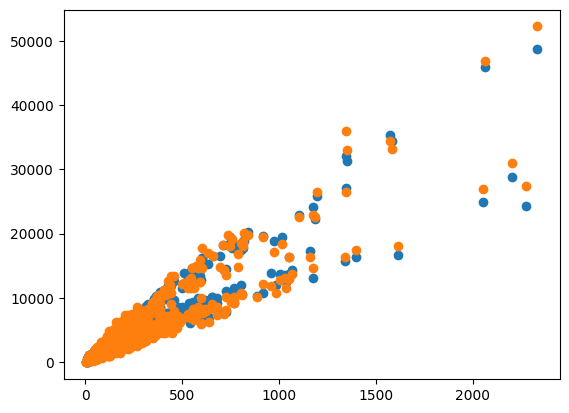

In [82]:
plt.scatter(rm,FF_new_pred)
plt.scatter(rm,FF_new)

In [83]:
##### r2_score per layer

for i in range(0,len(loaded_models[0].layers),2):
    print(r2_score(LUT[:,int(i/2)],LUT_pred[:,int(i/2)]))


0.9732154919832425
0.9913829414353346
0.9910000802063893


In [84]:
######  measure LUTs only for the DSP implementation
LUT_new = []
LUT_new_pred = []
rm = []
for i in range(layer_num):
      if selector[i]==1:
        LUT_new.append(LUT[i])
        LUT_new_pred.append(LUT_pred[i])
        rm.append(real_muls[:,i])
LUT_new = np.array(LUT_new)
LUT_new_pred = np.array(LUT_new_pred)

for i in range(0,len(loaded_models[0].layers),2):
    print(r2_score(LUT_new[:,int(i/2)],LUT_new_pred[:,int(i/2)]))


0.9545802772395003
0.9888046172397521
0.9880821263815913


In [85]:
math.sqrt(mse(FF_new,FF_new_pred))

885.2088921268369

In [88]:
#### Write results to txt file

#res_name = "./sim_results/results/test_" + str(id_num) + "/results.txt"
res_name = "./test.txt"
utils.utils.clear_file(res_name)
utils.utils.compare(LUT,FF,LUT_pred,FF_pred,res_name,RF)

rm: cannot remove './test.txt': No such file or directory


In [434]:
impl = []
impl_pred = []
dif = []
dif_FF = []
for l,value in enumerate(selector):
    if value == 1  :
        print(str(l) + ": " + str(LUT[l]) + "    " + str(LUT_pred[l]) + "     " + str(100*abs(LUT[l] - LUT_pred[l])/LUT[l]) + "     " + str(real_muls[0][l]))
        impl.append(LUT[l])
        impl_pred.append(LUT_pred[l])
        dif.append(100*abs(LUT_new[l] - LUT_new_pred[l])/LUT_new[l])
        dif_FF.append(100*abs(FF_new[l] - FF_new_pred[l])/FF_new[l])
        
        

0: [10134  5965  1336]    [10156  5271  1353]     [ 0.21709098 11.63453479  1.27245509]     569
1: [4154 1131 1036]    [4132 1147 1094]     [0.52961001 1.41467728 5.5984556 ]     219
2: [ 6631 12666  4873]    [ 6647 11684  4243]     [ 0.24129091  7.75303963 12.92838087]     378
3: [2807 7310 7371]    [2850 6533 6434]     [ 1.53188457 10.62927497 12.71197938]     153
4: [ 5943 39252 28153]    [ 5932 36087 25498]     [0.1850917 8.0632834 9.4306113]     346
5: [15420 27095 13159]    [15537 24589 11815]     [ 0.75875486  9.24893892 10.21354206]     912
6: [ 6136 11452  8598]    [ 6161 10373  7772]     [0.40743155 9.42193503 9.60688532]     341
7: [ 8549 24425  5308]    [ 8479 22359  4631]     [ 0.81880922  8.45854657 12.75433308]     476
8: [5160 4070 2170]    [5005 3750 2164]     [3.00387597 7.86240786 0.2764977 ]     280
9: [4323 3793 2210]    [4570 3503 2214]     [5.7136248  7.64566306 0.18099548]     248
10: [1581  742  971]    [1944  862 1006]     [22.9601518  16.17250674  3.60453141]

In [89]:
###### measure the mean and median LUT error. Somestimes the simulations bugs and gives high errors,so we filter them out
dif_LUT = np.array(dif)
LUT_error = []
for i in dif:
    for j in i:
        if j < 50:
            LUT_error.append(j)
LUT_error = np.array(LUT_error)
#dif.mean()

LUT_error.mean()

11.590897461832792

In [90]:
median(LUT_error)

9.32630064732678

In [91]:
dif_FF = np.array(dif_FF)
FF_error = []
for i in dif_FF:
    for j in i:
        if j < 50:
            FF_error.append(j)
FF_error = np.array(FF_error)
#dif.mean()

FF_error.mean()

20.829858217421073

In [92]:
median(FF_error)

18.66980885048442

## Experiment with trained models and take measurments

In [5]:
from tensorflow.keras.models import load_model
from qkeras.utils import _add_supported_quantized_objects
import qkeras.qtools.qtools_util
import qkeras.estimate
loaded_models = []
id_num = 4
layer_num = 20
dirname = "../jet_tagging/models/models_2/prec_8/model_"
filename = "./sim_results/results/test_" + str(id_num) + "/model_"
for model_no in range(layer_num):
    co = {}
    _add_supported_quantized_objects(co)
    loaded_models.append(load_model(dirname + str(model_no) + '/KERAS_check_best_model.h5', custom_objects=co))
#model = 


In [91]:
pr = 2
dirname = "../jet_tagging/models/models_1/prec_" + str(pr) + "/model_"
precision = np.zeros(20).astype(int) + pr
RF = np.zeros(20).astype(int) + 100
selector = np.ones(20)

In [94]:
FF = []
LUT = []
DSP = []
FF_pred = []
LUT_pred = []
DSP_pred = []
#RF = np.ones(layer_num).astype("int")
for i in range(layer_num):
    ff,lut = utils.utils.get_resources(dirname + str(i),reuse=RF[i],model = loaded_models[i])
    DSP.append(utils.utils.get_DSP())
    FF.append(ff)
    LUT.append(lut)
    dsp_pred,lut_pred,ff_pred = utils.utils.gather(loaded_models[i],precision[i],int(RF[i]),selector[i],16,6,False)
    FF_pred.append(ff_pred)
    LUT_pred.append(lut_pred)
    DSP_pred.append(dsp_pred)
FF_pred = np.array(FF_pred)
LUT_pred = np.array(LUT_pred)
DSP_pred = np.array(DSP_pred)
FF = np.array(FF)
LUT = np.array(LUT)
DSP = np.array(DSP)

... quantizing model
-----------------------------------------------------------
zero LUT elements: 68
Total LUTs: 16566
Zeros: 286
Total multiplication LUTs: 7063
Total accumulator LUTs: 13216
Total DSPs: 10
Total layer additions: 869
Total bias additions: 75
Number of repeated weights: 238
Total Flip Flops: 10037
Real multiplications: 946
... quantizing model
-----------------------------------------------------------
zero LUT elements: 186
Total LUTs: 21289
Zeros: 1168
Total multiplication LUTs: 8693
Total accumulator LUTs: 17388
Total DSPs: 15
Total layer additions: 1416
Total bias additions: 33
Number of repeated weights: 336
Total Flip Flops: 15065
Real multiplications: 1450
... quantizing model
-----------------------------------------------------------
zero LUT elements: 47
Total LUTs: 8960
Zeros: 224
Total multiplication LUTs: 4648
Total accumulator LUTs: 6276
Total DSPs: 6
Total layer additions: 502
Total bias additions: 21
Number of repeated weights: 44
Total Flip Flops: 550

-----------------------------------------------------------
zero LUT elements: 178
Total LUTs: 21650
Zeros: 1044
Total multiplication LUTs: 9124
Total accumulator LUTs: 17400
Total DSPs: 15
Total layer additions: 1420
Total bias additions: 30
Number of repeated weights: 318
Total Flip Flops: 15084
Real multiplications: 1452
... quantizing model
-----------------------------------------------------------
zero LUT elements: 33
Total LUTs: 6237
Zeros: 142
Total multiplication LUTs: 3502
Total accumulator LUTs: 4070
Total DSPs: 4
Total layer additions: 354
Total bias additions: 16
Number of repeated weights: 22
Total Flip Flops: 3804
Real multiplications: 370
... quantizing model
-----------------------------------------------------------
zero LUT elements: 0
Total LUTs: 1397
Zeros: 16
Total multiplication LUTs: 840
Total accumulator LUTs: 768
Total DSPs: 1
Total layer additions: 59
Total bias additions: 5
Number of repeated weights: 4
Total Flip Flops: 357
Real multiplications: 64
... qua

-----------------------------------------------------------
zero LUT elements: 230
Total LUTs: 28346
Zeros: 2534
Total multiplication LUTs: 11591
Total accumulator LUTs: 23148
Total DSPs: 20
Total layer additions: 1884
Total bias additions: 45
Number of repeated weights: 446
Total Flip Flops: 19223
Real multiplications: 1931
... quantizing model
-----------------------------------------------------------
zero LUT elements: 77
Total LUTs: 11612
Zeros: 519
Total multiplication LUTs: 5776
Total accumulator LUTs: 8412
Total DSPs: 8
Total layer additions: 677
Total bias additions: 24
Number of repeated weights: 70
Total Flip Flops: 7455
Real multiplications: 703
... quantizing model
-----------------------------------------------------------
zero LUT elements: 1
Total LUTs: 2433
Zeros: 26
Total multiplication LUTs: 1638
Total accumulator LUTs: 1248
Total DSPs: 2
Total layer additions: 99
Total bias additions: 5
Number of repeated weights: 0
Total Flip Flops: 812
Real multiplications: 104
..

-----------------------------------------------------------
zero LUT elements: 2
Total LUTs: 2032
Zeros: 23
Total multiplication LUTs: 1287
Total accumulator LUTs: 1104
Total DSPs: 1
Total layer additions: 87
Total bias additions: 5
Number of repeated weights: 1
Total Flip Flops: 675
Real multiplications: 92


In [95]:
import estimator as est
import utils
reload(est)
reload(utils)

<module 'utils' from '/home/dmitsas/Downloads/notebooks/misc/utils.py'>

Get r_2 score for each model separately

In [96]:
r2 = 0
for i in range(20):
    r2 += r2_score(LUT[i],LUT_pred[i])
    print(r2_score(LUT[i],LUT_pred[i]))
r2/20

0.9717464376472518
0.9717000123047249
0.9630207040245853
0.9735575704014003
0.9739684886705944
0.9710545579435682
0.9761993988956944
0.9819709862613883
0.9685294903097099
0.9744739386178719
0.978184914429821
0.9714841739748632
0.9741240489418125
0.9725646006010091
0.9754249148547934
0.9741177772945635
0.9681831565001696
0.9754641473432325
0.9730862707743921
0.9716802569068789


0.9730267923349162

In [97]:
r2 = 0
for i in range(20):
    r2 += r2_score(FF[i],FF_pred[i])
    print(r2_score(FF[i],FF_pred[i]))
r2/20

0.8805223180564341
0.8529885559257205
0.8850045580654555
0.9078345722011087
0.9149152808239989
0.8871016778647985
0.926960837814554
0.9408844982506506
0.8952702952671258
0.9342534887209768
0.8999318985076272
0.8915541089446242
0.9135648252445487
0.9250854449824106
0.9209362781496505
0.8970698011851408
0.8881206937879872
0.9004385529693709
0.888538020011953
0.901693717403045


0.9026334712088591

In [98]:
real_muls = reg_ff.regression.get_muls(loaded_models,layer_num)

real_muls = np.array(real_muls)
real_muls.shape

(4, 20)

In [99]:
impl = []
impl_pred = []
dif = []
dif_FF = []
for l,value in enumerate(selector):
    if value == 1  :
        print(str(l) + ": " + str(LUT[l]) + "    " + str(LUT_pred[l]) + "     " + str(100*abs(LUT[l] - LUT_pred[l])/LUT[l]) + "     " + str(real_muls[0][l]))
        impl.append(LUT[l])
        impl_pred.append(LUT_pred[l])
        dif.append(100*abs(LUT[l] - LUT_pred[l])/LUT[l])
        dif_FF.append(100*abs(FF[l] - FF_pred[l])/FF[l])
        
        

0: [14679 20144  8329  1914]    [16566 21289  8960  1943]     [12.85509912  5.68407466  7.57593949  1.51515152]     946
1: [13247 24869 12887  2419]    [14935 26687 13871  2561]     [12.74250774  7.310306    7.63560177  5.8701943 ]     834
2: [14310 15780  6909  2264]    [16061 16877  7368  2204]     [12.23619846  6.95183777  6.64350847  2.65017668]     965
3: [16167 26667 10911  2067]    [18296 28515 11567  2146]     [13.16880064  6.92991338  6.01228118  3.8219642 ]     1051
4: [17132 28853 12439  2177]    [19092 31061 13347  2323]     [11.44057903  7.65258379  7.29962216  6.7064768 ]     1109
5: [14339 25940 11776  2029]    [16125 28111 12477  2020]     [12.45554083  8.3693138   5.95278533  0.44356826]     922
6: [14951 20480  6256  1494]    [16904 21650  6237  1397]     [13.06267139  5.71289062  0.30370844  6.49263722]     955
7: [15610 24038  8035  1755]    [17509 25092  8575  1682]     [12.16527867  4.38472419  6.72059739  4.15954416]     1004
8: [14770 23714 12593  2475]    [1656

In [33]:
dif_LUT = np.array(dif)
LUT_error = []
for i in dif:
    for j in i:
        if j < 200:
            LUT_error.append(j)
LUT_error = np.array(LUT_error)
#dif.mean()

LUT_error.mean()

8.52830916594579

In [34]:
dif_FF = np.array(dif_FF)
FF_error = []
for i in dif_FF:
    for j in i:
        if j < 70:
            FF_error.append(j)
FF_error = np.array(FF_error)
#dif.mean()

FF_error.mean()

12.409094927109457

In [39]:
median(FF_error)

7.853343240406253